This is a notebook which I presented internally at my lab, to showcase some energy system data analysis. It was inspired by the OPSD tutorial (https://data.open-power-system-data.org/time_series/2020-10-06).

# Goal
- Combine data on power generation with ecoinvent data to calculate and visualize grid emissions
- Analyze temporal variability
- Explorative analysis of the data
- Try out different types of visualizations

# Final Results

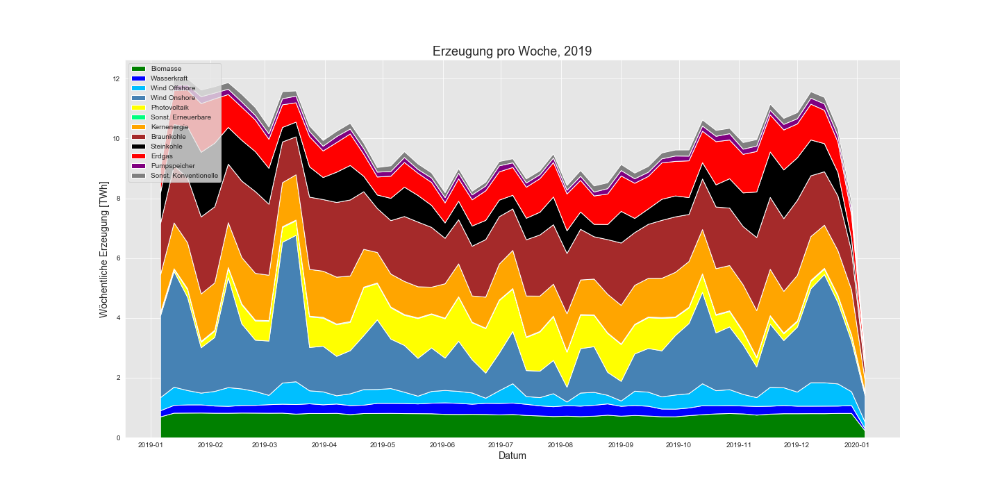

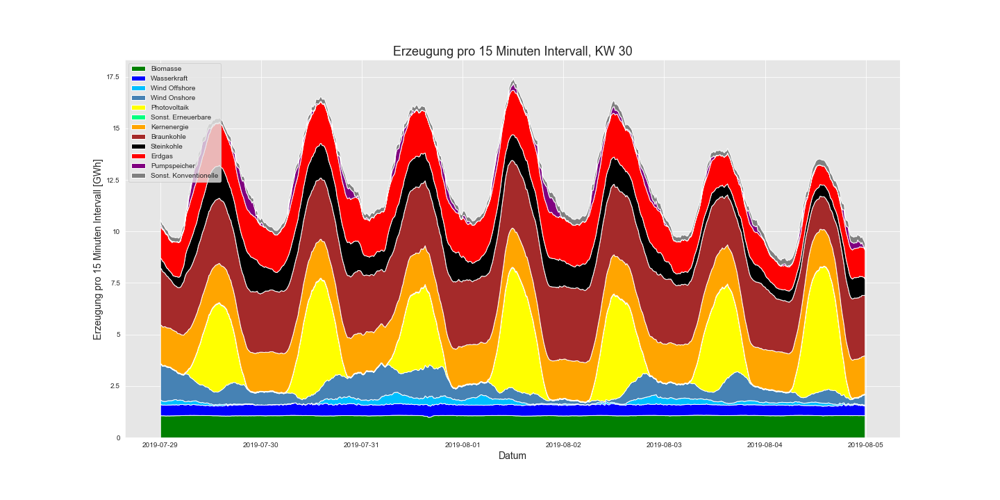

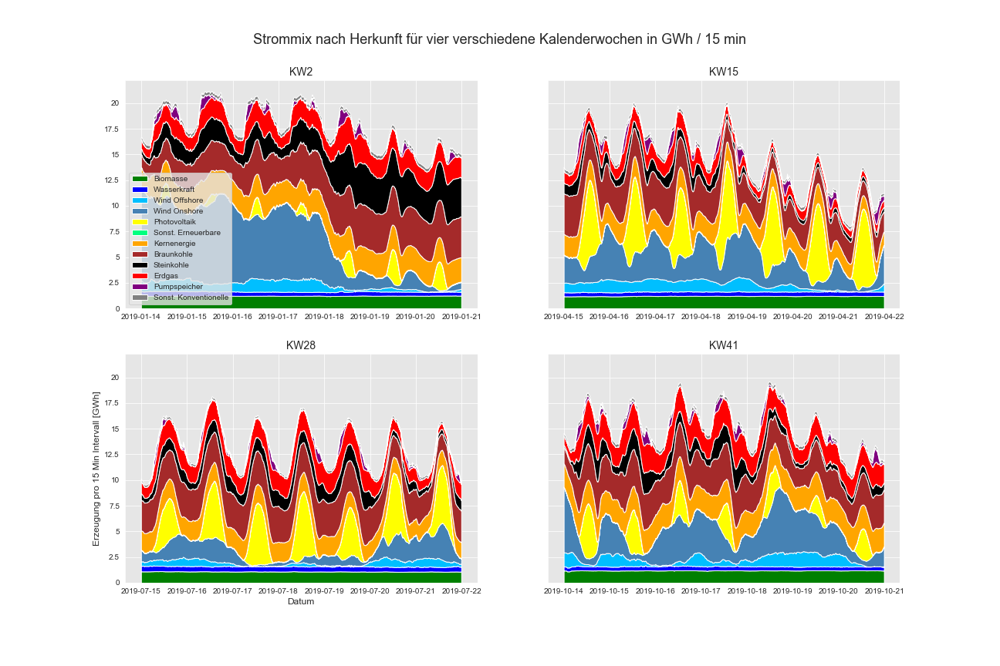

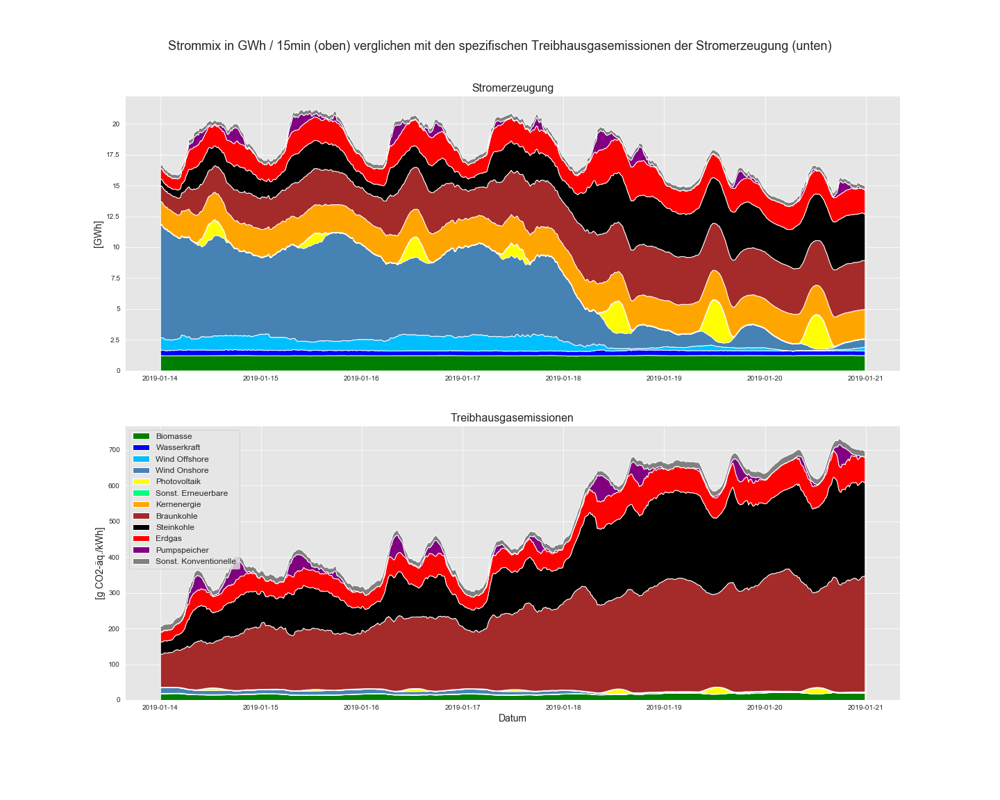

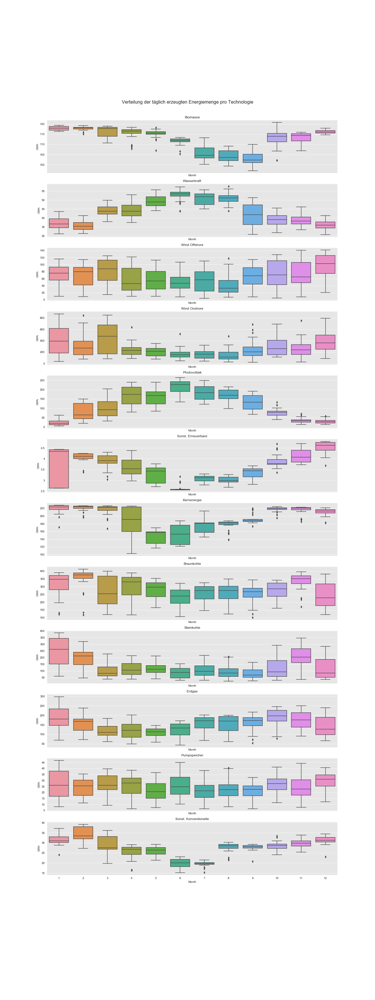

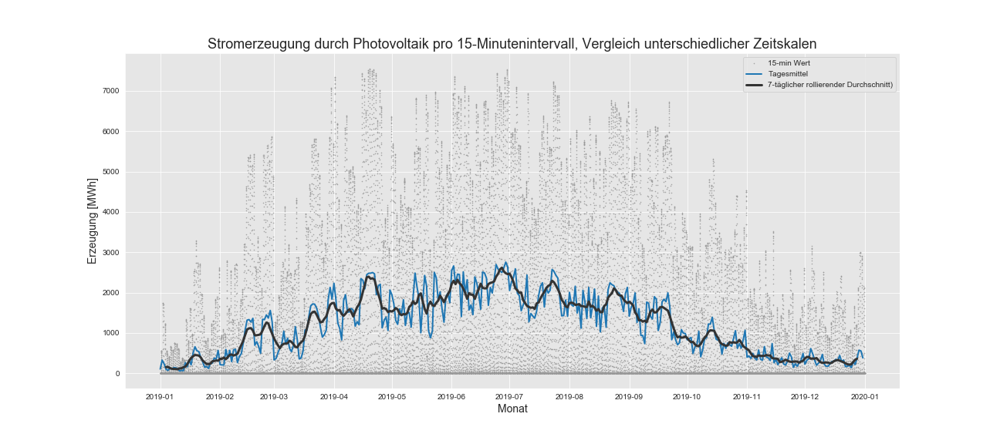

# Importing libraries and packages

In [1]:
# importing libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.dates as mdates

# Tutorial - Working with data from OPSD
This is where I got a lot of information from that I am using in this notebook:
https://data.open-power-system-data.org/time_series/2020-10-06

I first did this tutorial, then switched over to work with SMARD data (https://www.smard.de/home/downloadcenter/) - data provided by the German government on the German energy system and market.

You can skip directly to the next section ("LCA stuff").

## File import and converting the timestamp to datetime

In [2]:
# importing the CSV file
ws = pd.read_csv('time_series_15min_singleindex.csv')
ws

,utc_timestamp,cet_cest_timestamp,AT_load_actual_entsoe_transparency,AT_load_forecast_entsoe_transparency,AT_price_day_ahead,AT_solar_generation_actual,AT_wind_onshore_generation_actual,BE_load_actual_entsoe_transparency,BE_load_forecast_entsoe_transparency,DE_load_actual_entsoe_transparency,...,HU_solar_generation_actual,HU_wind_onshore_generation_actual,LU_load_actual_entsoe_transparency,LU_load_forecast_entsoe_transparency,NL_load_actual_entsoe_transparency,NL_load_forecast_entsoe_transparency,NL_solar_generation_actual,NL_wind_generation_actual,NL_wind_offshore_generation_actual,NL_wind_onshore_generation_actual
0,2014-12-31T23:00:00Z,2015-01-01T00:00:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2014-12-31T23:15:00Z,2015-01-01T00:15:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2014-12-31T23:30:00Z,2015-01-01T00:30:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2014-12-31T23:45:00Z,2015-01-01T00:45:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2015-01-01T00:00:00Z,2015-01-01T01:00:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
201599,2020-09-30T22:45:00Z,2020-10-01T00:45:00+0200,5482.4,5284.0,NaN,NaN,1740.0,7916.55,8105.94,46229.48,...,NaN,157.28,384.36,382.0,12324.95,12094.02,NaN,908.51,640.25,268.26
201600,2020-09-30T23:00:00Z,2020-10-01T01:00:00+0200,5464.0,5272.0,NaN,NaN,1712.0,7912.79,8025.29,45792.82,...,NaN,153.32,382.41,371.0,12218.53,11950.22,NaN,925.15,669.88,255.27
201601,2020-09-30T23:15:00Z,2020-10-01T01:15:00+0200,5390.4,5200.0,NaN,NaN,1672.0,7818.72,7931.56,45471.18,...,NaN,147.56,378.74,368.0,12076.92,11832.26,NaN,975.34,719.18,256.16
201602,2020-09-30T23:30:00Z,2020-10-01T01:30:00+0200,5329.2,5140.0,NaN,NaN,1600.0,7780.18,7872.25,45119.89,...,NaN,137.19,375.86,369.0,11929.69,11717.22,NaN,976.64,721.50,255.14


In [71]:
# converting the UTC timestamp to datetime format
ws['utc_timestamp'] = pd.to_datetime(ws['utc_timestamp'])
ws.head(5)

,utc_timestamp,cet_cest_timestamp,AT_load_actual_entsoe_transparency,AT_load_forecast_entsoe_transparency,AT_price_day_ahead,AT_solar_generation_actual,AT_wind_onshore_generation_actual,BE_load_actual_entsoe_transparency,BE_load_forecast_entsoe_transparency,DE_load_actual_entsoe_transparency,...,HU_solar_generation_actual,HU_wind_onshore_generation_actual,LU_load_actual_entsoe_transparency,LU_load_forecast_entsoe_transparency,NL_load_actual_entsoe_transparency,NL_load_forecast_entsoe_transparency,NL_solar_generation_actual,NL_wind_generation_actual,NL_wind_offshore_generation_actual,NL_wind_onshore_generation_actual
0,2014-12-31 23:00:00+00:00,2015-01-01T00:00:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2014-12-31 23:15:00+00:00,2015-01-01T00:15:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2014-12-31 23:30:00+00:00,2015-01-01T00:30:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2014-12-31 23:45:00+00:00,2015-01-01T00:45:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2015-01-01 00:00:00+00:00,2015-01-01T01:00:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [72]:
# cheacking that it is the right data format
ws.dtypes

utc_timestamp                           datetime64[ns, UTC]
cet_cest_timestamp                                   object
AT_load_actual_entsoe_transparency                  float64
AT_load_forecast_entsoe_transparency                float64
AT_price_day_ahead                                  float64
                                               ...         
NL_load_forecast_entsoe_transparency                float64
NL_solar_generation_actual                          float64
NL_wind_generation_actual                           float64
NL_wind_offshore_generation_actual                  float64
NL_wind_onshore_generation_actual                   float64
Length: 61, dtype: object

In [73]:
# set index to UTC time
ws = ws.set_index('utc_timestamp')
ws.head(3)

,cet_cest_timestamp,AT_load_actual_entsoe_transparency,AT_load_forecast_entsoe_transparency,AT_price_day_ahead,AT_solar_generation_actual,AT_wind_onshore_generation_actual,BE_load_actual_entsoe_transparency,BE_load_forecast_entsoe_transparency,DE_load_actual_entsoe_transparency,DE_load_forecast_entsoe_transparency,...,HU_solar_generation_actual,HU_wind_onshore_generation_actual,LU_load_actual_entsoe_transparency,LU_load_forecast_entsoe_transparency,NL_load_actual_entsoe_transparency,NL_load_forecast_entsoe_transparency,NL_solar_generation_actual,NL_wind_generation_actual,NL_wind_offshore_generation_actual,NL_wind_onshore_generation_actual
utc_timestamp,,,,,,,,,,,,,,,,,,,,,
2014-12-31 23:00:00+00:00,2015-01-01T00:00:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2014-12-31 23:15:00+00:00,2015-01-01T00:15:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2014-12-31 23:30:00+00:00,2015-01-01T00:30:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Renaming some columns, selecting subsets of the df for Germany and specific years (e.g. 2019), adding columns for year, month, weekday names

In [75]:
# make column names sweet and short
ws = ws.rename(columns={
    'DE_load_actual_entsoe_transparency': 'load',
    'DE_load_forecast_entsoe_transparency': 'load_fcast',
    'DE_solar_generation_actual': 'solar',
    'DE_wind_onshore_generation_actual': 'wind'
})
ws

,cet_cest_timestamp,AT_load_actual_entsoe_transparency,AT_load_forecast_entsoe_transparency,AT_price_day_ahead,AT_solar_generation_actual,AT_wind_onshore_generation_actual,BE_load_actual_entsoe_transparency,BE_load_forecast_entsoe_transparency,load,load_fcast,...,HU_solar_generation_actual,HU_wind_onshore_generation_actual,LU_load_actual_entsoe_transparency,LU_load_forecast_entsoe_transparency,NL_load_actual_entsoe_transparency,NL_load_forecast_entsoe_transparency,NL_solar_generation_actual,NL_wind_generation_actual,NL_wind_offshore_generation_actual,NL_wind_onshore_generation_actual
utc_timestamp,,,,,,,,,,,,,,,,,,,,,
2014-12-31 23:00:00+00:00,2015-01-01T00:00:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2014-12-31 23:15:00+00:00,2015-01-01T00:15:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2014-12-31 23:30:00+00:00,2015-01-01T00:30:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2014-12-31 23:45:00+00:00,2015-01-01T00:45:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-01-01 00:00:00+00:00,2015-01-01T01:00:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-09-30 22:45:00+00:00,2020-10-01T00:45:00+0200,5482.4,5284.0,NaN,NaN,1740.0,7916.55,8105.94,46229.48,45971.68,...,NaN,157.28,384.36,382.0,12324.95,12094.02,NaN,908.51,640.25,268.26
2020-09-30 23:00:00+00:00,2020-10-01T01:00:00+0200,5464.0,5272.0,NaN,NaN,1712.0,7912.79,8025.29,45792.82,45303.45,...,NaN,153.32,382.41,371.0,12218.53,11950.22,NaN,925.15,669.88,255.27
2020-09-30 23:15:00+00:00,2020-10-01T01:15:00+0200,5390.4,5200.0,NaN,NaN,1672.0,7818.72,7931.56,45471.18,44987.77,...,NaN,147.56,378.74,368.0,12076.92,11832.26,NaN,975.34,719.18,256.16


In [77]:
# take only data for Germany
wsd = ws[['load','load_fcast','solar','wind']]
wsd.tail(5)

,load,load_fcast,solar,wind
utc_timestamp,,,,
2020-09-30 22:45:00+00:00,46229.48,45971.68,0.05,7383.60
2020-09-30 23:00:00+00:00,45792.82,45303.45,0.02,7327.59
2020-09-30 23:15:00+00:00,45471.18,44987.77,NaN,7437.13
2020-09-30 23:30:00+00:00,45119.89,44668.15,NaN,7485.31
2020-09-30 23:45:00+00:00,NaN,NaN,NaN,NaN


In [78]:
# Add columns with year, month, and weekday name
wsd['Year'] = wsd.index.year
wsd['Month'] = wsd.index.month
wsd['Weekday Name'] = wsd.index.day_name()
# Display a random sampling of 5 rows
wsd.sample(5, random_state=0)

C:\Users\mschaefer\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\mschaefer\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\mschaefer\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be se

,load,load_fcast,solar,wind,Year,Month,Weekday Name
utc_timestamp,,,,,,,
2019-05-26 17:15:00+00:00,48650.16,48055.69,3297.93,15495.77,2019,5,Sunday
2016-05-04 23:45:00+00:00,41890.35,38306.14,0.00,4783.16,2016,5,Wednesday
2015-01-11 21:45:00+00:00,50696.04,49967.15,0.00,24757.99,2015,1,Sunday
2017-07-02 19:45:00+00:00,46793.62,48143.63,1.51,9604.62,2017,7,Sunday
2019-12-02 15:15:00+00:00,67586.45,67150.48,14.61,13773.30,2019,12,Monday


In [79]:
wsd.loc['2020-08-10-15'] # Accessing a single hourly subset

,load,load_fcast,solar,wind,Year,Month,Weekday Name
utc_timestamp,,,,,,,
2020-08-10 15:00:00+00:00,61314.24,57255.33,14593.63,5790.39,2020,8,Monday
2020-08-10 15:15:00+00:00,61039.18,57237.82,13168.26,5961.69,2020,8,Monday
2020-08-10 15:30:00+00:00,60679.48,57272.36,11696.60,6442.97,2020,8,Monday
2020-08-10 15:45:00+00:00,60889.63,57279.44,10227.11,6778.33,2020,8,Monday


In [80]:
wsd2019 = wsd.loc['2019-01-01':'2019-12-31'] # saving the year 2019 as a separate dataframe
wsd2019

,load,load_fcast,solar,wind,Year,Month,Weekday Name
utc_timestamp,,,,,,,
2019-01-01 00:00:00+00:00,42254.95,41978.07,0.0,21190.29,2019,1,Tuesday
2019-01-01 00:15:00+00:00,41718.84,41480.75,0.0,21904.45,2019,1,Tuesday
2019-01-01 00:30:00+00:00,41349.07,40955.63,0.0,22466.59,2019,1,Tuesday
2019-01-01 00:45:00+00:00,40924.25,40687.54,0.0,22584.62,2019,1,Tuesday
2019-01-01 01:00:00+00:00,40984.90,40384.15,0.0,22677.76,2019,1,Tuesday
...,...,...,...,...,...,...,...
2019-12-31 22:45:00+00:00,43445.02,46965.60,0.0,5788.61,2019,12,Tuesday
2019-12-31 23:00:00+00:00,42783.12,46215.06,0.0,5908.85,2019,12,Tuesday
2019-12-31 23:15:00+00:00,42373.87,45703.29,0.0,5899.04,2019,12,Tuesday


## Visualizations

In [81]:
# Use seaborn style defaults and set the default figure size
sns.set(rc={'figure.figsize':(25, 10)})

### line plot for 2019 load, 15min intervals

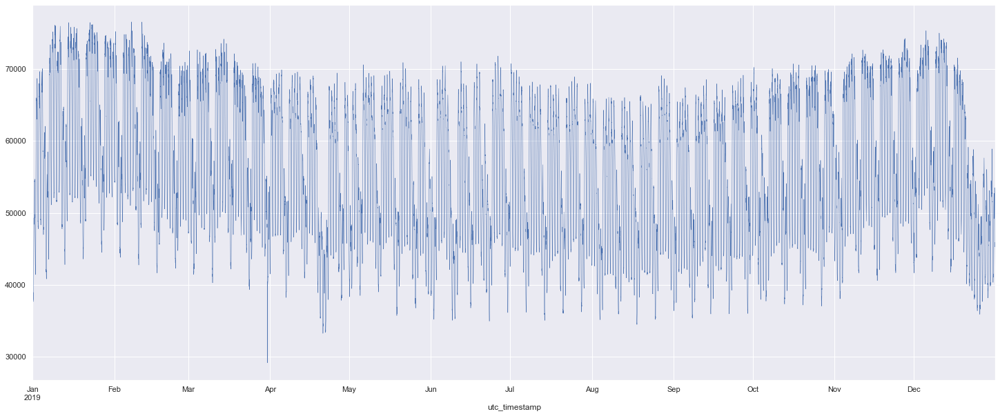

In [82]:
wsd2019['load'].plot(linewidth=0.5)

### marker plot for 2019 solar, wind and load, 15min intervals

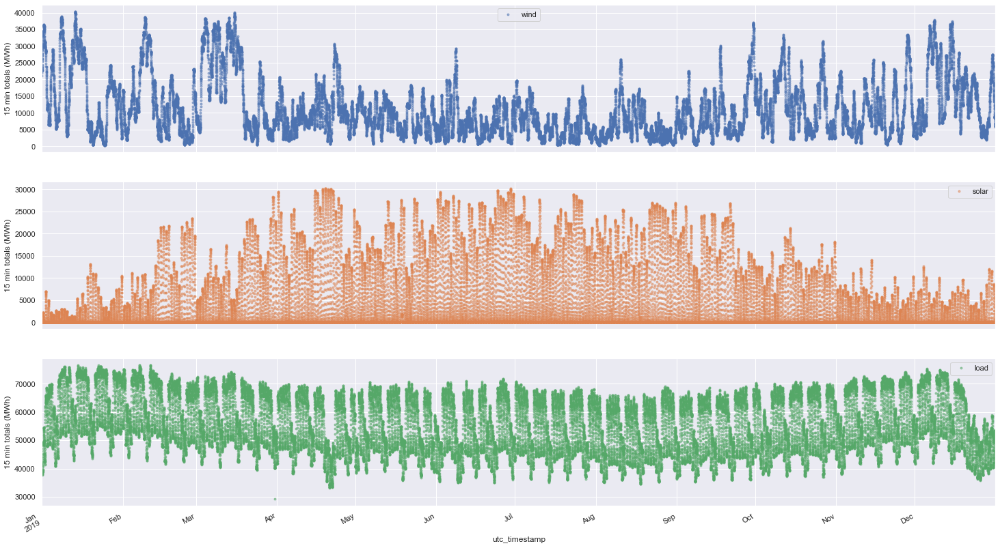

In [83]:
cols_plot = ['wind', 'solar', 'load']
axes = wsd2019[cols_plot].plot(marker='.', alpha=0.5, linestyle='None', figsize=(25, 15), subplots=True)
for ax in axes:
    ax.set_ylabel('15 min totals (MWh)')

### again line plot, load, 15min, for 2019

Text(0, 0.5, '15 min load (MWh)')

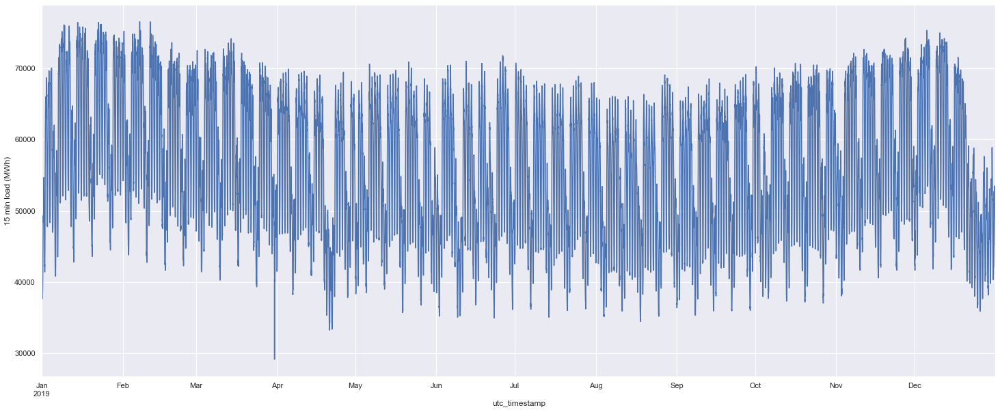

In [84]:
ax = wsd2019.loc['2019','load'].plot()
ax.set_ylabel('15 min load (MWh)')

### subsection of previous plot, only January and February

Text(0, 0.5, '15 min load (MWh)')

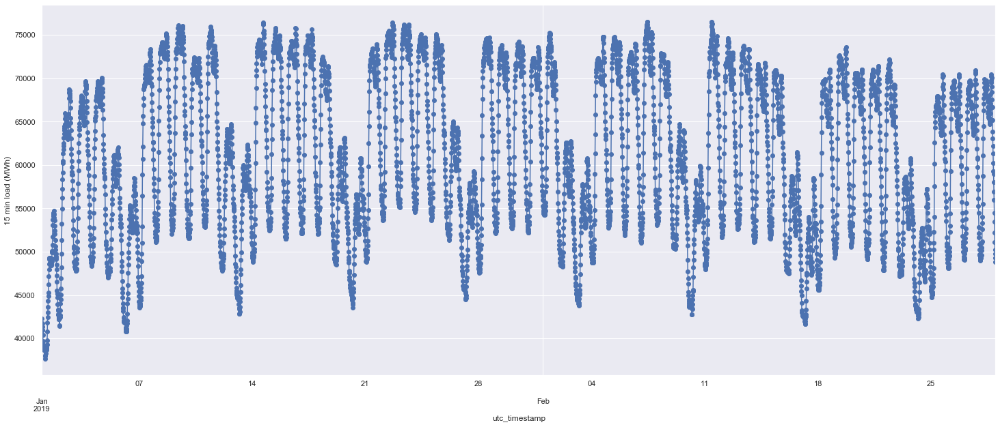

In [85]:
ax = wsd2019.loc['2019-01':'2019-02', 'load'].plot(marker='o', linestyle='-')
ax.set_ylabel('15 min load (MWh)')

### set x-axis ticks to they correspond to week intervals

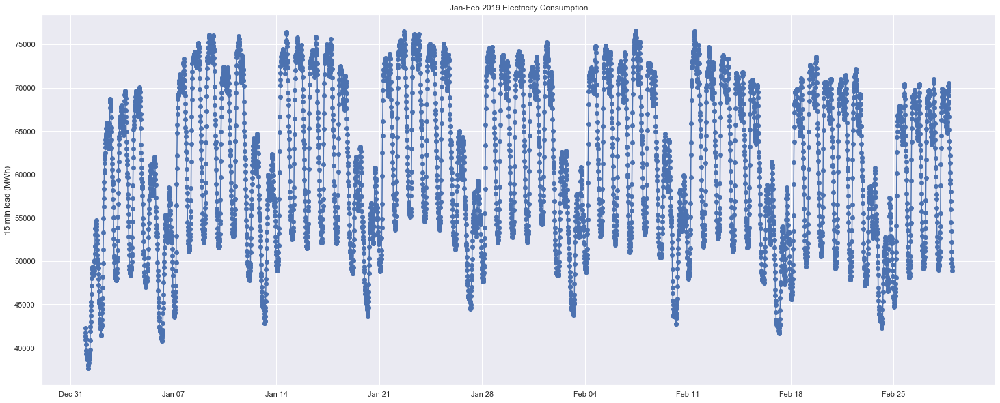

In [51]:
fig, ax = plt.subplots()
ax.plot(wsd2019.loc['2019-01':'2019-02', 'load'], marker='o', linestyle='-')
ax.set_ylabel('15 min load (MWh)')
ax.set_title('Jan-Feb 2019 Electricity Consumption')
# Set x-axis major ticks to weekly interval, on Mondays
ax.xaxis.set_major_locator(mdates.WeekdayLocator(byweekday=mdates.MONDAY))
# Format x-tick labels as 3-letter month name and day number
ax.xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))

### boxplots to show distributions per month for load, solar, wind

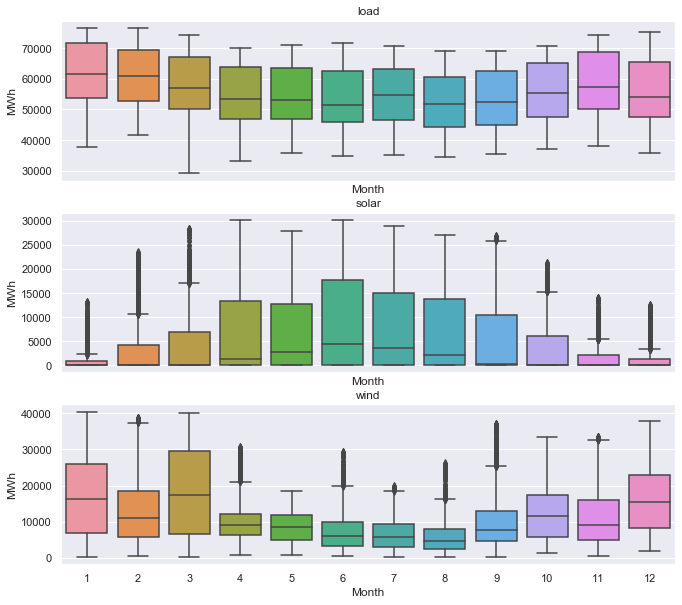

In [52]:
# box plots for montly distributions
fig, axes = plt.subplots(3, 1, figsize=(11, 10), sharex=True)
for name, ax in zip(['load', 'solar', 'wind'], axes):
    sns.boxplot(data=wsd2019, x='Month', y=name, ax=ax)
    ax.set_ylabel('MWh')
    ax.set_title(name)
# Remove the automatic x-axis label from all but the bottom subplot
if ax != axes[-1]:
    ax.set_xlabel('')

### boxplots to show distribution per weekday

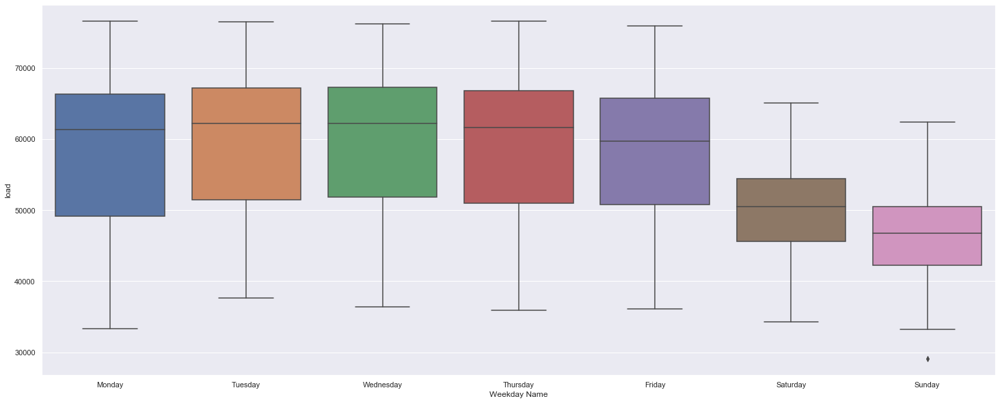

In [53]:
# boxplots for weekdays
order = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
sns.boxplot(data=wsd2019, x='Weekday Name', y='load', order=order)

### resampling to reduce number of data points - averaging

#### daily - full dataset

In [54]:
# Specify the data columns we want to include (i.e. exclude Year, Month, Weekday Name)
data_columns = ['load', 'solar', 'wind']
# Resample to weekly frequency, aggregating with mean
wsd_daily_mean = wsd2019[data_columns].resample('D').mean()
wsd_daily_mean.head(3)

utc_timestamp
2019-01-01 00:00:00+00:00    54683.35
2019-01-02 00:00:00+00:00    68681.23
2019-01-03 00:00:00+00:00    69646.92
Freq: D, Name: load, dtype: float64

#### daily - 2019 data

In [59]:
# Specify the data columns we want to include (i.e. exclude Year, Month, Weekday Name)
data_columns = ['load', 'load_fcast', 'solar', 'wind']
# Resample to weekly frequency, aggregating with mean
wsd2019_daily_mean = wsd2019[data_columns].resample('D').mean()
wsd2019_daily_mean.head(3)

,load,load_fcast,solar,wind
utc_timestamp,,,,
2019-01-01 00:00:00+00:00,45700.686146,47314.919167,420.454792,31742.719688
2019-01-02 00:00:00+00:00,57815.007604,55446.519687,1296.570521,24537.942292
2019-01-03 00:00:00+00:00,60431.154063,57177.293125,938.672083,9429.911979


#### weekly - 2019 data

In [56]:
# Specify the data columns we want to include (i.e. exclude Year, Month, Weekday Name)
data_columns = ['load', 'load_fcast', 'solar', 'wind']
# Resample to weekly frequency, aggregating with mean
wsd2019_weekly_mean = wsd2019[data_columns].resample('W').mean()
wsd2019_weekly_mean.head(3)

,load,load_fcast,solar,wind
utc_timestamp,,,,
2019-01-06 00:00:00+00:00,54800.584618,52661.130747,638.662170,18929.040000
2019-01-13 00:00:00+00:00,62372.206131,58728.574658,393.990223,23220.499568
2019-01-20 00:00:00+00:00,62423.486354,61476.601443,1521.517113,18343.579449


In [41]:
# compare size of dataframes, verification of resampling process
print(wsd2019.shape[0])
print(wsd2019_daily_mean.shape[0])
print(wsd2019_weekly_mean.shape[0])

NameError: name 'wsd2019' is not defined

### line plot containing both daily and weekly mean values for 2019 load

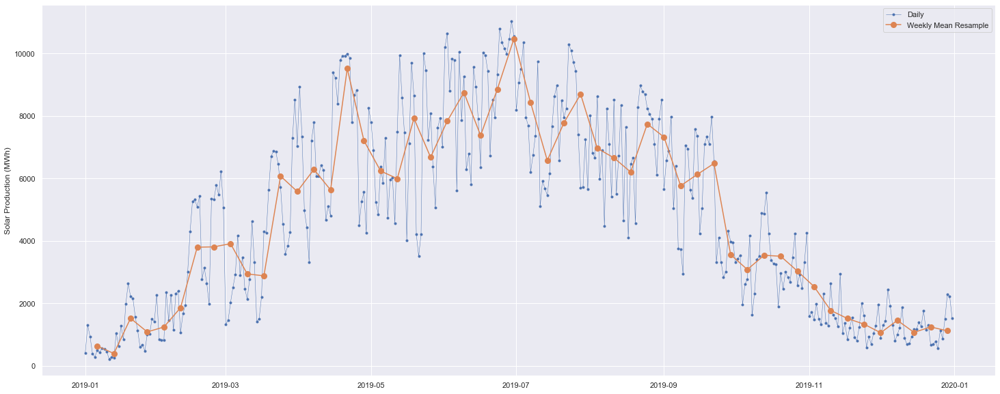

In [64]:
# Start and end of the date range to extract
start, end = '2019-01', '2019-12'
# Plot daily and weekly resampled time series together
fig, ax = plt.subplots()
#ax.plot(wsd2019.loc[start:end, 'solar'],
#marker='.', linestyle='-', linewidth=0.5, label='15 min')
ax.plot(wsd2019_daily_mean.loc[start:end, 'solar'],
marker='.', linestyle='-', linewidth=0.5, label='Daily')
ax.plot(wsd2019_weekly_mean.loc[start:end, 'solar'],
marker='o', markersize=8, linestyle='-', label='Weekly Mean Resample')
ax.set_ylabel('Solar Production (MWh)')
ax.legend();

#### resampling - monthly, 2019 dataset

In [65]:
# Compute the monthly sums, setting the value to NaN for any month which has
# fewer than 28 days of data
wsd2019_monthly = wsd2019[data_columns].resample('M').sum(min_count=28)
wsd2019_monthly.head(3)

,load,load_fcast,solar,wind
utc_timestamp,,,,
2019-01-31 00:00:00+00:00,1.833131e+08,1.768226e+08,2980082.18,49923078.08
2019-02-28 00:00:00+00:00,1.628961e+08,1.606827e+08,8765070.75,35357717.78
2019-03-31 00:00:00+00:00,1.726031e+08,1.680222e+08,12207957.69,54793406.26


#### resampling - monthly, full dataset

In [86]:
# repeat for df containing multiple years
wsd_monthly = wsd[data_columns].resample('M').sum(min_count=28)
wsd_monthly.head(3)

,load,load_fcast,solar,wind
utc_timestamp,,,,
2014-12-31 00:00:00+00:00,NaN,NaN,NaN,NaN
2015-01-31 00:00:00+00:00,1.688530e+08,1.662776e+08,2238694.12,36306511.33
2015-02-28 00:00:00+00:00,1.570429e+08,1.553392e+08,5153639.75,19513365.25


### stacked area plot / line plot to show renewable share of load

Text(0, 0.5, 'Monthly Total (MWh)')

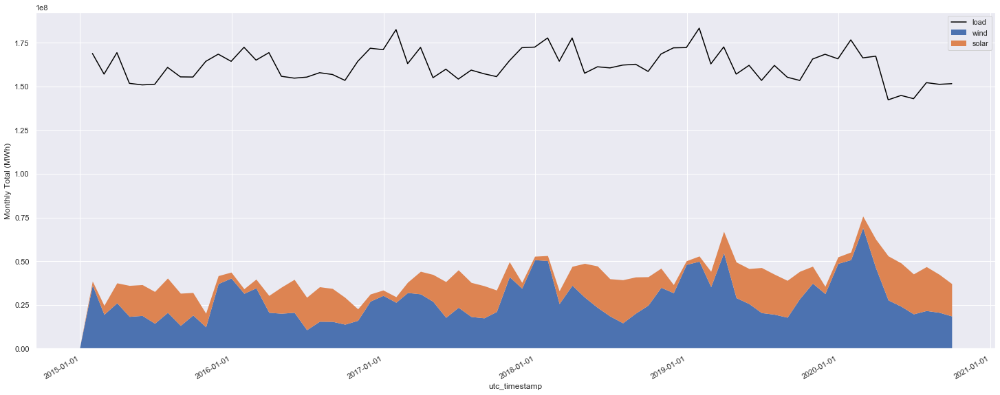

In [87]:
# show how much of the load wind and solar ware able to satisfy in 2019
fig, ax = plt.subplots()
ax.plot(wsd_monthly['load'], color='black', label='load')
wsd_monthly[['wind', 'solar']].plot.area(ax=ax, linewidth=0)
ax.xaxis.set_major_locator(mdates.YearLocator())
ax.legend()
ax.set_ylabel('Monthly Total (MWh)')

### calculating rolling mean - 7 day, centered, full dataset

In [94]:
# Specify the data columns we want to include (i.e. exclude Year, Month, Weekday Name)
data_columns = ['load', 'load_fcast', 'solar', 'wind']
# Resample to weekly frequency, aggregating with mean
wsd_daily_mean = wsd[data_columns].resample('D').mean()

# Compute the centered 7-day rolling mean
wsd_7d = wsd_daily_mean[data_columns].rolling(7, center=True).mean()
wsd_7d.head(10)

,load,load_fcast,solar,wind
utc_timestamp,,,,
2014-12-31 00:00:00+00:00,NaN,NaN,NaN,NaN
2015-01-01 00:00:00+00:00,NaN,NaN,NaN,NaN
2015-01-02 00:00:00+00:00,NaN,NaN,NaN,NaN
2015-01-03 00:00:00+00:00,NaN,NaN,NaN,NaN
2015-01-04 00:00:00+00:00,51405.046631,49837.070184,809.370824,13494.125777
2015-01-05 00:00:00+00:00,53696.683720,51370.401086,714.878259,14172.345759
2015-01-06 00:00:00+00:00,54963.481131,52481.333571,709.312664,14410.239821
2015-01-07 00:00:00+00:00,55709.103065,53171.400685,788.115714,15466.789687
2015-01-08 00:00:00+00:00,56191.115536,53819.669167,787.097143,16937.724449


### calculating rolling mean - 7 day, centered, 2019 data

In [91]:
# Compute the centered 7-day rolling mean
wsd2019_7d = wsd2019_daily_mean[data_columns].rolling(7, center=True).mean()
wsd2019_7d.head(10)

,load,load_fcast,solar,wind
utc_timestamp,,,,
2019-01-01 00:00:00+00:00,NaN,NaN,NaN,NaN
2019-01-02 00:00:00+00:00,NaN,NaN,NaN,NaN
2019-01-03 00:00:00+00:00,NaN,NaN,NaN,NaN
2019-01-04 00:00:00+00:00,55932.875521,53360.549702,609.507426,18573.456667
2019-01-05 00:00:00+00:00,58882.904182,55427.729152,629.765878,19236.656131
2019-01-06 00:00:00+00:00,60180.425952,56363.377292,521.933408,19617.750818
2019-01-07 00:00:00+00:00,60793.690818,57148.243542,453.173259,19165.223646
2019-01-08 00:00:00+00:00,61513.591979,58024.843839,427.935967,18848.136637
2019-01-09 00:00:00+00:00,61826.443958,58272.192649,428.328304,19545.302083


### line plot to visualize 2019 load - daily, weekly, rolling 7 day mean

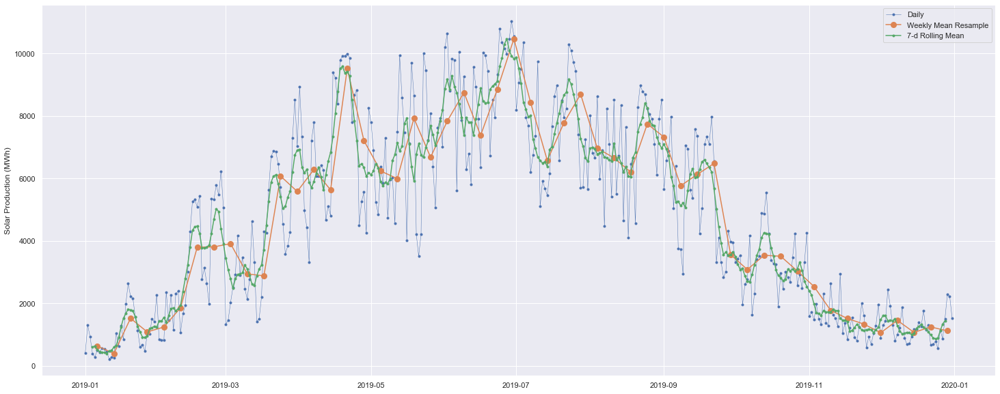

In [92]:
# Start and end of the date range to extract
start, end = '2019-01', '2019-12'
# Plot daily, weekly resampled, and 7-day rolling mean time series together
fig, ax = plt.subplots()
ax.plot(wsd2019_daily_mean.loc[start:end, 'solar'],
marker='.', linestyle='-', linewidth=0.5, label='Daily')
ax.plot(wsd2019_weekly_mean.loc[start:end, 'solar'],
marker='o', markersize=8, linestyle='-', label='Weekly Mean Resample')
ax.plot(wsd2019_7d.loc[start:end, 'solar'],
marker='.', linestyle='-', label='7-d Rolling Mean')
ax.set_ylabel('Solar Production (MWh)')
ax.legend()

### calculate 365 day rolling mean, centered, full dataset

In [95]:
# The min_periods=360 argument accounts for a few isolated missing days in the
# wind and solar production time series
wsd_365d = wsd_7d[data_columns].rolling(window=365, center=True, min_periods=360).mean()

### plot daily load (dots), 7 day and 365 day rolling average (line) for load, full dataset

Text(0.5, 1.0, 'Trends in Electricity Consumption')

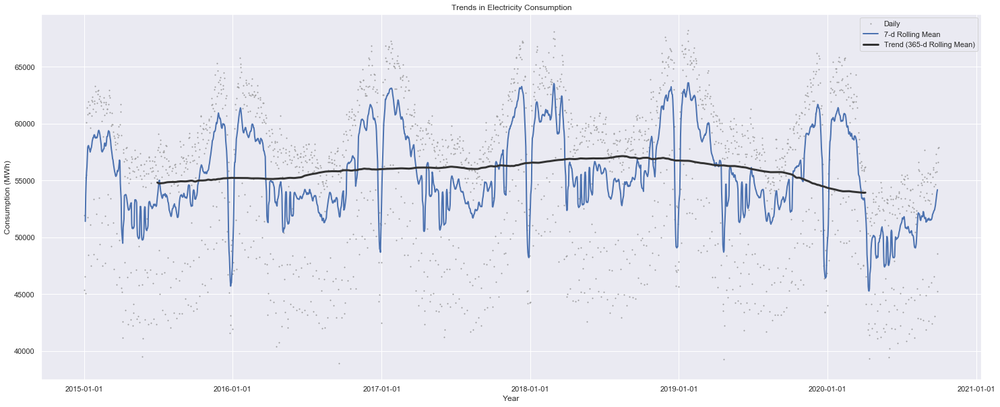

In [96]:
# Plot daily, 7-day rolling mean, and 365-day rolling mean time series
fig, ax = plt.subplots()
ax.plot(wsd_daily_mean['load'], marker='.', markersize=2, color='0.6',
linestyle='None', label='Daily')
ax.plot(wsd_7d['load'], linewidth=2, label='7-d Rolling Mean')
ax.plot(wsd_365d['load'], color='0.2', linewidth=3,
label='Trend (365-d Rolling Mean)')
# Set x-ticks to yearly interval and add legend and labels
ax.xaxis.set_major_locator(mdates.YearLocator())
ax.legend()
ax.set_xlabel('Year')
ax.set_ylabel('Consumption (MWh)')
ax.set_title('Trends in Electricity Consumption')

### line plot of 365 day rolling average for solar and wind, full dataset

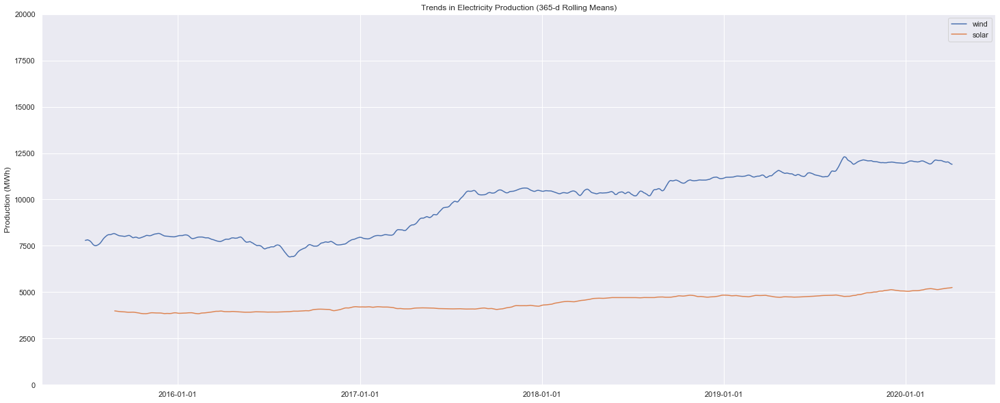

In [100]:
# Plot 365-day rolling mean time series of wind and solar power
fig, ax = plt.subplots()
for nm in ['wind', 'solar']:
    ax.plot(wsd_365d[nm], label=nm)
    # Set x-ticks to yearly interval, adjust y-axis limits, add legend and labels
    ax.xaxis.set_major_locator(mdates.YearLocator())
    ax.set_ylim(0, 20000)
    ax.legend()
    ax.set_ylabel('Production (MWh)')
    ax.set_title('Trends in Electricity Production (365-d Rolling Means)')

# LCA stuff

## Setup BW2 & ecoinvent

Setting up Brightway2 and importing the Ecoinvent database
<div>
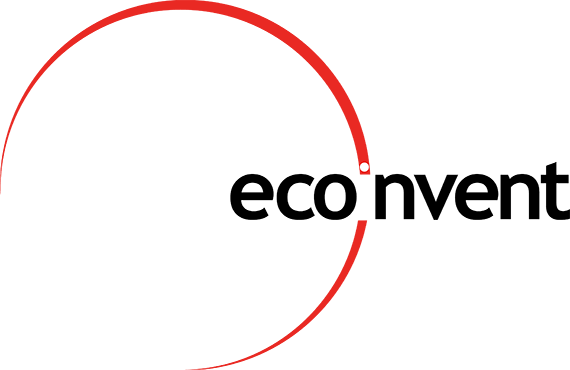
</div>


<div>
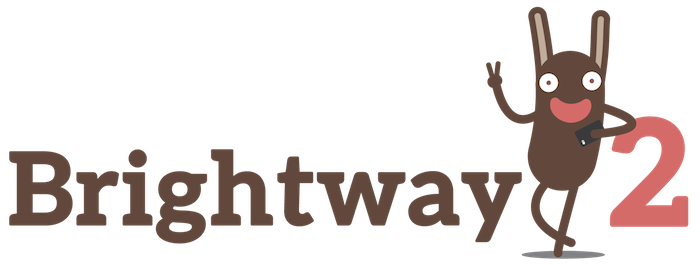
</div>

In [2]:
import os               # to use "operating system dependent functionality"
from scipy import stats
from brightway2 import * #execute on every startup - if Brightway2 functionality is needed

ImportError: cannot import name 'databases' from 'bw2data' (C:\Users\mschaefer\AppData\Local\Continuum\anaconda3\lib\site-packages\bw2data\__init__.py)

In [2]:
projects.set_current('flexess') # this is part of the work for the project flexess
databases # let's see which databases (BW2 objects) already exist within this project

Databases dictionary with 2 object(s):
	biosphere3
	ei36

In [3]:
# only run this cell on first startup - next time you open this fill, biosphere3 will still be here
# biosphere3 = Database('biosphere3')

In [4]:
# only on first startup - see biosphere cell
# bw2setup() #only necessary once, not every time when opening the file

In [5]:
# only on first startup - see biosphere cell
'''
ei36dir = r"path where you stored your ecoinvent database"

if 'ei36' in databases:
    print("Database has already been imported")
else:
    ei36 = SingleOutputEcospold2Importer(ei36dir, 'ei36')
    ei36.apply_strategies()
    ei36.statistics()

ei36.write_database() #only necessary once, not every time when opening the file
'''

'\nei36dir = r"path where you stored your ecoinvent database"\n\nif \'ei36\' in databases:\n    print("Database has already been imported")\nelse:\n    ei36 = SingleOutputEcospold2Importer(ei36dir, \'ei36\')\n    ei36.apply_strategies()\n    ei36.statistics()\n\nei36.write_database() #only necessary once, not every time when opening the file\n'

In [3]:
ei36 = Database('ei36') # give the ecoinvent database a nice, short name

NameError: name 'Database' is not defined

## Search Ecoinvent for power generation technologies & saving them

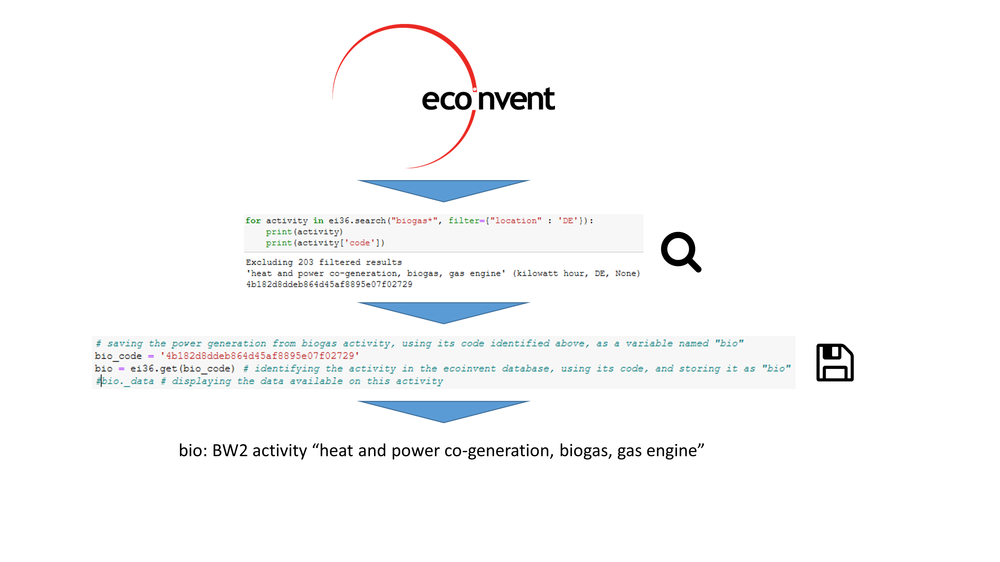

In [7]:
# general, unspecific search - e.g. to find a specific power generation technology
ei36.search("*photovoltaic*") # add asterisks(*term*) before and after search term to not miss any terms, e.g. "*acryl*"

['market for silicon, single crystal, Czochralski process, photovoltaics' (kilogram, RER, None),
 'silicon production, single crystal, Czochralski process, photovoltaics' (kilogram, RER, None),
 'silicon production, single crystal, Czochralski process, photovoltaics' (kilogram, RoW, None),
 'photovoltaics, electric installation for 3kWp module, at building' (unit, RoW, None),
 'photovoltaics, electric installation for 3kWp module, at building' (unit, CH, None),
 'market for silicon, single crystal, Czochralski process, photovoltaics' (kilogram, RoW, None),
 'photovoltaics, electric installation for 570kWp module, open ground' (unit, GLO, None),
 'market for photovoltaics, electric installation for 3kWp module, at building' (unit, GLO, None),
 'photovoltaic laminate production, CdTe' (square meter, DE, None),
 'photovoltaic laminate production, CdTe' (square meter, US, None),
 'photovoltaic panel production, CIS' (square meter, RoW, None),
 'photovoltaic panel production, CIS' (square m

### Search and filter to find technology
to extract activity code

In [8]:
for activity in ei36.search("biogas*", filter={"location" : 'DE'}):
    print(activity)
    print(activity['code'])

Excluding 203 filtered results
'heat and power co-generation, biogas, gas engine' (kilowatt hour, DE, None)
4b182d8ddeb864d45af8895e07f02729
'heat and power co-generation, biogas, gas engine' (megajoule, DE, None)
f465661d33595b8386ba91af4ac6327e


In [9]:
for activity in ei36.search("run of river", filter={"location" : 'DE'}):
    print(activity)
    print(activity['code'])

Excluding 140 filtered results
'electricity production, hydro, run-of-river' (kilowatt hour, DE, None)
9c9b3c3bd5fb7fafad3941b63517fb31


In [10]:
for activity in ei36.search("offshore", filter={"location" : 'DE'}):
    print(activity)
    print(activity['code'])

Excluding 362 filtered results
'electricity production, wind, 1-3MW turbine, offshore' (kilowatt hour, DE, None)
b09e4db4c6ddc389325731378f68fb43
'natural gas, high pressure, import from NL' (cubic meter, DE, None)
cb596536b6e86505f8f005263592d0cc
'natural gas, high pressure, import from NO' (cubic meter, DE, None)
96c32527ca0401aaee1a51f6efd60dd3
'electricity production, wind, 1-3MW turbine, onshore' (kilowatt hour, DE, None)
9681214839940f8a4a377284bc2b9301
'electricity production, wind, <1MW turbine, onshore' (kilowatt hour, DE, None)
69527151864a3aacf9ee67acd9d014ec
'electricity production, wind, >3MW turbine, onshore' (kilowatt hour, DE, None)
1d880f4991c07f0b80ddce7a5be28467


In [11]:
for activity in ei36.search("electricity production, photovoltaic*", filter={"location" : 'DE'}):
    print(activity)
    print(activity['code'])

Excluding 297 filtered results
'electricity production, photovoltaic, 570kWp open ground installation, multi-Si' (kilowatt hour, DE, None)
04ddbbd5f6a7fc1caa49d633c96863f4
'electricity production, photovoltaic, 3kWp slanted-roof installation, single-Si, panel, mounted' (kilowatt hour, DE, None)
ba8e2884bda6251e448284b8d4e9cc15
'electricity production, photovoltaic, 3kWp slanted-roof installation, multi-Si, panel, mounted' (kilowatt hour, DE, None)
54e033826a2db7310f7374435978ebc0


In [12]:
for activity in ei36.search("electricity production, wind*", filter={"location" : 'DE'}):
    print(activity)
    print(activity['code'])

Excluding 321 filtered results
'electricity production, wind, 1-3MW turbine, onshore' (kilowatt hour, DE, None)
9681214839940f8a4a377284bc2b9301
'electricity production, wind, >3MW turbine, onshore' (kilowatt hour, DE, None)
1d880f4991c07f0b80ddce7a5be28467
'electricity production, wind, 1-3MW turbine, offshore' (kilowatt hour, DE, None)
b09e4db4c6ddc389325731378f68fb43
'electricity production, wind, <1MW turbine, onshore' (kilowatt hour, DE, None)
69527151864a3aacf9ee67acd9d014ec


In [13]:
for activity in ei36.search("treatment of municipal solid waste, incineration", filter={"location" : 'DE'}):
    print(activity)
    print(activity['code'])

Excluding 433 filtered results
'treatment of municipal solid waste, incineration' (kilogram, DE, None)
350884f8b3ed1d3ed409351aa188eb8a
'treatment of municipal solid waste, incineration' (megajoule, DE, None)
c202064e3d2ae0d73f60fe2c4bd82615
'treatment of municipal solid waste, incineration' (kilowatt hour, DE, None)
38f323ae070006d8b2ac3d1eb31487d2
'market for municipal solid waste' (kilogram, DE, None)
99f799af4da5e6d15c2470a73bfb8ac1
'lightweight concrete block production, pumice' (kilogram, DE, None)
a6274dca3858b2538a68e2041e8e29a6


In [14]:
for activity in ei36.search("electricity production, nuclear,", filter={"location" : 'DE'}):
    print(activity)
    print(activity['code'])

Excluding 112 filtered results
'electricity production, nuclear, pressure water reactor' (kilowatt hour, DE, None)
97ea99d8d6f97e794544659b9412848d
'electricity production, nuclear, boiling water reactor' (kilowatt hour, DE, None)
b834ceb38cbe75783f4207cdf6d4dad7
'uranium fuel element production, enriched 4%, for light water reactor' (kilogram, DE, None)
6010e6143950fc53f87a5da6ae322b52


In [15]:
for activity in ei36.search("electricity production, lignite", filter={"location" : 'DE'}):
    print(activity)
    print(activity['code'])

Excluding 79 filtered results
'electricity production, lignite' (kilowatt hour, DE, None)
2224f1c97be8cab840a4843462894151
'heat and power co-generation, lignite' (kilowatt hour, DE, None)
69682612976e099cc06328c0a99e8968
'heat and power co-generation, lignite' (megajoule, DE, None)
cb19818015726f668d4bed5dee10edfd


In [16]:
for activity in ei36.search("hard coal", filter={"location" : 'DE'}):
    print(activity)
    print(activity['code'])

Excluding 343 filtered results
'treatment of hard coal ash, residual material landfill' (kilogram, DE, None)
737dbedc08db3dafd7198df932d35caf
'electricity production, hard coal' (kilowatt hour, DE, None)
f071292ae763e087cf952cf3cfaddc45
'heat and power co-generation, hard coal' (kilowatt hour, DE, None)
463424fd0a8958ec7bf57d5195374997
'heat and power co-generation, hard coal' (megajoule, DE, None)
0172226247206763bd3e81e6e58e8886
'coking' (megajoule, DE, None)
ddefe9265dc5baf00eb3e76716b55c20
'coking' (kilogram, DE, None)
acbe99c4215a2169b6d121635777aeb9
'coking' (kilogram, DE, None)
7925d18bcb277fa8804b2f59225a3457
'coking' (megajoule, DE, None)
423b9691454032b9833b96a94ecb5277


In [17]:
for activity in ei36.search("electricity production, natural gas", filter={"location" : 'DE'}):
    print(activity)
    print(activity['code'])

Excluding 915 filtered results
'electricity production, natural gas, conventional power plant' (kilowatt hour, DE, None)
4d2d2d95b089010dc20ccb4d2eba43fa
'electricity production, natural gas, 10MW' (kilowatt hour, DE, None)
a4f3c5133416fb8caa71d6c129d306fa
'electricity production, natural gas, combined cycle power plant' (kilowatt hour, DE, None)
0c3c8bd2c08e07ac3c39a27751a02f4c
'heat and power co-generation, natural gas, conventional power plant, 100MW electrical' (megajoule, DE, None)
88d131052c369320fd53b3f930c03c58
'heat and power co-generation, natural gas, combined cycle power plant, 400MW electrical' (megajoule, DE, None)
6abc11ce962e3267534a0e97d58d848a
'treatment of coal gas, in power plant' (megajoule, DE, None)
78aeeea11eaf247260f352cd04c7cfc5
'heat and power co-generation, natural gas, conventional power plant, 100MW electrical' (kilowatt hour, DE, None)
db7b917f306443270b602863e95c651c
'treatment of blast furnace gas, in power plant' (megajoule, DE, None)
714e8662dd020a9ef

In [18]:
for activity in ei36.search("pumped hydro", filter={"location" : 'DE'}):
    print(activity)
    print(activity['code'])

Excluding 104 filtered results
'electricity production, hydro, pumped storage' (kilowatt hour, DE, None)
144e6488945bf7991e11782804d635cf
'electricity production, hydro, reservoir, non-alpine region' (kilowatt hour, DE, None)
eedc7eac698a9ca8d41e3f13fd961d8c


In [19]:
for activity in ei36.search("electricity production, oil", filter={"location" : 'DE'}):
    print(activity)
    print(activity['code'])

Excluding 347 filtered results
'electricity production, oil' (kilowatt hour, DE, None)
8b1cf1476eb821f27f8a82fec435e103
'heat and power co-generation, oil' (kilowatt hour, DE, None)
988a4bbeb5b9f580f3dafbc7ccc14b9b
'heat and power co-generation, oil' (megajoule, DE, None)
0eee0e161ce4d22337a706b0837a8477
'burnt shale production' (kilowatt hour, DE, None)
b335c36da8a1068460c996a4281fce20
'burnt shale production' (kilogram, DE, None)
bbbc282038d721ad20e893b34567c1cf


### Save activities

Save an activity using the acitivity's code, and display further information about it if you want to find out more about an activity

In [20]:
# saving the power generation from biogas activity, using its code identified above, as a variable named "bio"
bio_code = '4b182d8ddeb864d45af8895e07f02729'
bio = ei36.get(bio_code) # identifying the activity in the ecoinvent database, using its code, and storing it as "bio"
#bio._data # displaying the data available on this activity

In [21]:
# same as before, now for hydro power
hydro_code = '9c9b3c3bd5fb7fafad3941b63517fb31'
hydro = ei36.get(hydro_code)
#hydro._data

In [22]:
wind_offshore_code = 'b09e4db4c6ddc389325731378f68fb43'
wind_offshore = ei36.get(wind_offshore_code)
#wind_offshore._data

In [23]:
PV_code = '04ddbbd5f6a7fc1caa49d633c96863f4'
PV = ei36.get(PV_code)
#PV._data

In [24]:
wind_onshore_code = '1d880f4991c07f0b80ddce7a5be28467'
wind_onshore = ei36.get(wind_onshore_code)
#wind_onshore._data

In [25]:
waste_code = '38f323ae070006d8b2ac3d1eb31487d2'
waste = ei36.get(waste_code)
#waste._data

In [26]:
nuclear_code = '97ea99d8d6f97e794544659b9412848d'
nuclear = ei36.get(nuclear_code)
#nuclear._data

In [27]:
lignite_code = '2224f1c97be8cab840a4843462894151'
lignite = ei36.get(lignite_code)
#lignite._data

In [28]:
hard_coal_code = 'f071292ae763e087cf952cf3cfaddc45'
hard_coal = ei36.get(hard_coal_code)
#hard_coal._data

In [29]:
gas_code = 'db7b917f306443270b602863e95c651c'
gas = ei36.get(gas_code)
#gas._data

In [30]:
pumped_code = '144e6488945bf7991e11782804d635cf'
pumped = ei36.get(pumped_code)
#pumped._data

In [31]:
oil_code = '8b1cf1476eb821f27f8a82fec435e103'
oil = ei36.get(oil_code)
#oil._data

In [32]:
# Putting all these activities into one list
tech = [bio, hydro, wind_offshore, wind_onshore, PV, waste, nuclear, lignite, hard_coal, gas, pumped, oil]
tech

['heat and power co-generation, biogas, gas engine' (kilowatt hour, DE, None),
 'electricity production, hydro, run-of-river' (kilowatt hour, DE, None),
 'electricity production, wind, 1-3MW turbine, offshore' (kilowatt hour, DE, None),
 'electricity production, wind, >3MW turbine, onshore' (kilowatt hour, DE, None),
 'electricity production, photovoltaic, 570kWp open ground installation, multi-Si' (kilowatt hour, DE, None),
 'treatment of municipal solid waste, incineration' (kilowatt hour, DE, None),
 'electricity production, nuclear, pressure water reactor' (kilowatt hour, DE, None),
 'electricity production, lignite' (kilowatt hour, DE, None),
 'electricity production, hard coal' (kilowatt hour, DE, None),
 'heat and power co-generation, natural gas, conventional power plant, 100MW electrical' (kilowatt hour, DE, None),
 'electricity production, hydro, pumped storage' (kilowatt hour, DE, None),
 'electricity production, oil' (kilowatt hour, DE, None)]

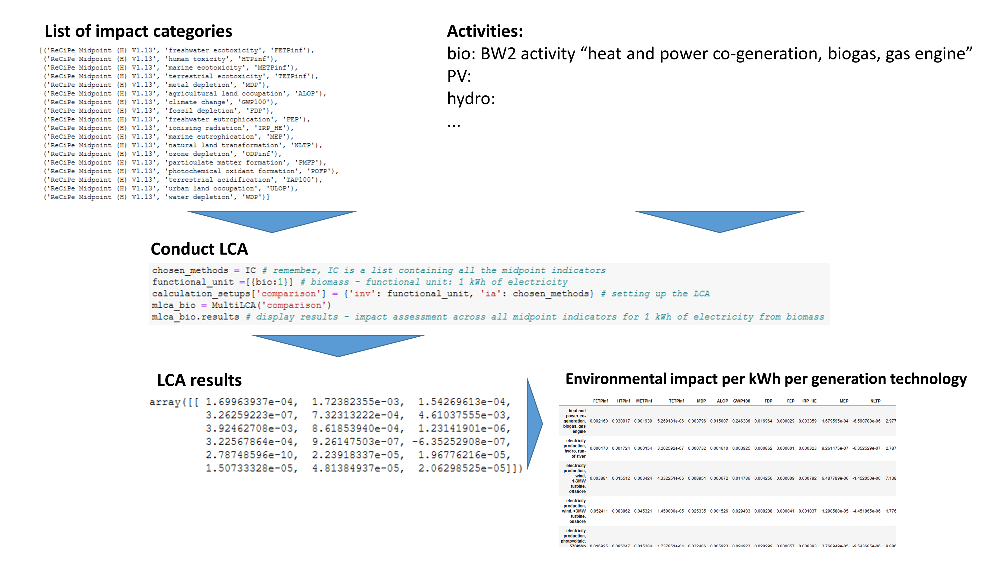

## Define impact categories

In this case we take the whole ReCiPe midpoint set

In [33]:
IC = [m for m in methods if # go through all impact assessment methods (several hundred)
       'ReCiPe Midpoint (H)' in str(m) # look for the term 'ReCiPe Midpoint (H)' in their names
       and not 'no LT' in str(m) # we want to include those midpoint indicators without longterm (LT) assessment
       and not 'obsolete' in str(m) # we only want current methods, no obsolete ones
      ]
IC # list of tuples

[('ReCiPe Midpoint (H) V1.13', 'freshwater ecotoxicity', 'FETPinf'),
 ('ReCiPe Midpoint (H) V1.13', 'human toxicity', 'HTPinf'),
 ('ReCiPe Midpoint (H) V1.13', 'marine ecotoxicity', 'METPinf'),
 ('ReCiPe Midpoint (H) V1.13', 'terrestrial ecotoxicity', 'TETPinf'),
 ('ReCiPe Midpoint (H) V1.13', 'metal depletion', 'MDP'),
 ('ReCiPe Midpoint (H) V1.13', 'agricultural land occupation', 'ALOP'),
 ('ReCiPe Midpoint (H) V1.13', 'climate change', 'GWP100'),
 ('ReCiPe Midpoint (H) V1.13', 'fossil depletion', 'FDP'),
 ('ReCiPe Midpoint (H) V1.13', 'freshwater eutrophication', 'FEP'),
 ('ReCiPe Midpoint (H) V1.13', 'ionising radiation', 'IRP_HE'),
 ('ReCiPe Midpoint (H) V1.13', 'marine eutrophication', 'MEP'),
 ('ReCiPe Midpoint (H) V1.13', 'natural land transformation', 'NLTP'),
 ('ReCiPe Midpoint (H) V1.13', 'ozone depletion', 'ODPinf'),
 ('ReCiPe Midpoint (H) V1.13', 'particulate matter formation', 'PMFP'),
 ('ReCiPe Midpoint (H) V1.13', 'photochemical oxidant formation', 'POFP'),
 ('ReCiPe Mi

## Conduct Multi-LCAs
Multi LCA: assessing multiple impact categories at once

In [34]:
chosen_methods = IC # remember, IC is a list containing all the midpoint indicators
functional_unit =[{bio:1}] # biomass - functional unit: 1 kWh of electricity
calculation_setups['comparison'] = {'inv': functional_unit, 'ia': chosen_methods} # setting up the LCA
mlca_bio = MultiLCA('comparison')
mlca_bio.results # display results - impact assessment across all midpoint indicators for 1 kWh of electricity from biomass

array([[ 2.15965840e-03,  3.09172841e-02,  1.93908193e-03,
         5.26918098e-06,  3.79550739e-03,  1.50072066e-02,
         2.46386203e-01,  1.69640888e-02,  2.94037374e-05,
         3.35873749e-03,  1.67959538e-04, -6.59078757e-06,
         2.97713221e-09,  7.34400656e-04,  5.54934566e-04,
         4.65368140e-03,  8.50322843e-04,  1.83536869e-04]])

In [35]:
# repeating the same steps for hydro power
chosen_methods = IC
functional_unit =[{hydro:1}] # hydro run of river
calculation_setups['comparison'] = {'inv': functional_unit, 'ia': chosen_methods}
mlca_hydro = MultiLCA('comparison')
mlca_hydro.results

array([[ 1.69963937e-04,  1.72382355e-03,  1.54269613e-04,
         3.26259223e-07,  7.32313222e-04,  4.61037555e-03,
         3.92462708e-03,  8.61853940e-04,  1.23141901e-06,
         3.22567864e-04,  9.26147503e-07, -6.35252908e-07,
         2.78748596e-10,  2.23918337e-05,  1.96776216e-05,
         1.50733328e-05,  4.81384937e-05,  2.06298525e-05]])

In [36]:
chosen_methods = IC
functional_unit =[{wind_offshore:1}]
calculation_setups['comparison'] = {'inv': functional_unit, 'ia': chosen_methods}
mlca_wind_offshore = MultiLCA('comparison')
mlca_wind_offshore.results

array([[ 3.88080782e-03,  1.55115477e-02,  3.42358277e-03,
         4.33225126e-06,  8.95083315e-03,  6.71644297e-04,
         1.47858668e-02,  4.25554831e-03,  8.64957869e-06,
         7.92041271e-04,  6.48778898e-06, -1.45205028e-06,
         7.13856217e-10,  5.27156801e-05,  6.54976933e-05,
         8.06577921e-05,  1.64244755e-04,  1.78381975e-04]])

In [37]:
chosen_methods = IC
functional_unit =[{PV:1}]
calculation_setups['comparison'] = {'inv': functional_unit, 'ia': chosen_methods}
mlca_PV = MultiLCA('comparison')
mlca_PV.results

array([[ 1.69252000e-02,  8.52473428e-02,  1.53837974e-02,
         1.73785072e-04,  3.24862235e-02,  5.92296787e-03,
         9.49226314e-02,  2.82992752e-02,  5.73641878e-05,
         8.38345017e-03,  3.76894899e-05, -9.54368509e-06,
         9.88620819e-09,  2.61388900e-04,  3.92617063e-04,
         5.01565576e-04,  4.65809568e-02,  3.02274044e-03]])

In [38]:
chosen_methods = IC
functional_unit =[{wind_onshore:1}]
calculation_setups['comparison'] = {'inv': functional_unit, 'ia': chosen_methods}
mlca_wind_onshore = MultiLCA('comparison')
mlca_wind_onshore.results

array([[ 5.24108909e-02,  8.38622568e-02,  4.53211865e-02,
         1.45000021e-05,  2.53350454e-02,  1.52597062e-03,
         2.94034774e-02,  8.20819850e-03,  4.14832020e-05,
         1.83694708e-03,  1.29058819e-05, -4.45186548e-06,
         1.77650081e-09,  1.47989030e-04,  1.67580820e-04,
         2.97896873e-04,  1.06813087e-03,  2.90747222e-04]])

In [39]:
chosen_methods = IC
functional_unit =[{waste:1}]
calculation_setups['comparison'] = {'inv': functional_unit, 'ia': chosen_methods}
mlca_waste = MultiLCA('comparison')
mlca_waste.results

array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0.]])

In [40]:
chosen_methods = IC
functional_unit =[{nuclear:1}]
calculation_setups['comparison'] = {'inv': functional_unit, 'ia': chosen_methods}
mlca_nuclear = MultiLCA('comparison')
mlca_nuclear.results

array([[ 7.57640444e-04,  2.55858648e-02,  7.41707030e-04,
         2.94680199e-06,  3.65600988e-03,  7.88651681e-04,
         1.06679579e-02,  3.03581832e-03,  7.91200196e-06,
         5.94188119e-01,  4.16619637e-05, -4.97529619e-07,
         9.21683185e-08,  5.01705141e-05,  4.46373315e-05,
         4.86654849e-05,  1.29077851e-04,  3.11860117e-03]])

In [41]:
chosen_methods = IC
functional_unit =[{lignite:1}]
calculation_setups['comparison'] = {'inv': functional_unit, 'ia': chosen_methods}
mlca_lignite = MultiLCA('comparison')
mlca_lignite.results

array([[ 4.25525238e-02,  1.69114795e+00,  4.06052809e-02,
         5.42116811e-06,  7.54700185e-03,  3.84166506e-03,
         1.22162434e+00,  2.88764756e-01,  2.92166056e-03,
         6.87854845e-03,  6.45578357e-04, -2.99292710e-05,
         2.47415695e-09,  4.64541735e-04,  9.70243555e-04,
         1.46504867e-03,  3.70897752e-04,  2.54091338e-03]])

In [42]:
chosen_methods = IC
functional_unit =[{hard_coal:1}]
calculation_setups['comparison'] = {'inv': functional_unit, 'ia': chosen_methods}
mlca_hard_coal = MultiLCA('comparison')
mlca_hard_coal.results

array([[ 9.59466019e-03,  3.72683158e-01,  9.11148037e-03,
         1.26017158e-05,  3.74627433e-03,  1.37582038e-02,
         1.03952064e+00,  2.66524708e-01,  5.30147907e-04,
         9.53475209e-03,  1.82656453e-04, -4.90596178e-05,
         9.38030079e-09,  7.33132524e-04,  1.70552502e-03,
         2.19896173e-03,  5.20158567e-03,  1.88221310e-03]])

In [43]:
chosen_methods = IC
functional_unit =[{gas:1}]
calculation_setups['comparison'] = {'inv': functional_unit, 'ia': chosen_methods}
mlca_gas = MultiLCA('comparison')
mlca_gas.results

array([[ 1.66182944e-03,  1.04657261e-02,  1.60498056e-03,
         3.76184071e-06,  2.69024944e-03,  6.84475678e-04,
         5.41135916e-01,  2.97210024e-01,  7.53040056e-06,
         9.41839009e-04,  2.32378770e-05, -6.49930909e-06,
         8.83083335e-08,  1.93521443e-04,  7.52112894e-04,
         5.63198413e-04,  5.21146369e-04,  8.24689866e-04]])

In [44]:
chosen_methods = IC
functional_unit =[{pumped:1}]
calculation_setups['comparison'] = {'inv': functional_unit, 'ia': chosen_methods}
mlca_pumped = MultiLCA('comparison')
mlca_pumped.results

array([[ 2.23909222e-02,  7.74930970e-01,  2.11367982e-02,
         1.11034239e-05,  9.04639602e-03,  8.43098625e-02,
         9.36085621e-01,  2.37570970e-01,  1.28036016e-03,
         1.61175930e-01,  3.33627098e-04, -1.70608467e-04,
         4.21177954e-08,  5.57679533e-04,  1.14154652e-03,
         1.81922852e-03,  2.66736851e-03,  3.48803154e-03]])

In [45]:
chosen_methods = IC
functional_unit =[{oil:1}]
calculation_setups['comparison'] = {'inv': functional_unit, 'ia': chosen_methods}
mlca_oil = MultiLCA('comparison')
mlca_oil.results

array([[ 1.42693887e-03,  3.48799543e-02,  1.54034254e-03,
         4.61612323e-05,  2.46249210e-03,  1.55993874e-03,
         8.46434816e-01,  2.60735278e-01,  1.10720469e-05,
         4.88779133e-02,  1.19314257e-04, -4.28362412e-06,
         1.37591427e-07,  7.13713079e-04,  1.35904801e-03,
         2.48190236e-03,  1.10624856e-03,  1.44443176e-03]])

## Save results to dataframe (df)
We want them stored in dataframes, where we can easily manipulate them (e.g. using pandas)

### Create individual dfs per technology

In [52]:
# store all the results of the MultiLCA for biomass in a nowly created dataframe
# lis[2] is the abbreviation of the midpoint indicator (e.g. GWP100)
df_results_bio = pd.DataFrame(index=[bio["name"]], columns=[lis[2] for lis in chosen_methods], data=mlca_bio.results)
df_results_bio

,FETPinf,HTPinf,METPinf,TETPinf,MDP,ALOP,GWP100,FDP,FEP,IRP_HE,MEP,NLTP,ODPinf,PMFP,POFP,TAP100,ULOP,WDP
"heat and power co-generation, biogas, gas engine",0.00216,0.030917,0.001939,0.000005,0.003796,0.015007,0.246386,0.016964,0.000029,0.003359,0.000168,-0.000007,2.977132e-09,0.000734,0.000555,0.004654,0.00085,0.000184


In [53]:
df_results_hydro = pd.DataFrame(index=[hydro["name"]], columns=[lis[2] for lis in chosen_methods], data=mlca_hydro.results)
df_results_hydro

,FETPinf,HTPinf,METPinf,TETPinf,MDP,ALOP,GWP100,FDP,FEP,IRP_HE,MEP,NLTP,ODPinf,PMFP,POFP,TAP100,ULOP,WDP
"electricity production, hydro, run-of-river",0.00017,0.001724,0.000154,3.262592e-07,0.000732,0.00461,0.003925,0.000862,0.000001,0.000323,9.261475e-07,-6.352529e-07,2.787486e-10,0.000022,0.00002,0.000015,0.000048,0.000021


In [54]:
df_results_wind_offshore = pd.DataFrame(index=[wind_offshore["name"]], columns=[lis[2] for lis in chosen_methods], data=mlca_wind_offshore.results)
df_results_wind_offshore

,FETPinf,HTPinf,METPinf,TETPinf,MDP,ALOP,GWP100,FDP,FEP,IRP_HE,MEP,NLTP,ODPinf,PMFP,POFP,TAP100,ULOP,WDP
"electricity production, wind, 1-3MW turbine, offshore",0.003881,0.015512,0.003424,0.000004,0.008951,0.000672,0.014786,0.004256,0.000009,0.000792,0.000006,-0.000001,7.138562e-10,0.000053,0.000065,0.000081,0.000164,0.000178


In [55]:
df_results_PV = pd.DataFrame(index=[PV["name"]], columns=[lis[2] for lis in chosen_methods], data=mlca_PV.results)
df_results_PV

,FETPinf,HTPinf,METPinf,TETPinf,MDP,ALOP,GWP100,FDP,FEP,IRP_HE,MEP,NLTP,ODPinf,PMFP,POFP,TAP100,ULOP,WDP
"electricity production, photovoltaic, 570kWp open ground installation, multi-Si",0.016925,0.085247,0.015384,0.000174,0.032486,0.005923,0.094923,0.028299,0.000057,0.008383,0.000038,-0.00001,9.886208e-09,0.000261,0.000393,0.000502,0.046581,0.003023


In [56]:
df_results_wind_onshore = pd.DataFrame(index=[wind_onshore["name"]], columns=[lis[2] for lis in chosen_methods], data=mlca_wind_onshore.results)
df_results_wind_onshore

,FETPinf,HTPinf,METPinf,TETPinf,MDP,ALOP,GWP100,FDP,FEP,IRP_HE,MEP,NLTP,ODPinf,PMFP,POFP,TAP100,ULOP,WDP
"electricity production, wind, >3MW turbine, onshore",0.052411,0.083862,0.045321,0.000015,0.025335,0.001526,0.029403,0.008208,0.000041,0.001837,0.000013,-0.000004,1.776501e-09,0.000148,0.000168,0.000298,0.001068,0.000291


In [57]:
df_results_waste = pd.DataFrame(index=[waste["name"]], columns=[lis[2] for lis in chosen_methods], data=mlca_waste.results)
df_results_waste

,FETPinf,HTPinf,METPinf,TETPinf,MDP,ALOP,GWP100,FDP,FEP,IRP_HE,MEP,NLTP,ODPinf,PMFP,POFP,TAP100,ULOP,WDP
"treatment of municipal solid waste, incineration",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [58]:
df_results_nuclear = pd.DataFrame(index=[nuclear["name"]], columns=[lis[2] for lis in chosen_methods], data=mlca_nuclear.results)
df_results_nuclear

,FETPinf,HTPinf,METPinf,TETPinf,MDP,ALOP,GWP100,FDP,FEP,IRP_HE,MEP,NLTP,ODPinf,PMFP,POFP,TAP100,ULOP,WDP
"electricity production, nuclear, pressure water reactor",0.000758,0.025586,0.000742,0.000003,0.003656,0.000789,0.010668,0.003036,0.000008,0.594188,0.000042,-4.975296e-07,9.216832e-08,0.00005,0.000045,0.000049,0.000129,0.003119


In [59]:
df_results_lignite = pd.DataFrame(index=[lignite["name"]], columns=[lis[2] for lis in chosen_methods], data=mlca_lignite.results)
df_results_lignite

,FETPinf,HTPinf,METPinf,TETPinf,MDP,ALOP,GWP100,FDP,FEP,IRP_HE,MEP,NLTP,ODPinf,PMFP,POFP,TAP100,ULOP,WDP
"electricity production, lignite",0.042553,1.691148,0.040605,0.000005,0.007547,0.003842,1.221624,0.288765,0.002922,0.006879,0.000646,-0.00003,2.474157e-09,0.000465,0.00097,0.001465,0.000371,0.002541


In [60]:
df_results_hard_coal = pd.DataFrame(index=[hard_coal["name"]], columns=[lis[2] for lis in chosen_methods], data=mlca_hard_coal.results)
df_results_hard_coal

,FETPinf,HTPinf,METPinf,TETPinf,MDP,ALOP,GWP100,FDP,FEP,IRP_HE,MEP,NLTP,ODPinf,PMFP,POFP,TAP100,ULOP,WDP
"electricity production, hard coal",0.009595,0.372683,0.009111,0.000013,0.003746,0.013758,1.039521,0.266525,0.00053,0.009535,0.000183,-0.000049,9.380301e-09,0.000733,0.001706,0.002199,0.005202,0.001882


In [61]:
df_results_gas = pd.DataFrame(index=[gas["name"]], columns=[lis[2] for lis in chosen_methods], data=mlca_gas.results)
df_results_gas

,FETPinf,HTPinf,METPinf,TETPinf,MDP,ALOP,GWP100,FDP,FEP,IRP_HE,MEP,NLTP,ODPinf,PMFP,POFP,TAP100,ULOP,WDP
"heat and power co-generation, natural gas, conventional power plant, 100MW electrical",0.001662,0.010466,0.001605,0.000004,0.00269,0.000684,0.541136,0.29721,0.000008,0.000942,0.000023,-0.000006,8.830833e-08,0.000194,0.000752,0.000563,0.000521,0.000825


In [62]:
df_results_pumped = pd.DataFrame(index=[pumped["name"]], columns=[lis[2] for lis in chosen_methods], data=mlca_pumped.results)
df_results_pumped

,FETPinf,HTPinf,METPinf,TETPinf,MDP,ALOP,GWP100,FDP,FEP,IRP_HE,MEP,NLTP,ODPinf,PMFP,POFP,TAP100,ULOP,WDP
"electricity production, hydro, pumped storage",0.022391,0.774931,0.021137,0.000011,0.009046,0.08431,0.936086,0.237571,0.00128,0.161176,0.000334,-0.000171,4.211780e-08,0.000558,0.001142,0.001819,0.002667,0.003488


In [63]:
df_results_oil = pd.DataFrame(index=[oil["name"]], columns=[lis[2] for lis in chosen_methods], data=mlca_oil.results)
df_results_oil

,FETPinf,HTPinf,METPinf,TETPinf,MDP,ALOP,GWP100,FDP,FEP,IRP_HE,MEP,NLTP,ODPinf,PMFP,POFP,TAP100,ULOP,WDP
"electricity production, oil",0.001427,0.03488,0.00154,0.000046,0.002462,0.00156,0.846435,0.260735,0.000011,0.048878,0.000119,-0.000004,1.375914e-07,0.000714,0.001359,0.002482,0.001106,0.001444


### Concatenate dataframes to make one df for all technologies
Concatenate = glue together

In [64]:
df_results = pd.concat([df_results_bio,
                        df_results_hydro,
                        df_results_wind_offshore,
                        df_results_wind_onshore,
                        df_results_PV,
                        df_results_waste,
                        df_results_nuclear,
                        df_results_lignite,
                        df_results_hard_coal,
                        df_results_gas,
                        df_results_pumped,
                        df_results_oil],
                       axis=0) # axis = 0: glue them on top of one another, instead of side by side
df_results

,FETPinf,HTPinf,METPinf,TETPinf,MDP,ALOP,GWP100,FDP,FEP,IRP_HE,MEP,NLTP,ODPinf,PMFP,POFP,TAP100,ULOP,WDP
"heat and power co-generation, biogas, gas engine",0.002160,0.030917,0.001939,5.269181e-06,0.003796,0.015007,0.246386,0.016964,0.000029,0.003359,1.679595e-04,-6.590788e-06,2.977132e-09,0.000734,0.000555,0.004654,0.000850,0.000184
"electricity production, hydro, run-of-river",0.000170,0.001724,0.000154,3.262592e-07,0.000732,0.004610,0.003925,0.000862,0.000001,0.000323,9.261475e-07,-6.352529e-07,2.787486e-10,0.000022,0.000020,0.000015,0.000048,0.000021
"electricity production, wind, 1-3MW turbine, offshore",0.003881,0.015512,0.003424,4.332251e-06,0.008951,0.000672,0.014786,0.004256,0.000009,0.000792,6.487789e-06,-1.452050e-06,7.138562e-10,0.000053,0.000065,0.000081,0.000164,0.000178
"electricity production, wind, >3MW turbine, onshore",0.052411,0.083862,0.045321,1.450000e-05,0.025335,0.001526,0.029403,0.008208,0.000041,0.001837,1.290588e-05,-4.451865e-06,1.776501e-09,0.000148,0.000168,0.000298,0.001068,0.000291
"electricity production, photovoltaic, 570kWp open ground installation, multi-Si",0.016925,0.085247,0.015384,1.737851e-04,0.032486,0.005923,0.094923,0.028299,0.000057,0.008383,3.768949e-05,-9.543685e-06,9.886208e-09,0.000261,0.000393,0.000502,0.046581,0.003023
"treatment of municipal solid waste, incineration",0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000
"electricity production, nuclear, pressure water reactor",0.000758,0.025586,0.000742,2.946802e-06,0.003656,0.000789,0.010668,0.003036,0.000008,0.594188,4.166196e-05,-4.975296e-07,9.216832e-08,0.000050,0.000045,0.000049,0.000129,0.003119
"electricity production, lignite",0.042553,1.691148,0.040605,5.421168e-06,0.007547,0.003842,1.221624,0.288765,0.002922,0.006879,6.455784e-04,-2.992927e-05,2.474157e-09,0.000465,0.000970,0.001465,0.000371,0.002541
"electricity production, hard coal",0.009595,0.372683,0.009111,1.260172e-05,0.003746,0.013758,1.039521,0.266525,0.000530,0.009535,1.826565e-04,-4.905962e-05,9.380301e-09,0.000733,0.001706,0.002199,0.005202,0.001882
"heat and power co-generation, natural gas, conventional power plant, 100MW electrical",0.001662,0.010466,0.001605,3.761841e-06,0.002690,0.000684,0.541136,0.297210,0.000008,0.000942,2.323788e-05,-6.499309e-06,8.830833e-08,0.000194,0.000752,0.000563,0.000521,0.000825


In [65]:
df_results.to_csv('impact_matrix_ecoinvent_recipe_powergeneration.csv')

In [60]:
# define a variable that consists of one one column from the dataframe we just created
GWP100 = df_results['GWP100'] # in this case, we pick the GWP100 column
GWP100

heat and power co-generation, biogas, gas engine                                         0.246386
electricity production, hydro, run-of-river                                              0.003925
electricity production, wind, 1-3MW turbine, offshore                                    0.014786
electricity production, wind, >3MW turbine, onshore                                      0.029403
electricity production, photovoltaic, 570kWp open ground installation, multi-Si          0.094923
treatment of municipal solid waste, incineration                                         0.000000
electricity production, nuclear, pressure water reactor                                  0.010668
electricity production, lignite                                                          1.221624
electricity production, hard coal                                                        1.039521
heat and power co-generation, natural gas, conventional power plant, 100MW electrical    0.541136
electricity producti

In [61]:
# what datatype may GWP100 have?
type(GWP100)

pandas.core.series.Series

# Data Preparation

## Importing CSV

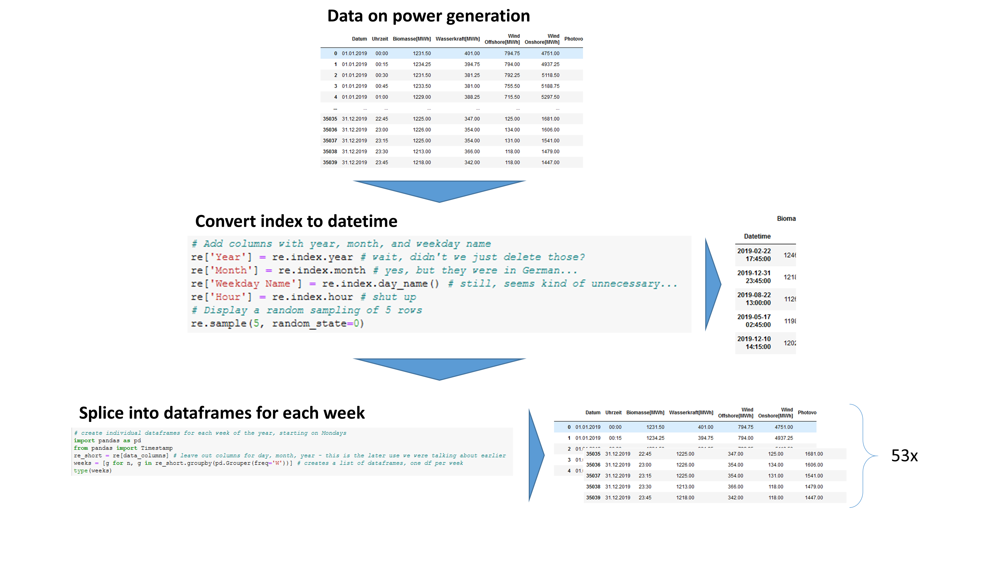

### Actual Power Generation Per Technology Type ("Realisierte Erzeugung")
from smard.de

In [66]:
# importing the CSV file, merging the Datum and Uhrzeit column into one that is already parsed in datetime
data_file = 're19.csv' # power generation for the whole year of 2019
re = pd.read_csv(data_file, sep=';') # sep: which character is used to separate columns from one another
re # short, sweet name to call it by

,Datum,Uhrzeit,Biomasse[MWh],Wasserkraft[MWh],Wind Offshore[MWh],Wind Onshore[MWh],Photovoltaik[MWh],Sonstige Erneuerbare[MWh],Kernenergie[MWh],Braunkohle[MWh],Steinkohle[MWh],Erdgas[MWh],Pumpspeicher[MWh],Sonstige Konventionelle[MWh]
0,01.01.2019,00:00,1231.50,401.00,794.75,4751.00,0.0,27.5,2250.50,1733.0,836.0,851.0,29.50,341.0
1,01.01.2019,00:15,1234.25,394.75,794.00,4937.25,0.0,27.5,2263.25,1588.0,730.0,822.0,80.00,339.0
2,01.01.2019,00:30,1231.50,381.25,792.25,5118.50,0.0,27.5,2246.00,1555.0,649.0,805.0,29.00,341.0
3,01.01.2019,00:45,1233.50,381.00,755.50,5188.75,0.0,27.5,2241.75,1459.0,598.0,797.0,29.25,341.0
4,01.01.2019,01:00,1229.00,388.25,715.50,5297.50,0.0,27.5,2224.50,1368.0,611.0,766.0,29.00,339.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35035,31.12.2019,22:45,1225.00,347.00,125.00,1681.00,0.0,50.0,2021.00,2273.0,581.0,1357.0,678.00,332.0
35036,31.12.2019,23:00,1226.00,354.00,134.00,1606.00,0.0,50.0,2022.00,2258.0,569.0,1345.0,361.00,336.0
35037,31.12.2019,23:15,1225.00,354.00,131.00,1541.00,0.0,50.0,2022.00,2253.0,533.0,1337.0,287.00,335.0
35038,31.12.2019,23:30,1213.00,366.00,118.00,1479.00,0.0,50.0,2022.00,2260.0,481.0,1335.0,432.00,333.0


In [67]:
# converting to datetime format (much easier to work with) and making this the new index of the df
format = '%d.%m.%Y %H:%M' # the most precise information we have is minutes ('%M')
re['Datetime'] = pd.to_datetime(re['Datum'] + ' ' + re['Uhrzeit'], format=format) # create new column "Datetime" from existing columns
re = re.set_index(pd.DatetimeIndex(re['Datetime'])) # set column as index
re = re.drop(['Datum','Uhrzeit','Datetime'], axis=1) # delete these columns, we don't need them (where we are going...)
re

,Biomasse[MWh],Wasserkraft[MWh],Wind Offshore[MWh],Wind Onshore[MWh],Photovoltaik[MWh],Sonstige Erneuerbare[MWh],Kernenergie[MWh],Braunkohle[MWh],Steinkohle[MWh],Erdgas[MWh],Pumpspeicher[MWh],Sonstige Konventionelle[MWh]
Datetime,,,,,,,,,,,,
2019-01-01 00:00:00,1231.50,401.00,794.75,4751.00,0.0,27.5,2250.50,1733.0,836.0,851.0,29.50,341.0
2019-01-01 00:15:00,1234.25,394.75,794.00,4937.25,0.0,27.5,2263.25,1588.0,730.0,822.0,80.00,339.0
2019-01-01 00:30:00,1231.50,381.25,792.25,5118.50,0.0,27.5,2246.00,1555.0,649.0,805.0,29.00,341.0
2019-01-01 00:45:00,1233.50,381.00,755.50,5188.75,0.0,27.5,2241.75,1459.0,598.0,797.0,29.25,341.0
2019-01-01 01:00:00,1229.00,388.25,715.50,5297.50,0.0,27.5,2224.50,1368.0,611.0,766.0,29.00,339.0
...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-31 22:45:00,1225.00,347.00,125.00,1681.00,0.0,50.0,2021.00,2273.0,581.0,1357.0,678.00,332.0
2019-12-31 23:00:00,1226.00,354.00,134.00,1606.00,0.0,50.0,2022.00,2258.0,569.0,1345.0,361.00,336.0
2019-12-31 23:15:00,1225.00,354.00,131.00,1541.00,0.0,50.0,2022.00,2253.0,533.0,1337.0,287.00,335.0


In [68]:
re.to_csv('re19.csv')

In [64]:
# drop [MWh] in the column names
re.columns = ['Biomasse','Wasserkraft', 'Wind Offshore', 'Wind Onshore', 'Photovoltaik', 'Sonst. Erneuerbare', 'Kernenergie', 'Braunkohle', 'Steinkohle', 'Erdgas', 'Pumpspeicher', 'Sonst. Konventionelle']
re

,Biomasse,Wasserkraft,Wind Offshore,Wind Onshore,Photovoltaik,Sonst. Erneuerbare,Kernenergie,Braunkohle,Steinkohle,Erdgas,Pumpspeicher,Sonst. Konventionelle
Datetime,,,,,,,,,,,,
2019-01-01 00:00:00,1231.50,401.00,794.75,4751.00,0.0,27.5,2250.50,1733.0,836.0,851.0,29.50,341.0
2019-01-01 00:15:00,1234.25,394.75,794.00,4937.25,0.0,27.5,2263.25,1588.0,730.0,822.0,80.00,339.0
2019-01-01 00:30:00,1231.50,381.25,792.25,5118.50,0.0,27.5,2246.00,1555.0,649.0,805.0,29.00,341.0
2019-01-01 00:45:00,1233.50,381.00,755.50,5188.75,0.0,27.5,2241.75,1459.0,598.0,797.0,29.25,341.0
2019-01-01 01:00:00,1229.00,388.25,715.50,5297.50,0.0,27.5,2224.50,1368.0,611.0,766.0,29.00,339.0
...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-31 22:45:00,1225.00,347.00,125.00,1681.00,0.0,50.0,2021.00,2273.0,581.0,1357.0,678.00,332.0
2019-12-31 23:00:00,1226.00,354.00,134.00,1606.00,0.0,50.0,2022.00,2258.0,569.0,1345.0,361.00,336.0
2019-12-31 23:15:00,1225.00,354.00,131.00,1541.00,0.0,50.0,2022.00,2253.0,533.0,1337.0,287.00,335.0


In [65]:
# checking the file type - we want all column to be floats
re.dtypes

Biomasse                 float64
Wasserkraft              float64
Wind Offshore            float64
Wind Onshore             float64
Photovoltaik             float64
Sonst. Erneuerbare       float64
Kernenergie              float64
Braunkohle               float64
Steinkohle               float64
Erdgas                   float64
Pumpspeicher             float64
Sonst. Konventionelle    float64
dtype: object

In [66]:
# Add columns with year, month, and weekday name
re['Year'] = re.index.year # wait, didn't we just delete those?
re['Month'] = re.index.month # yes, but they were in German...
re['Weekday Name'] = re.index.day_name() # still, seems kind of unnecessary...
re['Hour'] = re.index.hour # shut up
# Display a random sampling of 5 rows
re.sample(5, random_state=0)

,Biomasse,Wasserkraft,Wind Offshore,Wind Onshore,Photovoltaik,Sonst. Erneuerbare,Kernenergie,Braunkohle,Steinkohle,Erdgas,Pumpspeicher,Sonst. Konventionelle,Year,Month,Weekday Name,Hour
Datetime,,,,,,,,,,,,,,,,
2019-02-22 17:45:00,1246.75,491.25,330.0,1022.50,4.0,44.5,2355.5,4331.0,2912.0,2035.0,609.0,384.0,2019,2,Friday,17
2019-12-31 23:45:00,1218.00,342.00,118.0,1447.00,0.0,50.0,2023.0,2269.0,496.0,1331.0,404.0,333.0,2019,12,Tuesday,23
2019-08-22 13:00:00,1126.00,616.00,569.0,1101.00,6750.0,30.0,1879.0,2154.0,729.0,1397.0,0.0,292.0,2019,8,Thursday,13
2019-05-17 02:45:00,1198.00,488.00,1091.5,1278.75,0.0,37.0,1639.5,3072.0,964.0,1242.0,7.0,282.0,2019,5,Friday,2
2019-12-10 14:15:00,1202.00,383.00,1363.0,2420.00,1384.0,37.0,2230.0,3674.0,2359.0,2469.0,281.0,312.0,2019,12,Tuesday,14


In [67]:
# Create list with the names of only the power generation data columns (to exclude year, month, day) - for later use
data_columns = ['Biomasse','Wasserkraft', 'Wind Offshore', 'Wind Onshore', 'Photovoltaik', 'Sonst. Erneuerbare', 'Kernenergie', 'Braunkohle', 'Steinkohle', 'Erdgas', 'Pumpspeicher', 'Sonst. Konventionelle']
data_columns

['Biomasse',
 'Wasserkraft',
 'Wind Offshore',
 'Wind Onshore',
 'Photovoltaik',
 'Sonst. Erneuerbare',
 'Kernenergie',
 'Braunkohle',
 'Steinkohle',
 'Erdgas',
 'Pumpspeicher',
 'Sonst. Konventionelle']

In [68]:
# create individual dataframes for each week of the year, starting on Mondays
import pandas as pd
from pandas import Timestamp
re_short = re[data_columns] # leave out columns for day, month, year - this is the later use we were talking about earlier
weeks = [g for n, g in re_short.groupby(pd.Grouper(freq='W'))] # creates a list of dataframes, one df per week
type(weeks)

list

In [69]:
# sum up power generation over all technologies, per 15 min time interval
weeks[0].sum(axis=1) # for first (incomplete) week of the year

Datetime
2019-01-01 00:00:00    13246.75
2019-01-01 00:15:00    13210.00
2019-01-01 00:30:00    13176.00
2019-01-01 00:45:00    13052.25
2019-01-01 01:00:00    12995.25
                         ...   
2019-01-06 22:45:00    15173.00
2019-01-06 23:00:00    15083.50
2019-01-06 23:15:00    15046.75
2019-01-06 23:30:00    15049.75
2019-01-06 23:45:00    15007.50
Length: 576, dtype: float64

So in the first 15 minutes of the year, roughly 13 GWh of electricity were produced

### Using databases other than SMARD, ENTSOE (fill in later)
format analogously to previous section

## Resampling & rolling averages

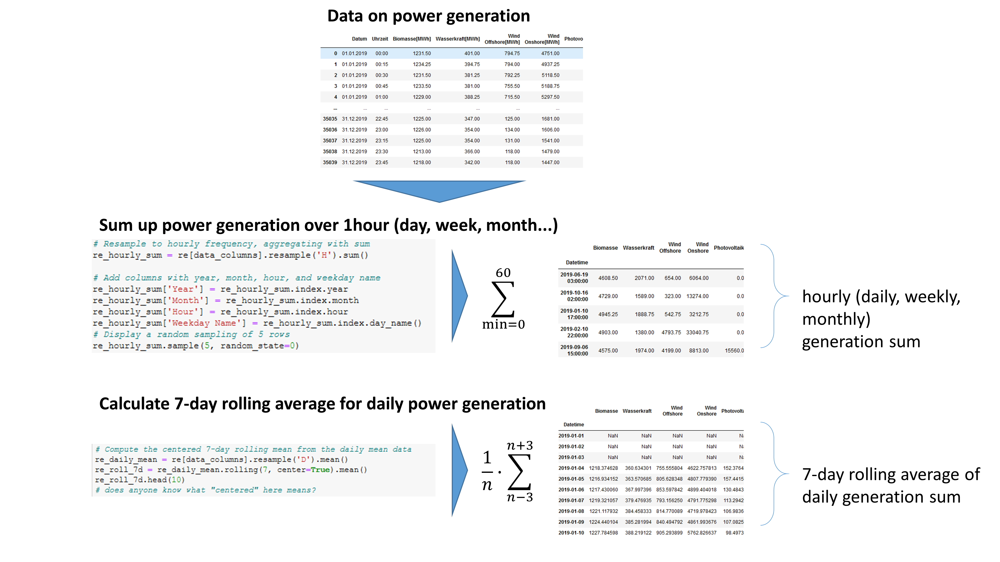

### Actual Power Generation Per Technology Type ("Realisierte Erzeugung")
Later we will probably have other sub-sections, using other data inputs

#### Summing up over time intervals

In [70]:
# Resample to hourly frequency, aggregating with sum
re_hourly_sum = re[data_columns].resample('H').sum()

# Add columns with year, month, hour, and weekday name
re_hourly_sum['Year'] = re_hourly_sum.index.year
re_hourly_sum['Month'] = re_hourly_sum.index.month
re_hourly_sum['Hour'] = re_hourly_sum.index.hour
re_hourly_sum['Weekday Name'] = re_hourly_sum.index.day_name()
# Display a random sampling of 5 rows
re_hourly_sum.sample(5, random_state=0)

,Biomasse,Wasserkraft,Wind Offshore,Wind Onshore,Photovoltaik,Sonst. Erneuerbare,Kernenergie,Braunkohle,Steinkohle,Erdgas,Pumpspeicher,Sonst. Konventionelle,Year,Month,Hour,Weekday Name
Datetime,,,,,,,,,,,,,,,,
2019-06-19 03:00:00,4608.50,2071.00,654.00,6064.00,0.0,107.0,6127.50,12169.0,4815.0,6369.0,2.0,756.0,2019,6,3,Wednesday
2019-10-16 02:00:00,4729.00,1589.00,323.00,13274.00,0.0,148.0,9164.00,10809.0,2525.0,7640.0,0.0,1202.0,2019,10,2,Wednesday
2019-01-10 17:00:00,4945.25,1888.75,542.75,3212.75,0.0,185.0,9504.75,14794.0,16129.0,12482.0,4284.0,1811.0,2019,1,17,Thursday
2019-02-10 22:00:00,4903.00,1380.00,4793.75,33040.75,0.0,138.0,7223.75,5645.0,2190.0,3065.0,1475.5,1166.0,2019,2,22,Sunday
2019-09-06 15:00:00,4575.00,1974.00,4199.00,8813.00,15560.0,125.0,7799.00,8579.0,2006.0,7709.0,351.0,794.0,2019,9,15,Friday


In [71]:
# Same as before, now summing up over a whole day
re_daily_sum = re[data_columns].resample('D').sum()

# Add columns with year, month, and weekday name
re_daily_sum['Year'] = re_daily_sum.index.year
re_daily_sum['Month'] = re_daily_sum.index.month
re_daily_sum['Weekday Name'] = re_daily_sum.index.day_name()
# Display a random sampling of 5 rows
re_daily_sum.sample(5, random_state=0)

,Biomasse,Wasserkraft,Wind Offshore,Wind Onshore,Photovoltaik,Sonst. Erneuerbare,Kernenergie,Braunkohle,Steinkohle,Erdgas,Pumpspeicher,Sonst. Konventionelle,Year,Month,Weekday Name
Datetime,,,,,,,,,,,,,,,
2019-04-17,117200.75,40850.75,107933.5,290431.50,201037.25,3741.00,190669.50,335042.0,109061.0,156382.0,24217.25,27931.0,2019,4,Wednesday
2019-09-17,101242.00,41364.00,101141.0,464982.00,121190.00,3509.00,185249.00,228328.0,85264.0,150378.0,14565.00,26410.0,2019,9,Tuesday
2019-02-15,117735.50,37379.25,52225.0,152710.75,126462.50,4146.25,225329.75,400347.0,236811.0,178857.0,25235.00,38634.0,2019,2,Friday
2019-01-27,118452.25,31524.75,81912.0,504271.75,23961.50,4058.75,222954.75,286949.0,124922.0,111871.0,14404.50,29312.0,2019,1,Sunday
2019-03-20,118557.75,47889.50,74522.0,172144.25,160745.25,3878.25,224970.25,368772.0,178734.0,172594.0,22961.50,27299.0,2019,3,Wednesday


In [72]:
# weekly sum
re_weekly_sum = re[data_columns].resample('W').sum()

# Add columns with year, month, and weekday name
re_weekly_sum['Year'] = re_weekly_sum.index.year
re_weekly_sum['Month'] = re_weekly_sum.index.month
re_weekly_sum['Weekday Name'] = re_weekly_sum.index.day_name()
# Display a random sampling of 5 rows
re_weekly_sum.sample(5, random_state=0)

,Biomasse,Wasserkraft,Wind Offshore,Wind Onshore,Photovoltaik,Sonst. Erneuerbare,Kernenergie,Braunkohle,Steinkohle,Erdgas,Pumpspeicher,Sonst. Konventionelle,Year,Month,Weekday Name
Datetime,,,,,,,,,,,,,,,
2019-11-03,801057.0,264125.0,388487.00,1658232.00,426766.00,31035.00,1547811.00,1948954.0,1126492.0,1290003.0,172768.00,220323.0,2019,11,Sunday
2019-08-18,724797.0,364870.0,431845.00,1527862.00,1042370.00,21118.00,1196934.00,1416680.0,414545.0,950996.0,130385.00,203735.0,2019,8,Sunday
2019-09-29,705046.0,254592.0,473553.00,1988412.00,597750.00,24548.00,1491736.00,1856323.0,699596.0,1155655.0,179526.00,200067.0,2019,9,Sunday
2019-08-25,757621.0,378035.0,287604.00,767790.00,1300637.00,19747.00,1290870.00,1827095.0,506193.0,1019949.0,180240.00,195781.0,2019,8,Sunday
2019-03-24,814970.0,323974.0,435322.75,1448285.25,1020195.25,27493.25,1563561.25,2417608.0,1011814.0,1009959.0,174352.25,187684.0,2019,3,Sunday


In [73]:
# monthly sum
re_monthly_sum = re[data_columns].resample('M').sum()

# Add columns with year, month, and weekday name
re_monthly_sum['Year'] = re_monthly_sum.index.year
re_monthly_sum['Month'] = re_monthly_sum.index.month
re_monthly_sum['Weekday Name'] = re_monthly_sum.index.day_name()
# Display a random sampling of 5 rows
re_monthly_sum.sample(5, random_state=0)

,Biomasse,Wasserkraft,Wind Offshore,Wind Onshore,Photovoltaik,Sonst. Erneuerbare,Kernenergie,Braunkohle,Steinkohle,Erdgas,Pumpspeicher,Sonst. Konventionelle,Year,Month,Weekday Name
Datetime,,,,,,,,,,,,,,,
2019-07-31,3286216.00,1575616.0,1670599.00,4898253.00,5734841.00,95446.00,5439656.00,8156906.0,3258366.0,4813125.0,641627.00,607740.0,2019,7,Wednesday
2019-12-31,3602310.00,1113422.0,3017427.00,12164801.00,933657.00,140356.00,6524296.00,7663477.0,3657454.0,4526842.0,913378.00,970647.0,2019,12,Tuesday
2019-05-31,3571409.75,1525997.0,1787855.75,6415489.50,5023180.25,101561.25,4610711.25,8655060.5,3495247.0,3367363.0,665321.00,803160.0,2019,5,Friday
2019-11-30,3390966.00,1158064.0,2225915.00,7844359.00,1048480.00,124665.00,6460473.00,10042068.0,6042456.0,5268709.0,728817.00,893706.0,2019,11,Saturday
2019-03-31,3604208.25,1364205.0,2542735.75,13682568.25,3051987.00,120599.75,6713151.75,8298586.0,3119772.0,3648080.0,834917.25,894964.0,2019,3,Sunday


#### Rolling means (rolling averages)
Instead of summing up, you can also form the rolling mean over a certain time period

In [74]:
# Compute the centered 7-day rolling mean from the daily mean data
re_daily_mean = re[data_columns].resample('D').mean()
re_roll_7d = re_daily_mean.rolling(7, center=True).mean()
re_roll_7d.head(10)
# does anyone know what "centered" here means?

,Biomasse,Wasserkraft,Wind Offshore,Wind Onshore,Photovoltaik,Sonst. Erneuerbare,Kernenergie,Braunkohle,Steinkohle,Erdgas,Pumpspeicher,Sonst. Konventionelle
Datetime,,,,,,,,,,,,
2019-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-04,1218.374628,360.634301,755.555804,4622.757813,152.376488,27.500000,2210.995164,3078.309524,1908.095238,1520.565476,235.683408,337.141369
2019-01-05,1216.934152,363.570685,805.628348,4807.779390,157.441592,27.500000,2277.681920,3215.809524,1971.404762,1606.331845,240.719494,337.933036
2019-01-06,1217.430060,367.997396,853.597842,4899.404018,130.484375,27.500000,2314.979539,3293.647321,2044.074405,1677.892857,247.238467,341.075893
2019-01-07,1219.321057,379.476935,793.156250,4791.775298,113.294271,28.927455,2314.992560,3300.258929,2143.568452,1749.266369,265.149554,348.144345
2019-01-08,1221.117932,384.458333,814.770089,4719.978423,106.983631,31.589658,2311.150298,3281.086310,2271.501488,1819.937500,275.575521,350.733631
2019-01-09,1224.440104,385.281994,840.494792,4861.993676,107.082589,34.064360,2303.412946,3203.455357,2254.949405,1814.543155,276.634301,351.544643


#### Forming sums of sums

In [75]:
# calculate sum of rows to get total generation per time interval (here: 15min)
re_row_sum = pd.DataFrame(re_short.sum(axis=1), columns=["Gesamterzeugung"]) # sum up across the whole row (axis=1)

# Add columns with year, month, and weekday name
re_row_sum['Year'] = re_row_sum.index.year
re_row_sum['Month'] = re_row_sum.index.month
re_row_sum['Weekday Name'] = re_row_sum.index.day_name()

# Display a random sampling of 5 rows
re_row_sum.sample(5, random_state=0)

,Gesamterzeugung,Year,Month,Weekday Name
Datetime,,,,
2019-02-22 17:45:00,15765.50,2019,2,Friday
2019-12-31 23:45:00,10031.00,2019,12,Tuesday
2019-08-22 13:00:00,16643.00,2019,8,Thursday
2019-05-17 02:45:00,11299.75,2019,5,Friday
2019-12-10 14:15:00,18114.00,2019,12,Tuesday


In [76]:
# hourly sum from row-summed df (total power generation per time interval)
re_row_sum_h_sum = pd.DataFrame(re_row_sum['Gesamterzeugung'].resample('H').sum(), columns=["Gesamterzeugung"])
re_row_sum_h_sum.head(5)

,Gesamterzeugung
Datetime,
2019-01-01 00:00:00,52685.00
2019-01-01 01:00:00,52197.50
2019-01-01 02:00:00,51294.00
2019-01-01 03:00:00,51796.25
2019-01-01 04:00:00,53511.25


Roughly 53 GWh of electricity produced during the first hour of the year

In [77]:
# daily sum from row-summed df (total power generation per time interval)
re_row_sum_d_sum = pd.DataFrame(re_row_sum['Gesamterzeugung'].resample('D').sum(), columns=["Gesamterzeugung"])

# Add columns with year, month, and weekday name
re_row_sum_d_sum['Year'] = re_row_sum_d_sum.index.year
re_row_sum_d_sum['Month'] = re_row_sum_d_sum.index.month
re_row_sum_d_sum['Weekday Name'] = re_row_sum_d_sum.index.day_name()

# Display a random sampling of 5 rows
re_row_sum_d_sum.sample(5, random_state=0)

,Gesamterzeugung,Year,Month,Weekday Name
Datetime,,,,
2019-04-17,1604497.50,2019,4,Wednesday
2019-09-17,1523622.00,2019,9,Tuesday
2019-02-15,1595873.00,2019,2,Friday
2019-01-27,1554594.25,2019,1,Sunday
2019-03-20,1573067.75,2019,3,Wednesday


In [78]:
# weekly sum from row-summed df (total power generation per time interval)
re_row_sum_w_sum = pd.DataFrame(re_row_sum['Gesamterzeugung'].resample('W').sum(), columns=["Gesamterzeugung"])
re_row_sum_w_sum.sample(5)

,Gesamterzeugung
Datetime,
2019-10-20,10283842.0
2019-09-08,8854227.0
2019-05-26,8863937.5
2019-09-29,9626804.0
2019-04-14,10523127.5


In [79]:
# monthly sum from row-summed df (total power generation per time interval)
re_row_sum_m_sum = pd.DataFrame(re_row_sum['Gesamterzeugung'].resample('M').sum(), columns=["Gesamterzeugung"])
re_row_sum_m_sum.sample(5)

,Gesamterzeugung
Datetime,
2019-12-31,45228067.00
2019-11-30,45228678.00
2019-07-31,40178391.00
2019-05-31,40022356.25
2019-10-31,45369196.00


## Create df with specific environmental impacts per technology [impact / kWh]

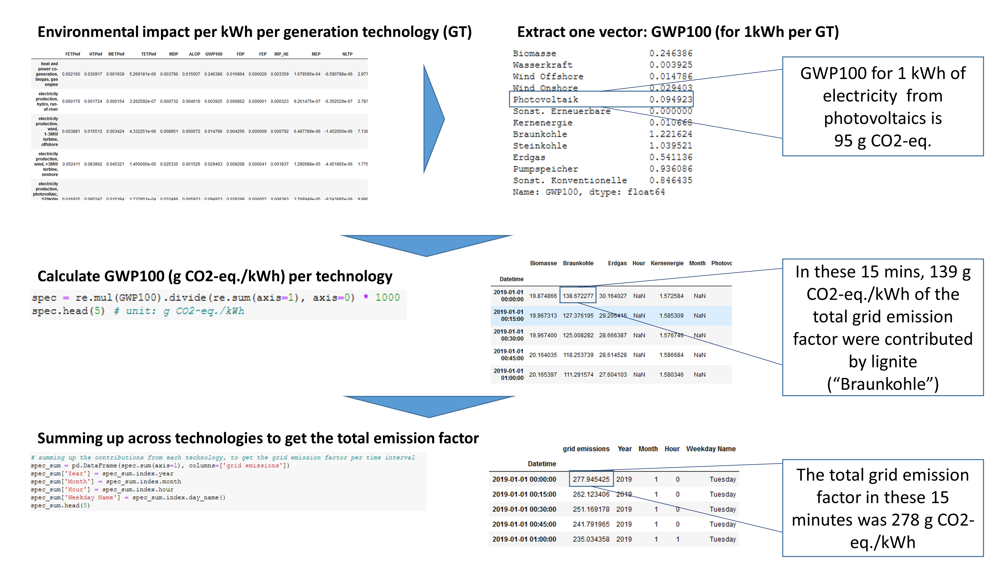

In [80]:
df_results.index = data_columns # only the power generation columns, not the date and time columns
df_results

,FETPinf,HTPinf,METPinf,TETPinf,MDP,ALOP,GWP100,FDP,FEP,IRP_HE,MEP,NLTP,ODPinf,PMFP,POFP,TAP100,ULOP,WDP
Biomasse,0.002160,0.030917,0.001939,5.269181e-06,0.003796,0.015007,0.246386,0.016964,0.000029,0.003359,1.679595e-04,-6.590788e-06,2.977132e-09,0.000734,0.000555,0.004654,0.000850,0.000184
Wasserkraft,0.000170,0.001724,0.000154,3.262592e-07,0.000732,0.004610,0.003925,0.000862,0.000001,0.000323,9.261475e-07,-6.352529e-07,2.787486e-10,0.000022,0.000020,0.000015,0.000048,0.000021
Wind Offshore,0.003881,0.015512,0.003424,4.332251e-06,0.008951,0.000672,0.014786,0.004256,0.000009,0.000792,6.487789e-06,-1.452050e-06,7.138562e-10,0.000053,0.000065,0.000081,0.000164,0.000178
Wind Onshore,0.052411,0.083862,0.045321,1.450000e-05,0.025335,0.001526,0.029403,0.008208,0.000041,0.001837,1.290588e-05,-4.451865e-06,1.776501e-09,0.000148,0.000168,0.000298,0.001068,0.000291
Photovoltaik,0.016925,0.085247,0.015384,1.737851e-04,0.032486,0.005923,0.094923,0.028299,0.000057,0.008383,3.768949e-05,-9.543685e-06,9.886208e-09,0.000261,0.000393,0.000502,0.046581,0.003023
Sonst. Erneuerbare,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000
Kernenergie,0.000758,0.025586,0.000742,2.946802e-06,0.003656,0.000789,0.010668,0.003036,0.000008,0.594188,4.166196e-05,-4.975296e-07,9.216832e-08,0.000050,0.000045,0.000049,0.000129,0.003119
Braunkohle,0.042553,1.691148,0.040605,5.421168e-06,0.007547,0.003842,1.221624,0.288765,0.002922,0.006879,6.455784e-04,-2.992927e-05,2.474157e-09,0.000465,0.000970,0.001465,0.000371,0.002541
Steinkohle,0.009595,0.372683,0.009111,1.260172e-05,0.003746,0.013758,1.039521,0.266525,0.000530,0.009535,1.826565e-04,-4.905962e-05,9.380301e-09,0.000733,0.001706,0.002199,0.005202,0.001882
Erdgas,0.001662,0.010466,0.001605,3.761841e-06,0.002690,0.000684,0.541136,0.297210,0.000008,0.000942,2.323788e-05,-6.499309e-06,8.830833e-08,0.000194,0.000752,0.000563,0.000521,0.000825


In [81]:
FETPinf = df_results['FETPinf'] # make easier accessible - shorter wording
HTPinf = df_results['HTPinf'] # I know there must be a more elegant way to do this
METPinf = df_results['METPinf']
TETPinf = df_results['TETPinf']
MDP = df_results['MDP']
ALOP = df_results['ALOP']
GWP100 = df_results['GWP100']
FDP = df_results['FDP']
FEP = df_results['FEP']
IRP_HE = df_results['IRP_HE']
MEP = df_results['MEP']
NLTP = df_results['NLTP']
ODPinf = df_results['ODPinf']
PMFP = df_results['PMFP']
POFP = df_results['POFP']
TAP100 = df_results['TAP100']
ULOP = df_results['ULOP']
WDP = df_results['WDP']
GWP100 # unit: kg CO2-eq./kWh

Biomasse                 0.246386
Wasserkraft              0.003925
Wind Offshore            0.014786
Wind Onshore             0.029403
Photovoltaik             0.094923
Sonst. Erneuerbare       0.000000
Kernenergie              0.010668
Braunkohle               1.221624
Steinkohle               1.039521
Erdgas                   0.541136
Pumpspeicher             0.936086
Sonst. Konventionelle    0.846435
Name: GWP100, dtype: float64

In [82]:
type(GWP100)

pandas.core.series.Series

In [83]:
spec = re.mul(GWP100).divide(re.sum(axis=1), axis=0) * 1000 # contribution from each technology to the grid emission factor
spec.head(5) # unit: g CO2-eq./kWh

,Biomasse,Braunkohle,Erdgas,Hour,Kernenergie,Month,Photovoltaik,Pumpspeicher,Sonst. Erneuerbare,Sonst. Konventionelle,Steinkohle,Wasserkraft,Weekday Name,Wind Offshore,Wind Onshore,Year
Datetime,,,,,,,,,,,,,,,,
2019-01-01 00:00:00,19.874866,138.672277,30.164027,NaN,1.572584,NaN,0.0,1.808802,0.0,18.906072,56.923658,0.103085,NaN,0.769716,9.150338,NaN
2019-01-01 00:15:00,19.967313,127.376195,29.206416,NaN,1.585309,NaN,0.0,4.917062,0.0,18.840539,49.826006,0.101723,NaN,0.770846,9.531997,NaN
2019-01-01 00:30:00,19.967400,125.008282,28.666387,NaN,1.576746,NaN,0.0,1.786423,0.0,18.994095,44.396479,0.098464,NaN,0.770868,9.904034,NaN
2019-01-01 00:45:00,20.164035,118.253739,28.614528,NaN,1.586684,NaN,0.0,1.816617,0.0,19.150045,41.243567,0.099208,NaN,0.741145,10.122397,NaN
2019-01-01 01:00:00,20.165397,111.291574,27.604103,NaN,1.580346,NaN,0.0,1.807807,0.0,19.108726,42.297319,0.101473,NaN,0.704523,10.373091,NaN


in the first 15 min, Braunkohle contributed 139 g CO2-eq./kWh to the grid emission factor

In [84]:
# create individual dataframes for every week, containing the grid emission factor
import pandas as pd
from pandas import Timestamp
spec_short = spec[data_columns] # leave out columns for day, month, year - this is the later use we were talking about earlier
spec_weeks = [g for n, g in spec_short.groupby(pd.Grouper(freq='W'))] # creates a list of dataframes, one df per week
type(spec_weeks)

list

In [85]:
# summing up the contributions from each technology, to get the grid emission factor per time interval
spec_sum = pd.DataFrame(spec.sum(axis=1), columns=['grid emissions'])
spec_sum['Year'] = spec_sum.index.year
spec_sum['Month'] = spec_sum.index.month
spec_sum['Hour'] = spec_sum.index.hour
spec_sum['Weekday Name'] = spec_sum.index.day_name()
spec_sum.head(5)

,grid emissions,Year,Month,Hour,Weekday Name
Datetime,,,,,
2019-01-01 00:00:00,277.945425,2019,1,0,Tuesday
2019-01-01 00:15:00,262.123406,2019,1,0,Tuesday
2019-01-01 00:30:00,251.169178,2019,1,0,Tuesday
2019-01-01 00:45:00,241.791965,2019,1,0,Tuesday
2019-01-01 01:00:00,235.034358,2019,1,1,Tuesday


in the first 15 min, the grid emission factor was 278 g CO2-eq./kWh

In [86]:
import pandas as pd
from pandas import Timestamp
#ss_short = spec_sum[data_columns] # leave out columns for day, month, year - this is the later use we were talking about earlier
ss_weeks = [g for n, g in spec_sum.groupby(pd.Grouper(freq='W'))] # creates a list of dataframes, one df per week
ss_weeks[51]

,grid emissions,Year,Month,Hour,Weekday Name
Datetime,,,,,
2019-12-23 00:00:00,219.062410,2019,12,0,Monday
2019-12-23 00:15:00,218.582927,2019,12,0,Monday
2019-12-23 00:30:00,217.745877,2019,12,0,Monday
2019-12-23 00:45:00,215.015846,2019,12,0,Monday
2019-12-23 01:00:00,213.102856,2019,12,1,Monday
...,...,...,...,...,...
2019-12-29 22:45:00,296.457310,2019,12,22,Sunday
2019-12-29 23:00:00,292.664438,2019,12,23,Sunday
2019-12-29 23:15:00,282.072596,2019,12,23,Sunday


# Data Visualization

## Power Generation

### Stacked Area Plots

####  Stacked area chart of all generation options, one year, weekly sums

In [87]:
# let's take a look at the re_weekly_sum df again
re_weekly_sum.head(5)

,Biomasse,Wasserkraft,Wind Offshore,Wind Onshore,Photovoltaik,Sonst. Erneuerbare,Kernenergie,Braunkohle,Steinkohle,Erdgas,Pumpspeicher,Sonst. Konventionelle,Year,Month,Weekday Name
Datetime,,,,,,,,,,,,,,,
2019-01-06,701910.75,205751.75,436988.25,2737912.25,91967.50,15840.00,1262491.50,1716361.0,1019768.0,830544.0,119181.00,194639.0,2019,1,Sunday
2019-01-13,825071.25,260883.25,608357.50,3872619.50,66190.25,23523.75,1531392.75,1917913.0,1370189.0,1143334.0,173792.25,232158.0,2019,1,Sunday
2019-01-20,828036.50,274463.25,479799.25,3115340.50,255614.50,30368.50,1536333.00,2170934.0,1703195.0,1238607.0,166908.25,210634.0,2019,1,Sunday
2019-01-27,830076.25,273072.25,392732.50,1517092.25,182533.00,30546.50,1587707.25,2576629.0,2160875.0,1628904.0,231082.50,222097.0,2019,1,Sunday
2019-02-03,823576.50,241490.00,487685.75,1806833.25,208708.00,30342.50,1581023.75,2546854.0,2127808.0,1484065.0,194932.75,214082.0,2019,2,Sunday


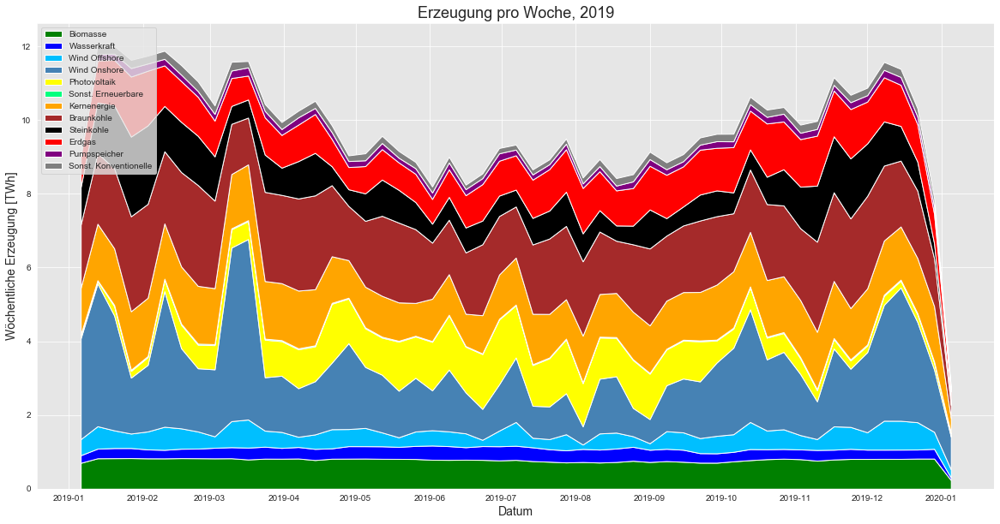

In [88]:
import matplotlib.dates as dates # needed for scaling of x-axis to months
import matplotlib.ticker as ticker # needed for ycaling of y-axis

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # set the style; the ".9" is to decrease the vertical distance of the heading

t = re_weekly_sum[data_columns].transpose() # transpose dataframe so the dataset is oriented correctly
#plt.stackplot(t.columns, t, labels=list(t.index)) # define columns, dataset and labels

fig, ax = plt.subplots(figsize=(20,10))
colors = ['green', 'blue', 'deepskyblue', 'steelblue', 'yellow', 'springgreen', 'orange', 'brown', 'black', 'red', 'purple', 'grey']
ax.stackplot(t.columns, t, labels=list(t.index), colors=colors) # define plot columns, labels, colors
ax.legend(loc='upper left')# add legend at the top left
ax.set_title('Erzeugung pro Woche, 2019', fontsize = 18)
ax.xaxis.set_major_locator(dates.MonthLocator()) # set x-ticks to months

# scale y-axis by factor of 1000:
scale_y = 1e6
ticks_y = ticker.FuncFormatter(lambda x, pos: '{0:g}'.format(x/scale_y))
ax.yaxis.set_major_formatter(ticks_y)

# add labels:
plt.xlabel('Datum', fontsize = 14)
plt.ylabel('Wöchentliche Erzeugung [TWh]', fontsize=14)

# plot:
#plt.savefig('generation_weekly_whole_year.png')
plt.show()

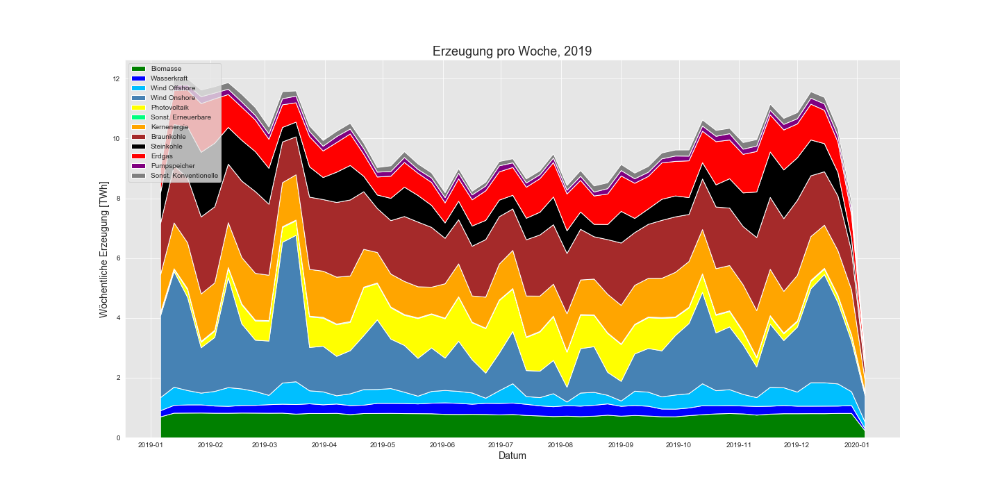

#### Stacked area chart for one week, 15 min resolution

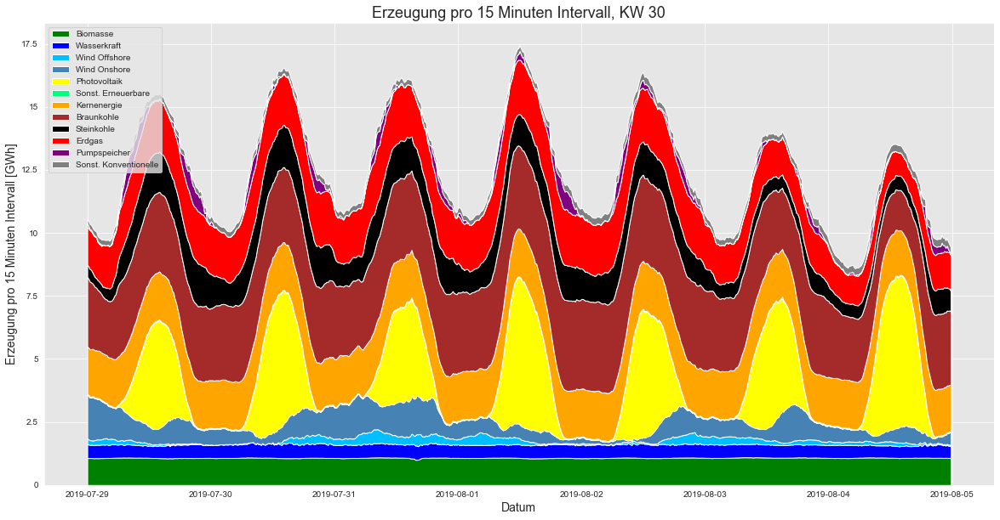

In [89]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.dates as dates #needed for scaling of x-axis to months
import matplotlib.ticker as ticker # needed for ycaling of y-axis

sns.set_style("darkgrid", {"axes.facecolor": ".9"})

# transpose dataframe so the dataset is oriented correctly
t = weeks[30].transpose()

# define colors for the plot
colors = ['green', 'blue', 'deepskyblue', 'steelblue', 'yellow', 'springgreen', 'orange', 'brown', 'black', 'red', 'purple', 'grey']

# define the plot
fig, ax = plt.subplots(figsize = (20,10))
ax.stackplot(t.columns, t, labels=list(t.index), colors=colors) # define plot columns, labels, colors
ax.set_title('Erzeugung pro 15 Minuten Intervall, KW 30', fontsize = 18)
ax.legend(loc='upper left') # add legend at the top left
ax.set_xlabel('Datum', fontsize = 14)
ax.set_ylabel('Erzeugung pro 15 Minuten Intervall [GWh]', fontsize = 14)
ax.xaxis.set_major_locator(dates.DayLocator()) # set x-ticks to days

# scale y-axis by factor of 1000:
scale_y = 1e3
ticks_y = ticker.FuncFormatter(lambda x, pos: '{0:g}'.format(x/scale_y))
ax.yaxis.set_major_formatter(ticks_y)

# plot:
# plt.savefig('generation_15min_cw30.png')
plt.show()

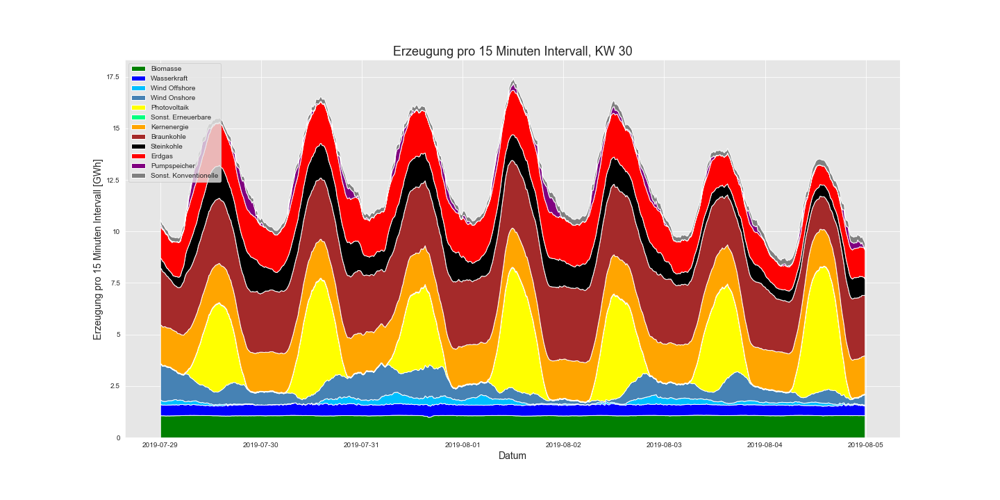

#### Stacked area plot for four different weeks, 15min intervals, power generation

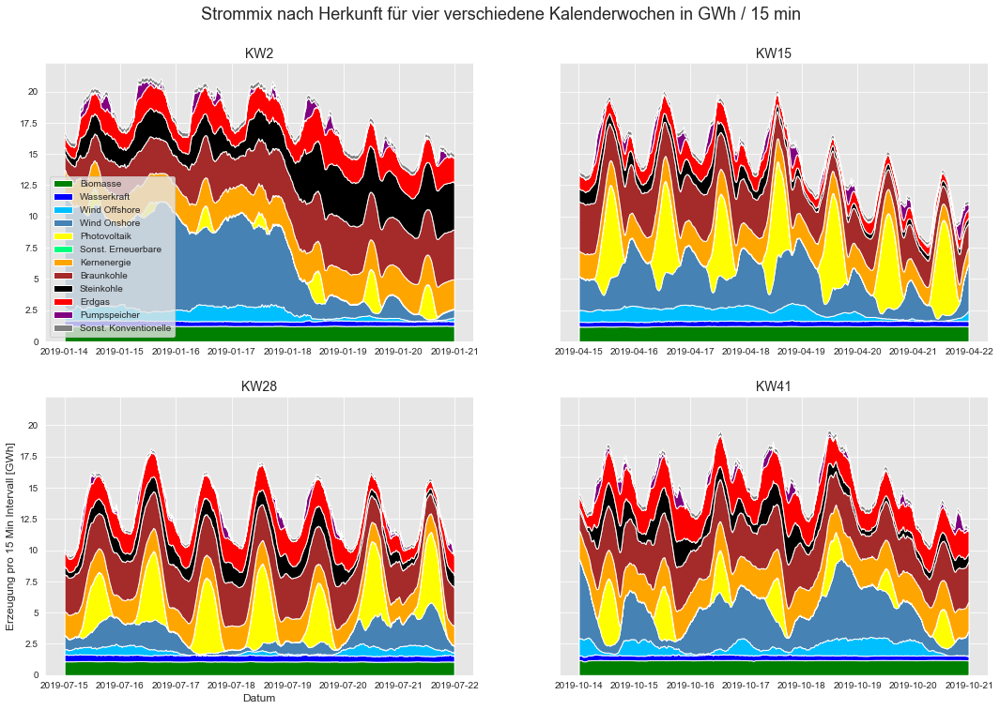

In [90]:
import matplotlib.dates as dates #needed for scaling of x-axis to months
import matplotlib.ticker as ticker # needed for ycaling of y-axis

sns.set_style("darkgrid", {"axes.facecolor": ".9"})

# transpose dataframes so the dataset is oriented correctly
t2 = weeks[2].transpose() # start with week 2 because week 1 is irregular due to Christmas holidays
t15 = weeks[15].transpose()
t28 = weeks[28].transpose()
t41 = weeks[41].transpose()

# define colors for the plot
colors = ['green', 'blue', 'deepskyblue', 'steelblue', 'yellow', 'springgreen', 'orange', 'brown', 'black', 'red', 'purple', 'grey']

# define the plot
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(nrows=2, ncols=2, sharey='all', figsize=(18,12))
ax1.stackplot(t2.columns, t2, labels=list(t2.index), colors=colors) # define plot columns, labels, colors
ax2.stackplot(t15.columns, t15, labels=list(t15.index), colors=colors)
ax3.stackplot(t28.columns, t28, labels=list(t28.index), colors=colors)
ax4.stackplot(t41.columns, t41, labels=list(t41.index), colors=colors)

#ax.set_title('Power generation by source, 15-min intervals')
ax1.set_title('KW2', fontsize = 14)
ax2.set_title('KW15', fontsize = 14)
ax3.set_title('KW28', fontsize = 14)
ax4.set_title('KW41', fontsize = 14)

ax1.legend(loc='lower left') # add legend at the top left, for one of the subplots

ax3.set_xlabel('Datum', fontsize = 12)
ax3.set_ylabel('Erzeugung pro 15 Min Intervall [GWh]', fontsize = 12)

ax1.xaxis.set_major_locator(dates.DayLocator()) # set x-ticks to days
ax2.xaxis.set_major_locator(dates.DayLocator())
ax3.xaxis.set_major_locator(dates.DayLocator())
ax4.xaxis.set_major_locator(dates.DayLocator())

# scale y-axis by factor of 1000:
scale_y = 1e3
ticks_y = ticker.FuncFormatter(lambda x, pos: '{0:g}'.format(x/scale_y))
ax1.yaxis.set_major_formatter(ticks_y)
ax2.yaxis.set_major_formatter(ticks_y)
ax3.yaxis.set_major_formatter(ticks_y)
ax4.yaxis.set_major_formatter(ticks_y)

# plot:
plt.suptitle('Strommix nach Herkunft für vier verschiedene Kalenderwochen in GWh / 15 min', y=0.95, fontsize=18)
# plt.savefig('generation_mix_four_cw.png')
plt.show()

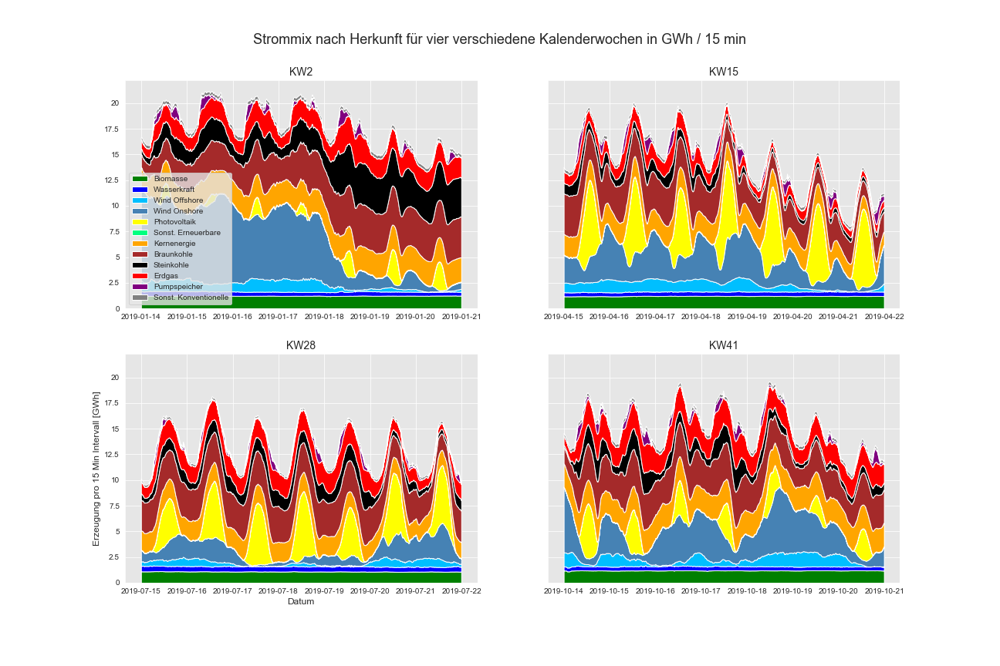

## Grid Emissions

### Stacked Area Chart

#### Stacked area plot, grid emissions in g CO2-eq./kWh

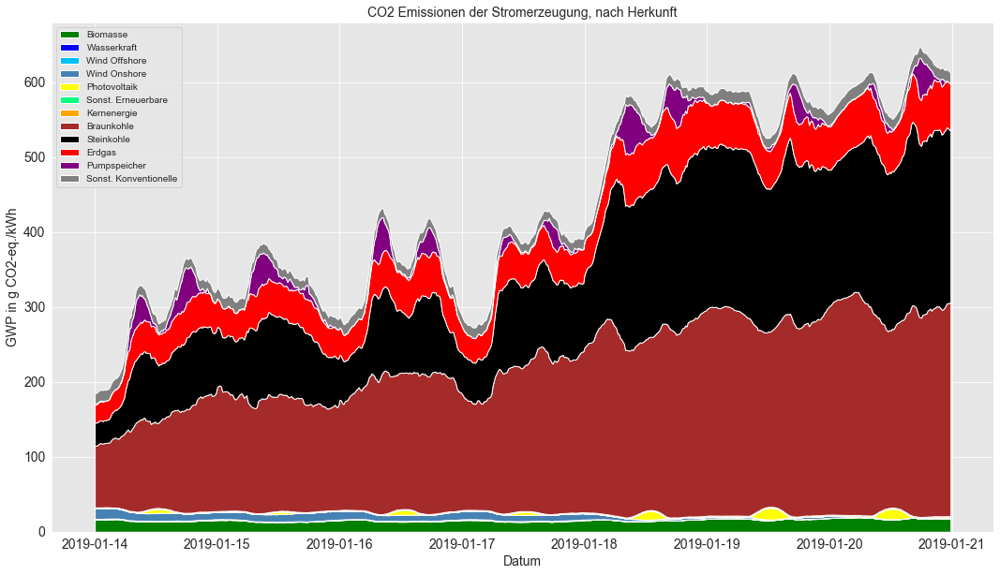

In [91]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.dates as dates #needed for scaling of x-axis to months
import matplotlib.ticker as ticker # needed for ycaling of y-axis

sns.set_style("darkgrid", {"axes.facecolor": ".9"})

# transpose dataframe so the dataset is oriented correctly
st2 = spec_weeks[2].transpose() # taking the 3rd week (index start at zero) of the df containing specific emissions

# define colors for the plot
colors = ['green', 'blue', 'deepskyblue', 'steelblue', 'yellow', 'springgreen', 'orange', 'brown', 'black', 'red', 'purple', 'grey']

# define the plot
fig, ax = plt.subplots(figsize = (18,10))
ax.stackplot(st2.columns, st2, labels=st2.index, colors=colors) # define plot columns, labels, colors
ax.set_title('CO2 Emissionen der Stromerzeugung, nach Herkunft', size=14)
ax.legend(loc='upper left') # add legend at the top left
ax.set_xlabel('Datum', size=14)
ax.set_ylabel('GWP in g CO2-eq./kWh', size=14)
ax.tick_params(axis='both', which='major', labelsize=14)
ax.xaxis.set_major_locator(dates.DayLocator()) # set x-ticks to days

# plot:
# plt.savefig('gwp_one_cw.png')
plt.show()

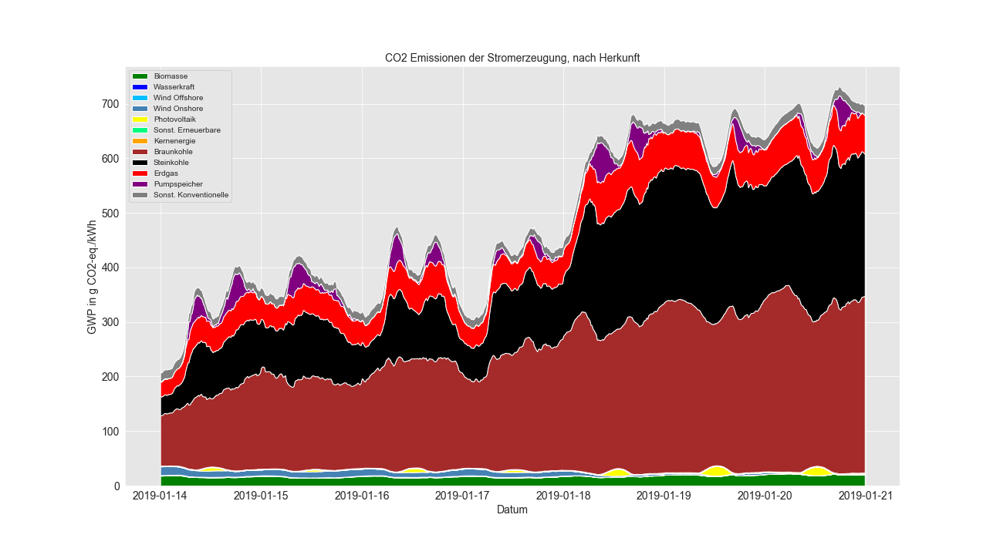

#### Stacked area plots, energy produced vs. GWP side by side

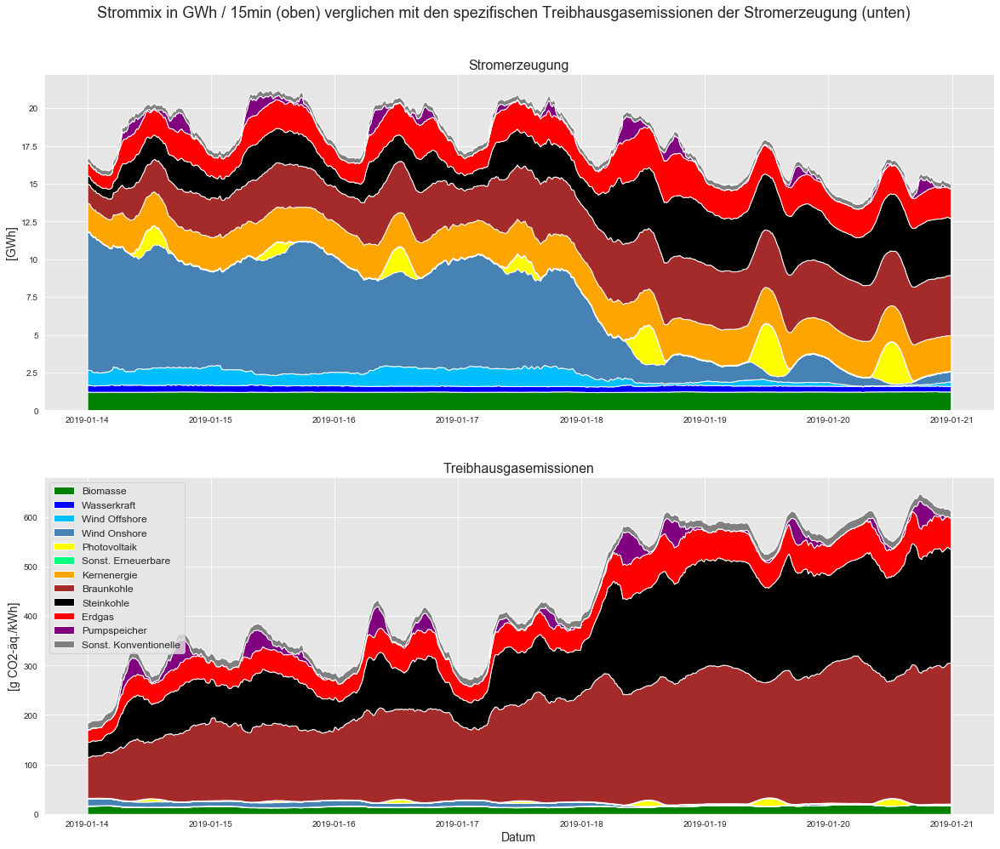

In [92]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.dates as dates #needed for scaling of x-axis to months
import matplotlib.ticker as ticker # needed for ycaling of y-axis

sns.set_style("darkgrid", {"axes.facecolor": ".9"})

# transpose dataframes so the dataset is oriented correctly
gen = weeks[2].transpose() # transpose dataframe so the dataset is oriented correctly
gwp = spec_weeks[2].transpose() # transpose dataframe so the dataset is oriented correctly

# define colors for the plot
colors = ['green', 'blue', 'deepskyblue', 'steelblue', 'yellow', 'springgreen', 'orange', 'brown', 'black', 'red', 'purple', 'grey']

# define the plot
fig, ax = plt.subplots(2, figsize = (20,16))
ax[0].stackplot(gen.columns, gen, labels=gen.index, colors=colors) # define plot columns, labels, colors
ax[1].stackplot(gwp.columns, gwp, labels=gwp.index, colors=colors) # define plot columns, labels, colors
ax[0].set_title('Stromerzeugung', fontsize = 16)
ax[1].set_title('Treibhausgasemissionen', fontsize = 16)
ax[1].legend(loc='upper left', fontsize = 12) # add legend at the top left
ax[1].set_xlabel('Datum', fontsize = 14)
ax[0].set_ylabel('[GWh]', fontsize = 14)
ax[1].set_ylabel('[g CO2-äq./kWh]', fontsize = 14)
ax[0].xaxis.set_major_locator(dates.DayLocator()) # set x-ticks to days
ax[1].xaxis.set_major_locator(dates.DayLocator()) # set x-ticks to days

# scale y-axis by factor of 1000:
scale_y = 1e3
ticks_y = ticker.FuncFormatter(lambda x, pos: '{0:g}'.format(x/scale_y))
ax[0].yaxis.set_major_formatter(ticks_y)

# plot:
plt.suptitle('Strommix in GWh / 15min (oben) verglichen mit den spezifischen Treibhausgasemissionen der Stromerzeugung (unten)', y=0.95, fontsize=18)
# plt.savefig('gen_vs_gwp_one_cw.png')
plt.show()

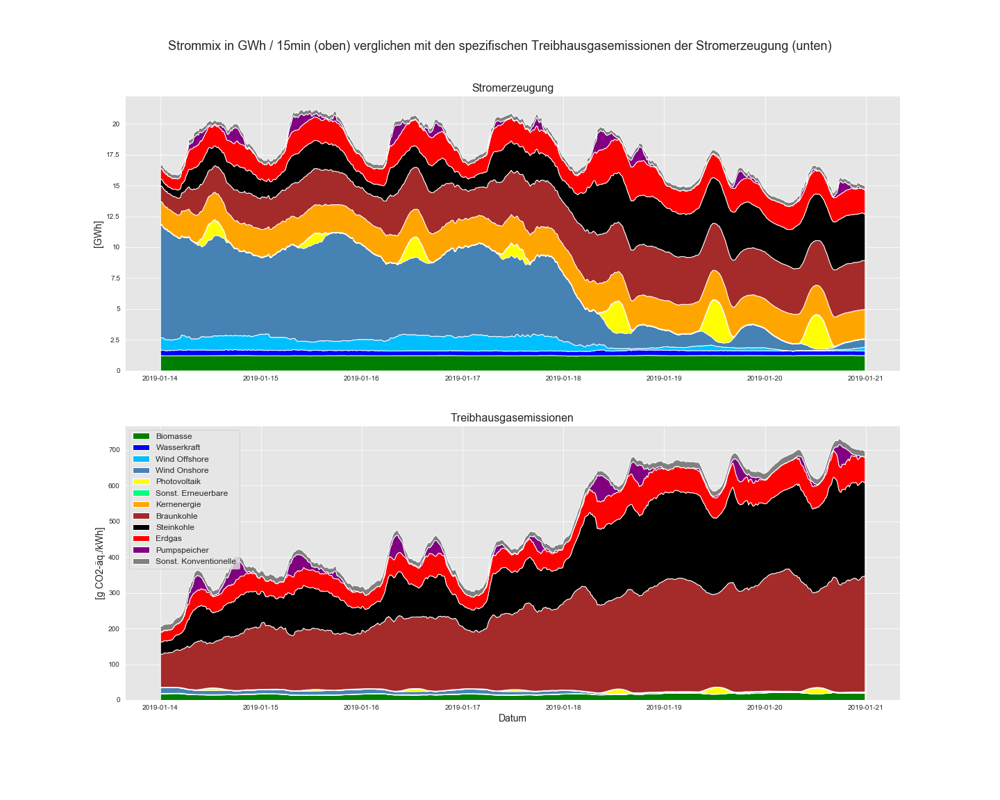

#### Stacked area plot for four different weeks, 15min intervals, CO2 emissions

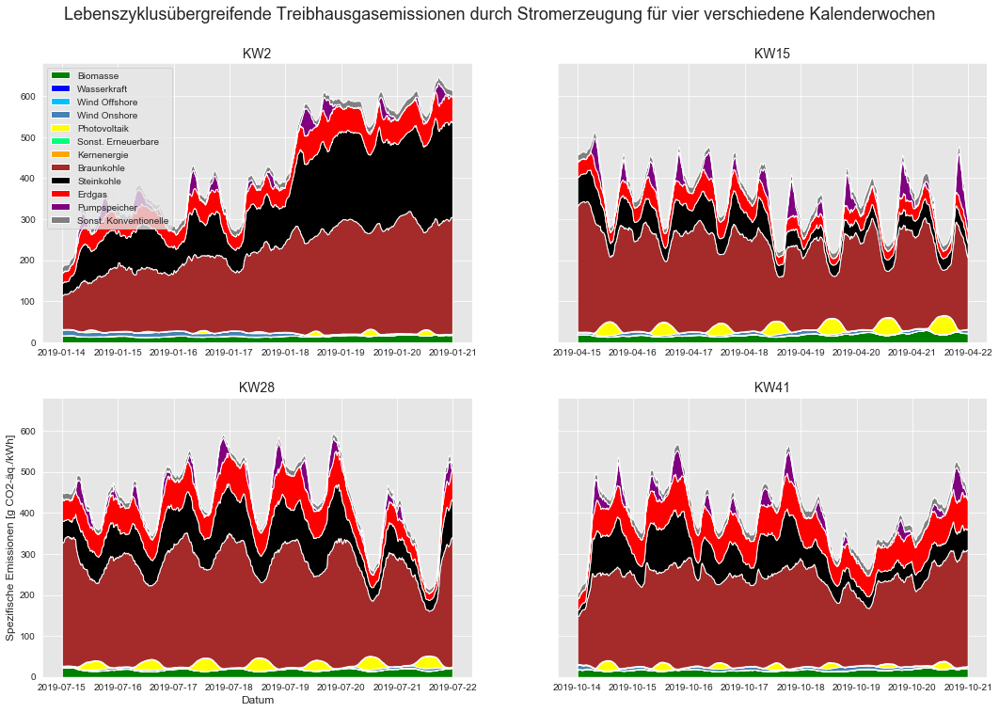

In [93]:
import matplotlib.dates as dates #needed for scaling of x-axis

sns.set_style("darkgrid", {"axes.facecolor": ".9"})

# transpose dataframes so the dataset is oriented correctly
t2 = spec_weeks[2].transpose() # start with week 2 because week 1 is irregular due to Christmas holidays
t15 = spec_weeks[15].transpose()
t28 = spec_weeks[28].transpose()
t41 = spec_weeks[41].transpose()

# define colors for the plot
colors = ['green', 'blue', 'deepskyblue', 'steelblue', 'yellow', 'springgreen', 'orange', 'brown', 'black', 'red', 'purple', 'grey']

# define the plot
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(nrows=2, ncols=2, sharey='all', figsize=(18,12))
ax1.stackplot(t2.columns, t2, labels=t2.index, colors=colors) # define plot columns, labels, colors
ax2.stackplot(t15.columns, t15, labels=t15.index, colors=colors)
ax3.stackplot(t28.columns, t28, labels=t28.index, colors=colors)
ax4.stackplot(t41.columns, t41, labels=t41.index, colors=colors)

#ax.set_title('Power generation by source, 15-min intervals')
ax1.set_title('KW2', fontsize = 14)
ax2.set_title('KW15', fontsize = 14)
ax3.set_title('KW28', fontsize = 14)
ax4.set_title('KW41', fontsize = 14)

ax1.legend(loc='upper left') # add legend at the top left, for one of the subplots

ax3.set_xlabel('Datum', fontsize = 12)
ax3.set_ylabel('Spezifische Emissionen [g CO2-äq./kWh]', fontsize = 12)

ax1.xaxis.set_major_locator(dates.DayLocator()) # set x-ticks to days
ax2.xaxis.set_major_locator(dates.DayLocator())
ax3.xaxis.set_major_locator(dates.DayLocator())
ax4.xaxis.set_major_locator(dates.DayLocator())

# plot:
plt.suptitle('Lebenszyklusübergreifende Treibhausgasemissionen durch Stromerzeugung für vier verschiedene Kalenderwochen', y=0.95, fontsize=18)
# plt.savefig('gwp_four_cw.png')
plt.show()

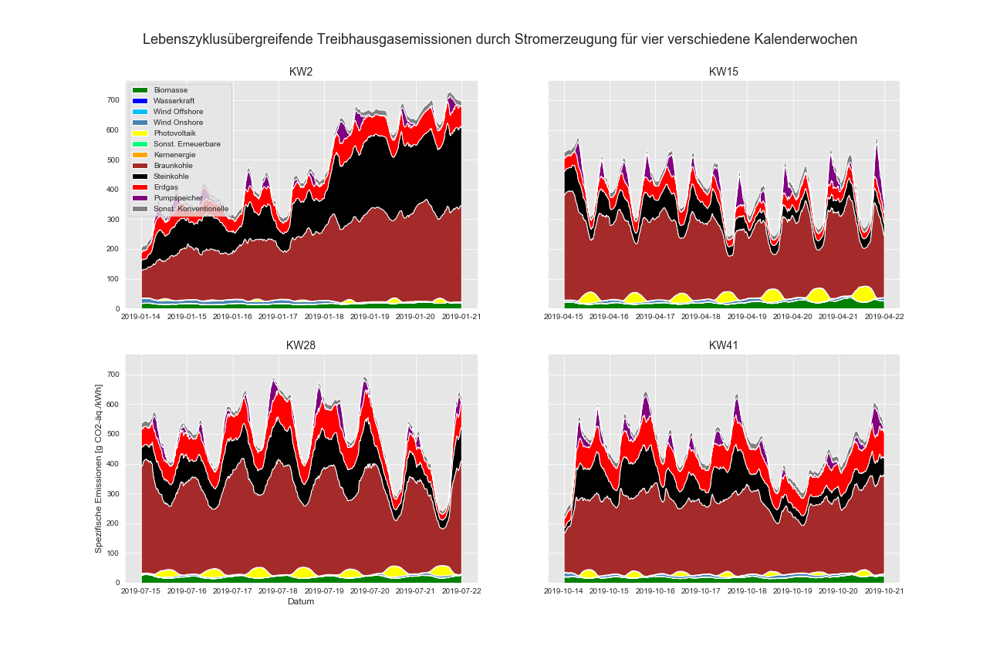

## Playing around

### Boxplots

Text(0.5, 0.9, 'Verteilung der täglich erzeugten Energiemenge pro Technologie')

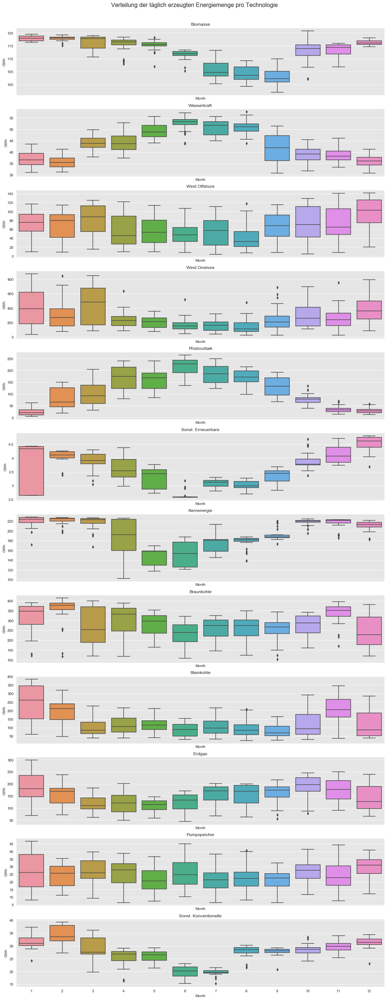

In [94]:
# box plots for montly distributions per power generation technology, based on daily sums
import matplotlib.ticker as ticker # needed for scaling of y-axis

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

df = re_daily_sum # define dataframe

# scale y-axis by factor of 1000:
scale_y = 1e3
ticks_y = ticker.FuncFormatter(lambda x, pos: '{0:g}'.format(x/scale_y))

fig, axes = plt.subplots(12, 1, figsize=(18, 48), sharex=True)
for name, ax in zip(data_columns, axes):
    sns.boxplot(data=df, x='Month', y=name, ax=ax)
    ax.set_ylabel('GWh') # data entries are in MWh, but y-axis is scaled by 1000
    ax.set_title(name)
    ax.yaxis.set_major_formatter(ticks_y)
# Remove the automatic x-axis label from all but the bottom subplot
if ax != axes[-1]:
    ax.set_xlabel('')
       
plt.suptitle('Verteilung der täglich erzeugten Energiemenge pro Technologie', y=0.9, fontsize=16)
# plt.savefig('monthly_distribution_generation_per_technology')

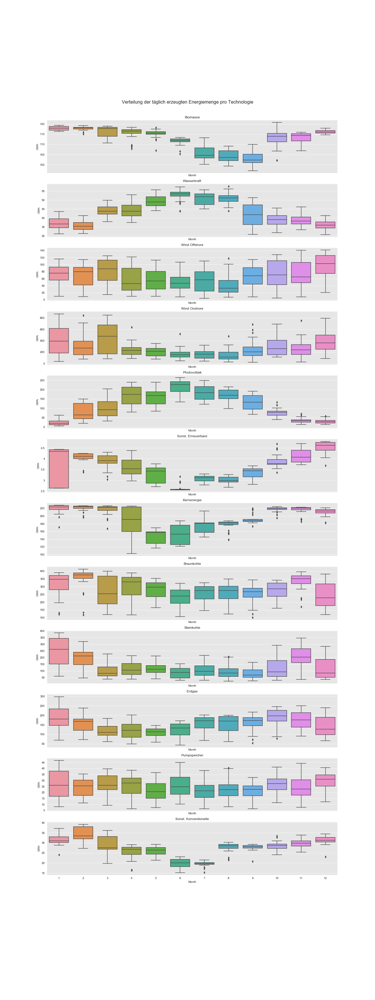

Text(0.5, 0.9, 'Verteilung der täglich erzeugten Energiemenge pro Technologie, normalisiert')

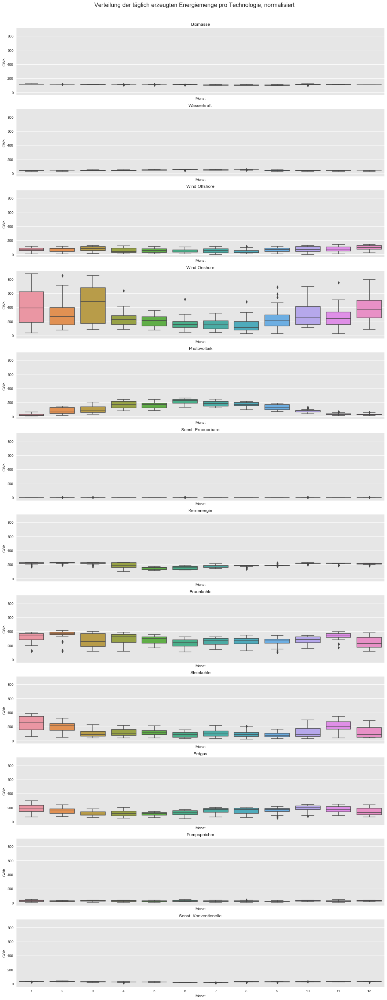

In [95]:
# box plots for montly distributions per power generation technology, based on daily sums, normalized
import matplotlib.ticker as ticker # needed for scaling of y-axis

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

df = re_daily_sum # define dataframe

# scale y-axis by factor of 1000:
scale_y = 1e3
ticks_y = ticker.FuncFormatter(lambda x, pos: '{0:g}'.format(x/scale_y))

fig, axes = plt.subplots(12, 1, figsize=(18, 48), sharex=True, sharey=True)
for name, ax in zip(data_columns, axes):
    sns.boxplot(data=df, x='Month', y=name, ax=ax)
    ax.set_xlabel('Monat')
    ax.set_ylabel('GWh') # data entries are in MWh, but y-axis is scaled by 1000
    ax.set_title(name)
    ax.yaxis.set_major_formatter(ticks_y)
# Remove the automatic x-axis label from all but the bottom subplot
if ax != axes[-1]:
    ax.set_xlabel('')
       
plt.suptitle('Verteilung der täglich erzeugten Energiemenge pro Technologie, normalisiert', y=0.9, fontsize=16)
# plt.savefig('monthly_distribution_generation_per_technology_normalized')

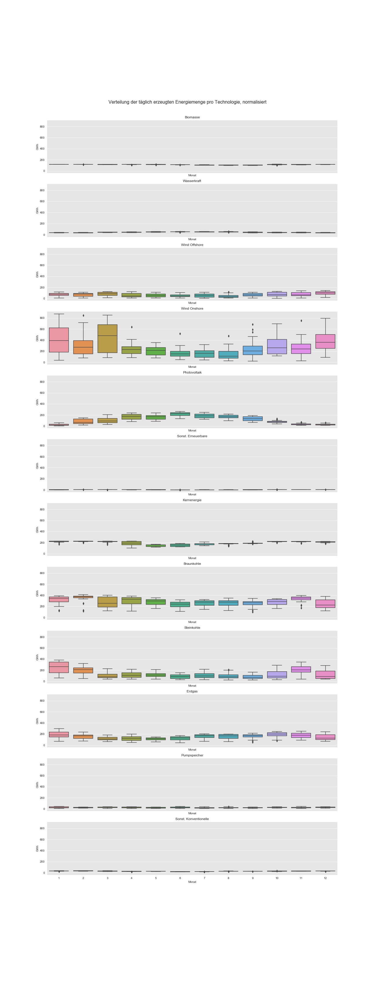

In [96]:
re_row_sum_d_sum['Gesamterzeugung'].sample(5)

Datetime
2019-07-09    1306952.0
2019-04-20    1154170.0
2019-11-29    1697541.0
2019-06-19    1367229.5
2019-07-16    1399819.0
Name: Gesamterzeugung, dtype: float64

Text(0.5, 0.98, 'Streubreite der täglichen Gesamterzeugung in GWh, nach Wochentag')

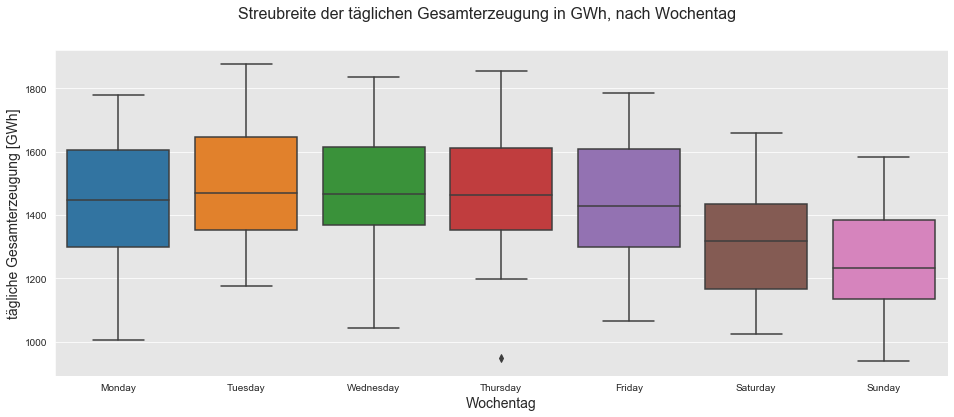

In [112]:
# boxplot for total generation per 15-min interval, for different weekdays
sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

order = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]

plt.figure(figsize=(16, 6))

# scale y-axis by factor of 1000:
scale_y = 1e3
ticks_y = ticker.FuncFormatter(lambda x, pos: '{0:g}'.format(x/scale_y))

ax = sns.boxplot(data=re_row_sum_d_sum,
                 x='Weekday Name',
                 y='Gesamterzeugung',
                 order=order)
ax.set_ylabel('tägliche Gesamterzeugung [GWh]', fontsize = 14)
ax.set_xlabel('Wochentag', fontsize = 14)
ax.yaxis.set_major_formatter(ticks_y)

plt.suptitle('Streubreite der täglichen Gesamterzeugung in GWh, nach Wochentag', fontsize=16)
#plt.savefig('generation_boxplot_spread_per_weekday')

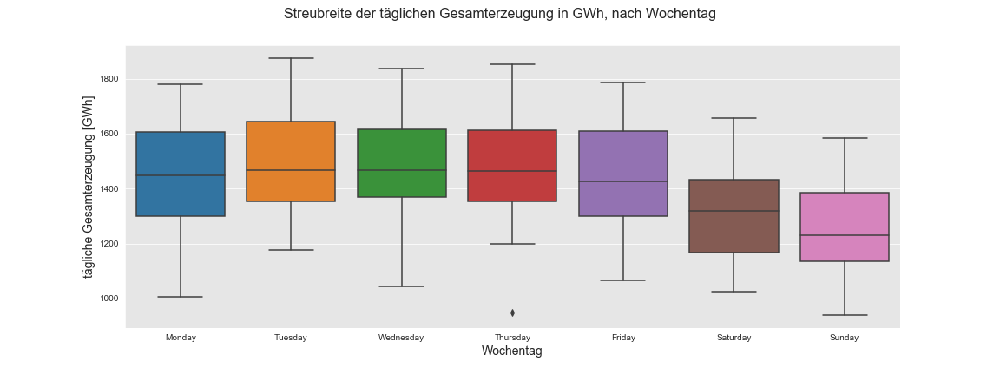

### Compare temporal aggregation levels

Text(0.5, 1.0, 'Stromerzeugung durch Biomasse pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel')

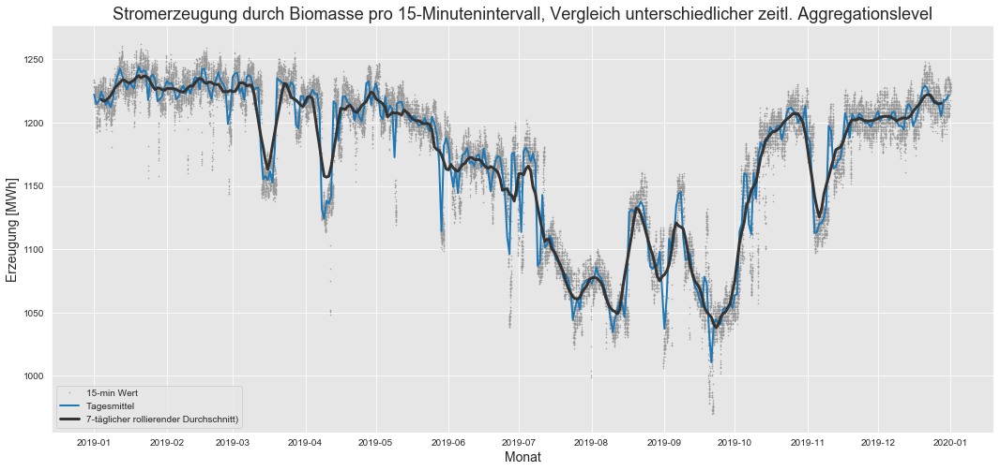

In [98]:
# Plot 15-min, daily and 7-day rolling mean time series for power generation
sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

fig, ax = plt.subplots(figsize=(18, 8))
ax.plot(re['Biomasse'], marker='.', markersize=1, color='0.6',
linestyle='None', label='15-min Wert')
ax.plot(re_daily_mean['Biomasse'], linewidth=2, label='Tagesmittel')
ax.plot(re_roll_7d['Biomasse'], color='0.2', linewidth=3,
label='7-täglicher rollierender Durchschnitt)')

# Set x-ticks to yearly interval and add legend and labels
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.legend()
ax.set_xlabel('Monat', fontsize=14)
ax.set_ylabel('Erzeugung [MWh]', fontsize=14)
ax.set_title('Stromerzeugung durch Biomasse pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel', fontsize=18)

# plt.savefig('biomass_timescales')

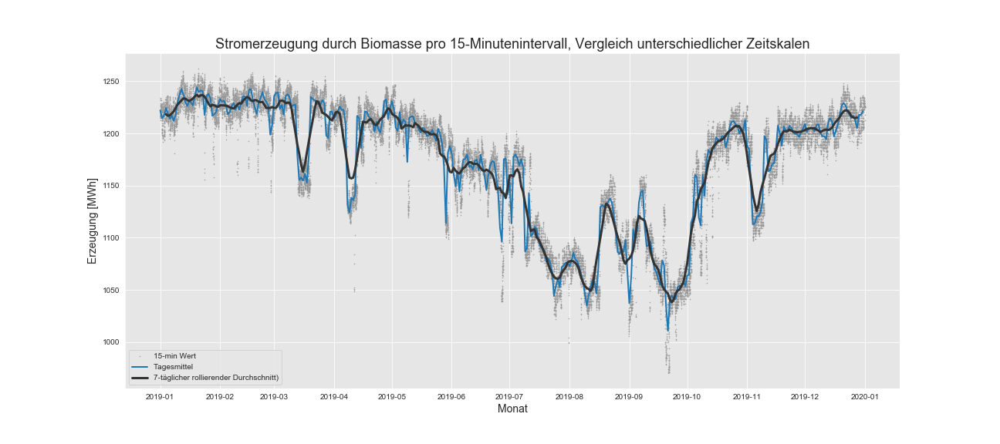

Text(0.5, 1.0, 'Stromerzeugung durch Wasserkraft pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel')

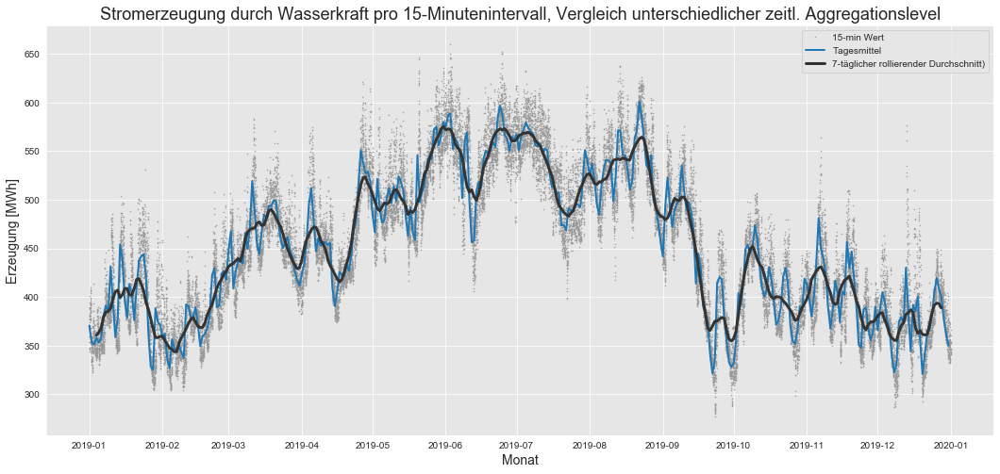

In [99]:
# Plot 15-min, daily and 7-day rolling mean time series

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

fig, ax = plt.subplots(figsize=(18, 8))
ax.plot(re['Wasserkraft'], marker='.', markersize=1, color='0.6',
linestyle='None', label='15-min Wert')
ax.plot(re_daily_mean['Wasserkraft'], linewidth=2, label='Tagesmittel')
ax.plot(re_roll_7d['Wasserkraft'], color='0.2', linewidth=3,
label='7-täglicher rollierender Durchschnitt)')

# Set x-ticks to yearly interval and add legend and labels
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.legend()
ax.set_xlabel('Monat', fontsize=14)
ax.set_ylabel('Erzeugung [MWh]', fontsize=14)
ax.set_title('Stromerzeugung durch Wasserkraft pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel', fontsize=18)

# plt.savefig('hydro_timescales')

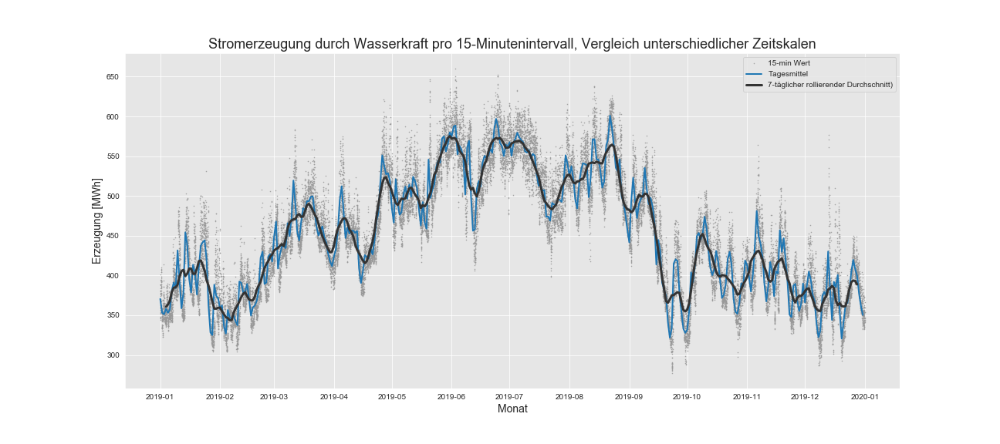

Text(0.5, 1.0, 'Stromerzeugung durch Wind (Offshore) pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel')

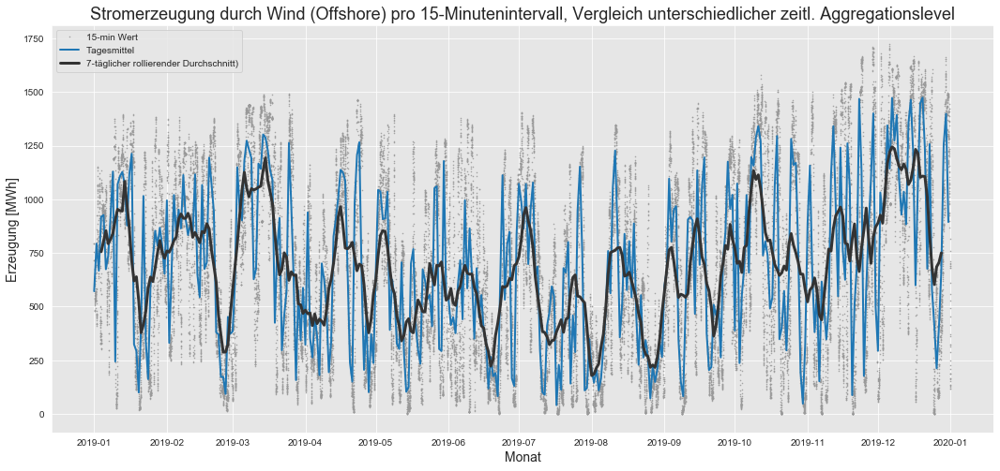

In [100]:
# Plot 15-min, daily and 7-day rolling mean time series

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

fig, ax = plt.subplots(figsize=(18, 8))
ax.plot(re['Wind Offshore'], marker='.', markersize=1, color='0.6',
linestyle='None', label='15-min Wert')
ax.plot(re_daily_mean['Wind Offshore'], linewidth=2, label='Tagesmittel')
ax.plot(re_roll_7d['Wind Offshore'], color='0.2', linewidth=3,
label='7-täglicher rollierender Durchschnitt)')

# Set x-ticks to yearly interval and add legend and labels
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.legend()
ax.set_xlabel('Monat', fontsize=14)
ax.set_ylabel('Erzeugung [MWh]', fontsize=14)
ax.set_title('Stromerzeugung durch Wind (Offshore) pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel', fontsize=18)

# plt.savefig('offshore_timescales')

Text(0.5, 1.0, 'Stromerzeugung durch Wind (Onshore) pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel')

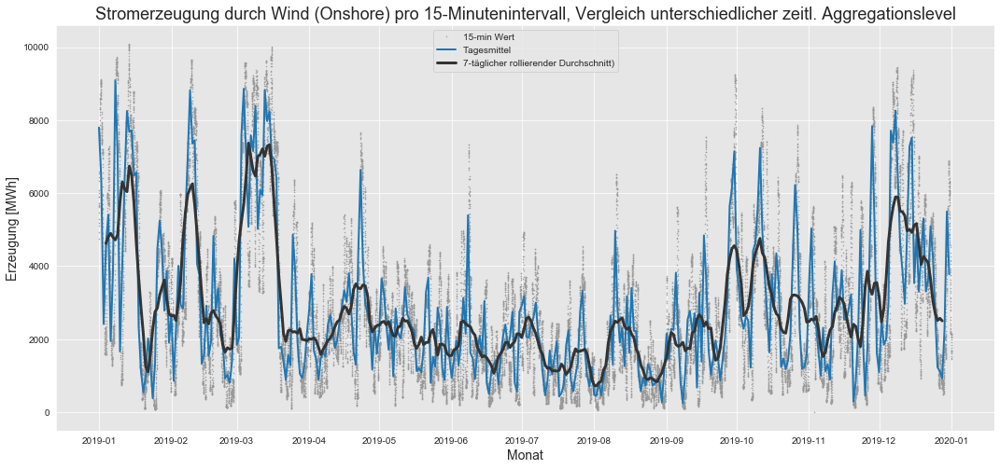

In [101]:
# Plot 15-min, daily and 7-day rolling mean time series

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

fig, ax = plt.subplots(figsize=(18, 8))
ax.plot(re['Wind Onshore'], marker='.', markersize=1, color='0.6',
linestyle='None', label='15-min Wert')
ax.plot(re_daily_mean['Wind Onshore'], linewidth=2, label='Tagesmittel')
ax.plot(re_roll_7d['Wind Onshore'], color='0.2', linewidth=3,
label='7-täglicher rollierender Durchschnitt)')

# Set x-ticks to yearly interval and add legend and labels
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.legend()
ax.set_xlabel('Monat', fontsize=14)
ax.set_ylabel('Erzeugung [MWh]', fontsize=14)
ax.set_title('Stromerzeugung durch Wind (Onshore) pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel', fontsize=18)

# plt.savefig('onshore_timescales')

Text(0.5, 1.0, 'Stromerzeugung durch Photovoltaik pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel')

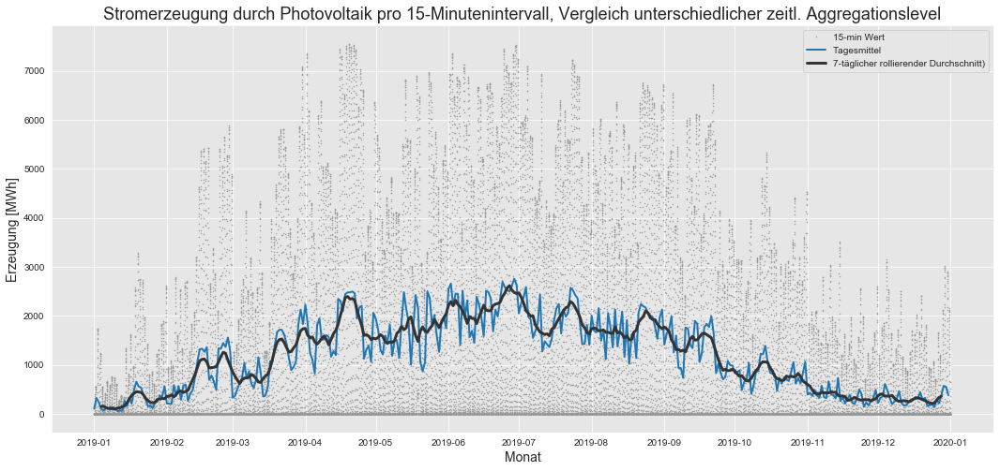

In [102]:
# Plot 15-min, daily and 7-day rolling mean time series

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

fig, ax = plt.subplots(figsize=(18, 8))
ax.plot(re['Photovoltaik'], marker='.', markersize=1, color='0.6',
linestyle='None', label='15-min Wert')
ax.plot(re_daily_mean['Photovoltaik'], linewidth=2, label='Tagesmittel')
ax.plot(re_roll_7d['Photovoltaik'], color='0.2', linewidth=3,
label='7-täglicher rollierender Durchschnitt)')

# Set x-ticks to yearly interval and add legend and labels
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.legend()
ax.set_xlabel('Monat', fontsize=14)
ax.set_ylabel('Erzeugung [MWh]', fontsize=14)
ax.set_title('Stromerzeugung durch Photovoltaik pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel', fontsize=18)

# plt.savefig('PV_timescales')

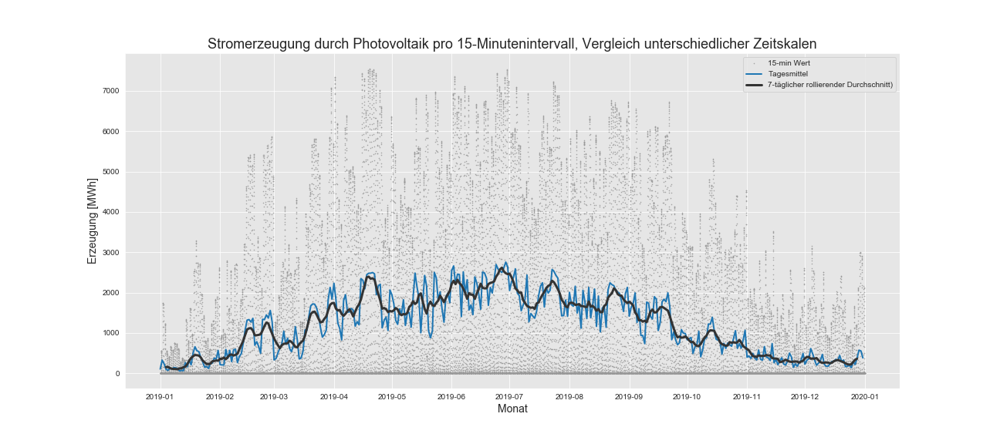

Text(0.5, 1.0, 'Stromerzeugung durch sonst. Erneuerbare pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel')

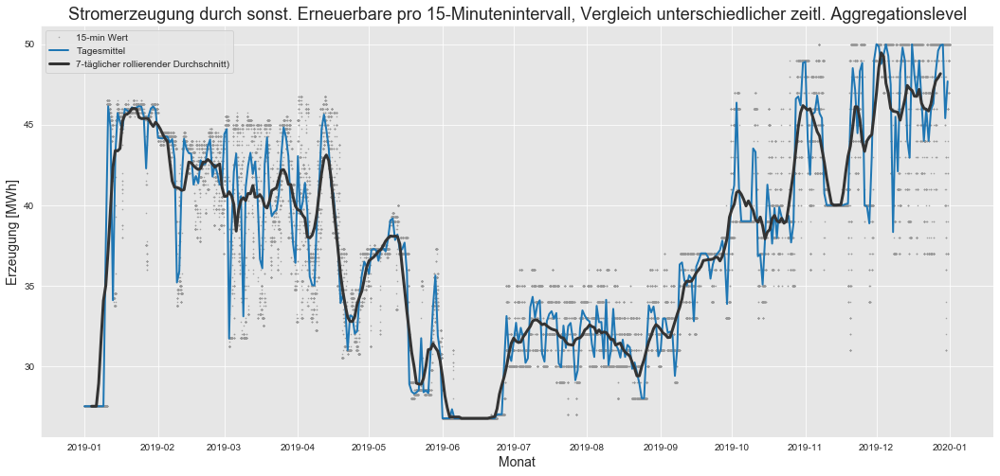

In [103]:
# Plot 15-min, daily and 7-day rolling mean time series

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

fig, ax = plt.subplots(figsize=(18, 8))
ax.plot(re['Sonst. Erneuerbare'], marker='.', markersize=1, color='0.6',
linestyle='None', label='15-min Wert')
ax.plot(re_daily_mean['Sonst. Erneuerbare'], linewidth=2, label='Tagesmittel')
ax.plot(re_roll_7d['Sonst. Erneuerbare'], color='0.2', linewidth=3,
label='7-täglicher rollierender Durchschnitt)')

# Set x-ticks to yearly interval and add legend and labels
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.legend()
ax.set_xlabel('Monat', fontsize=14)
ax.set_ylabel('Erzeugung [MWh]', fontsize=14)
ax.set_title('Stromerzeugung durch sonst. Erneuerbare pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel', fontsize=18)

# plt.savefig('waste_timescales')

Text(0.5, 1.0, 'Stromerzeugung durch Kernenergie pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel')

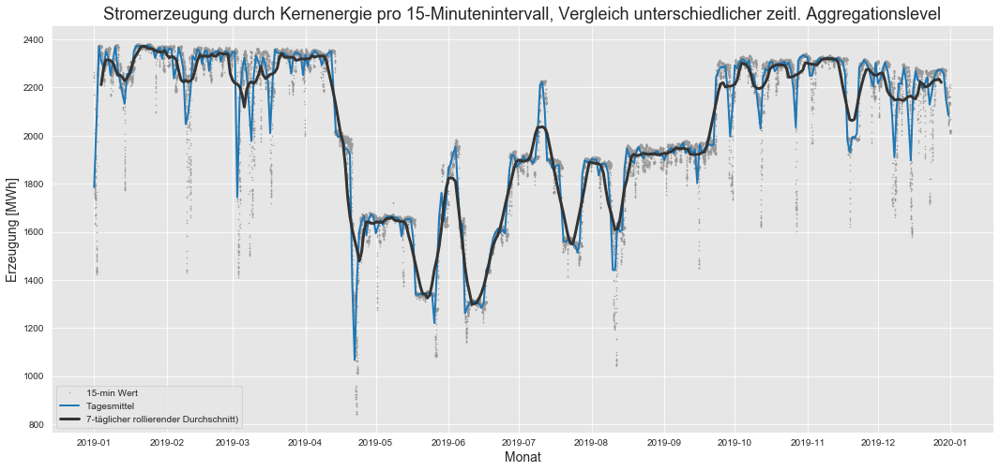

In [104]:
# Plot 15-min, daily and 7-day rolling mean time series

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

fig, ax = plt.subplots(figsize=(18, 8))
ax.plot(re['Kernenergie'], marker='.', markersize=1, color='0.6',
linestyle='None', label='15-min Wert')
ax.plot(re_daily_mean['Kernenergie'], linewidth=2, label='Tagesmittel')
ax.plot(re_roll_7d['Kernenergie'], color='0.2', linewidth=3,
label='7-täglicher rollierender Durchschnitt)')

# Set x-ticks to yearly interval and add legend and labels
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.legend()
ax.set_xlabel('Monat', fontsize=14)
ax.set_ylabel('Erzeugung [MWh]', fontsize=14)
ax.set_title('Stromerzeugung durch Kernenergie pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel', fontsize=18)

# plt.savefig('nuclear_timescales')

Text(0.5, 1.0, 'Stromerzeugung durch Braunkohle pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel')

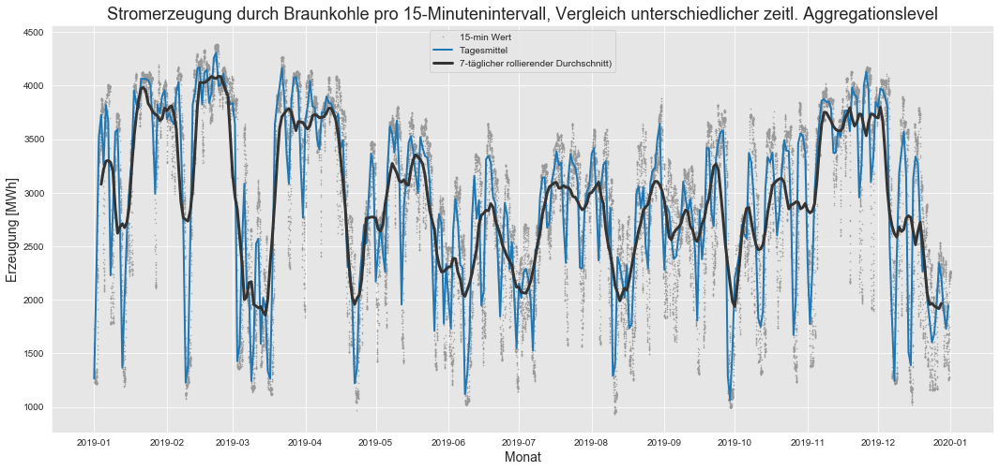

In [105]:
# Plot 15-min, daily and 7-day rolling mean time series

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

fig, ax = plt.subplots(figsize=(18, 8))
ax.plot(re['Braunkohle'], marker='.', markersize=1, color='0.6',
linestyle='None', label='15-min Wert')
ax.plot(re_daily_mean['Braunkohle'], linewidth=2, label='Tagesmittel')
ax.plot(re_roll_7d['Braunkohle'], color='0.2', linewidth=3,
label='7-täglicher rollierender Durchschnitt)')

# Set x-ticks to yearly interval and add legend and labels
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.legend()
ax.set_xlabel('Monat', fontsize=14)
ax.set_ylabel('Erzeugung [MWh]', fontsize=14)
ax.set_title('Stromerzeugung durch Braunkohle pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel', fontsize=18)

# plt.savefig('lignite_timescales')

Text(0.5, 1.0, 'Stromerzeugung durch Steinkohle pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel')

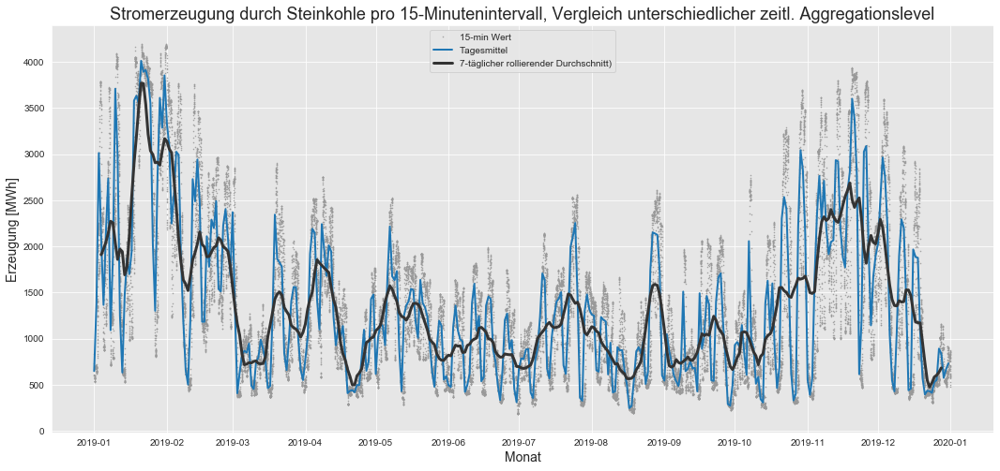

In [106]:
# Plot 15-min, daily and 7-day rolling mean time series

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

fig, ax = plt.subplots(figsize=(18, 8))
ax.plot(re['Steinkohle'], marker='.', markersize=1, color='0.6',
linestyle='None', label='15-min Wert')
ax.plot(re_daily_mean['Steinkohle'], linewidth=2, label='Tagesmittel')
ax.plot(re_roll_7d['Steinkohle'], color='0.2', linewidth=3,
label='7-täglicher rollierender Durchschnitt)')

# Set x-ticks to yearly interval and add legend and labels
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.legend()
ax.set_xlabel('Monat', fontsize=14)
ax.set_ylabel('Erzeugung [MWh]', fontsize=14)
ax.set_title('Stromerzeugung durch Steinkohle pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel', fontsize=18)

# plt.savefig('hard_coal_timescales')

Text(0.5, 1.0, 'Stromerzeugung durch Erdgas pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel')

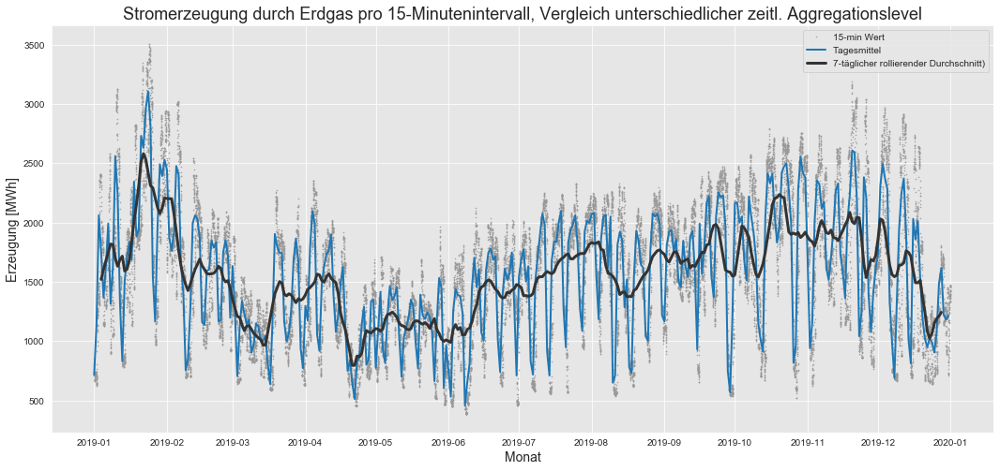

In [107]:
# Plot 15-min, daily and 7-day rolling mean time series

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

fig, ax = plt.subplots(figsize=(18, 8))
ax.plot(re['Erdgas'], marker='.', markersize=1, color='0.6',
linestyle='None', label='15-min Wert')
ax.plot(re_daily_mean['Erdgas'], linewidth=2, label='Tagesmittel')
ax.plot(re_roll_7d['Erdgas'], color='0.2', linewidth=3,
label='7-täglicher rollierender Durchschnitt)')

# Set x-ticks to yearly interval and add legend and labels
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.legend()
ax.set_xlabel('Monat', fontsize=14)
ax.set_ylabel('Erzeugung [MWh]', fontsize=14)
ax.set_title('Stromerzeugung durch Erdgas pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel', fontsize=18)

# plt.savefig('gas_timescales')

Text(0.5, 1.0, 'Stromerzeugung durch Pumpspeicher pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel')

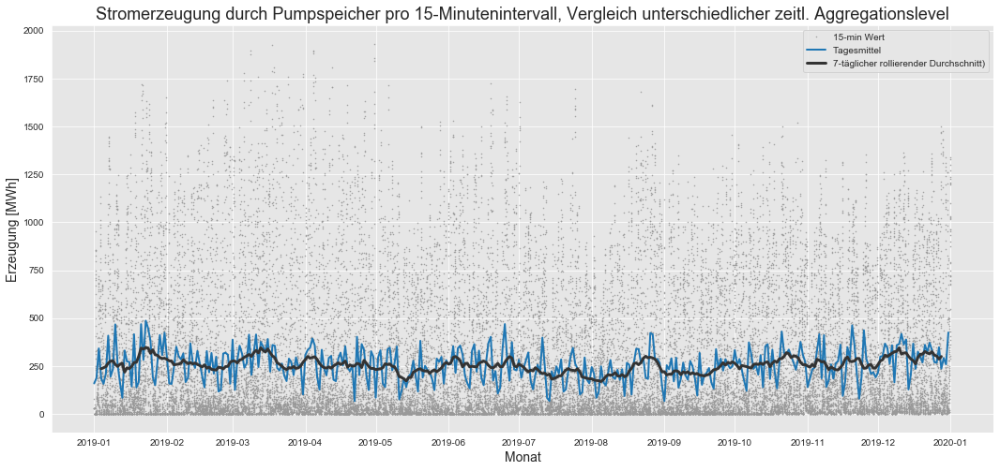

In [108]:
# Plot 15-min, daily and 7-day rolling mean time series

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

fig, ax = plt.subplots(figsize=(18, 8))
ax.plot(re['Pumpspeicher'], marker='.', markersize=1, color='0.6',
linestyle='None', label='15-min Wert')
ax.plot(re_daily_mean['Pumpspeicher'], linewidth=2, label='Tagesmittel')
ax.plot(re_roll_7d['Pumpspeicher'], color='0.2', linewidth=3,
label='7-täglicher rollierender Durchschnitt)')

# Set x-ticks to yearly interval and add legend and labels
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.legend()
ax.set_xlabel('Monat', fontsize=14)
ax.set_ylabel('Erzeugung [MWh]', fontsize=14)
ax.set_title('Stromerzeugung durch Pumpspeicher pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel', fontsize=18)

# plt.savefig('pumped_timescales')

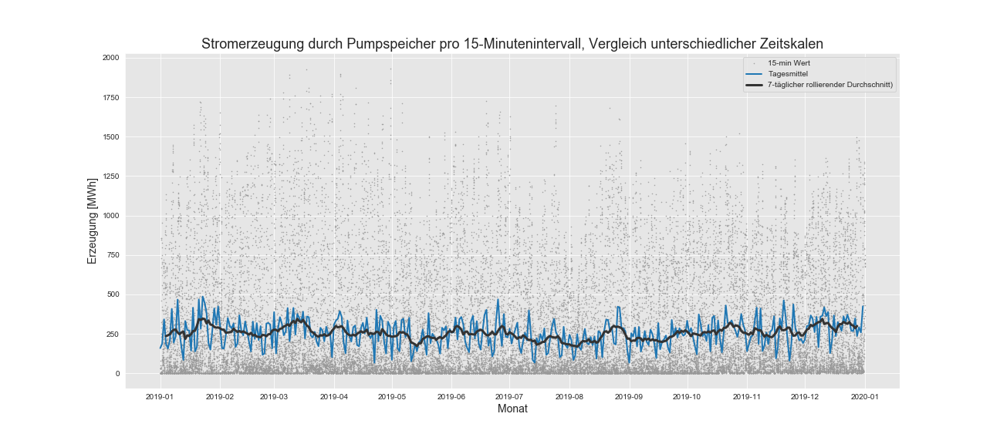

Text(0.5, 1.0, 'Stromerzeugung durch sonst. Konventionelle pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel')

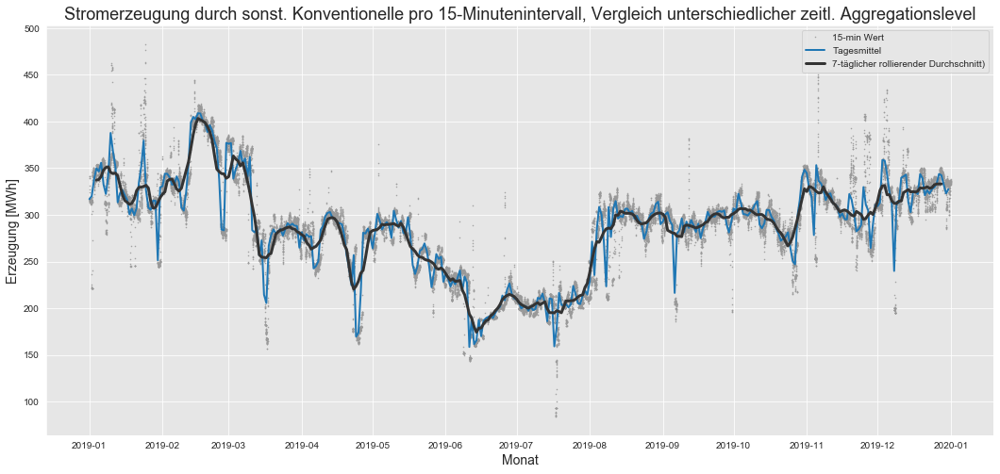

In [109]:
# Plot 15-min, daily and 7-day rolling mean time series

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

fig, ax = plt.subplots(figsize=(18, 8))
ax.plot(re['Sonst. Konventionelle'], marker='.', markersize=1, color='0.6',
linestyle='None', label='15-min Wert')
ax.plot(re_daily_mean['Sonst. Konventionelle'], linewidth=2, label='Tagesmittel')
ax.plot(re_roll_7d['Sonst. Konventionelle'], color='0.2', linewidth=3,
label='7-täglicher rollierender Durchschnitt)')

# Set x-ticks to yearly interval and add legend and labels
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.legend()
ax.set_xlabel('Monat', fontsize=14)
ax.set_ylabel('Erzeugung [MWh]', fontsize=14)
ax.set_title('Stromerzeugung durch sonst. Konventionelle pro 15-Minutenintervall, Vergleich unterschiedlicher zeitl. Aggregationslevel', fontsize=18)

# plt.savefig('oil_timescales')

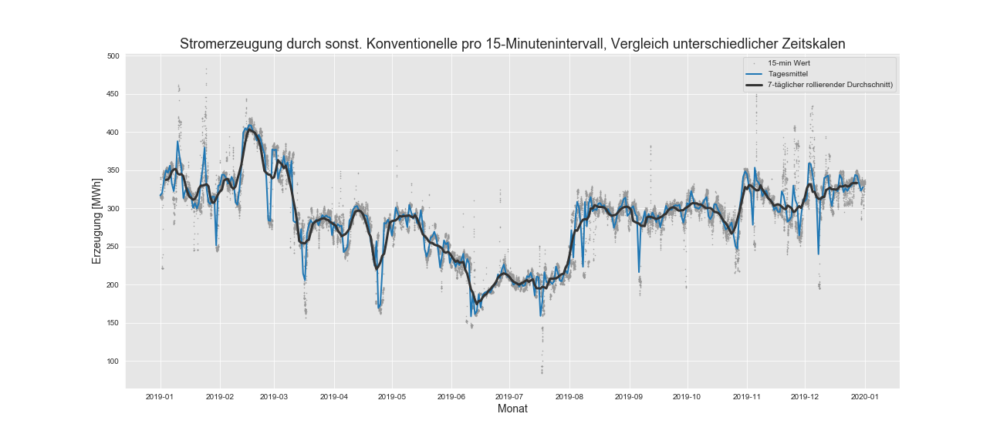

### Lineplot

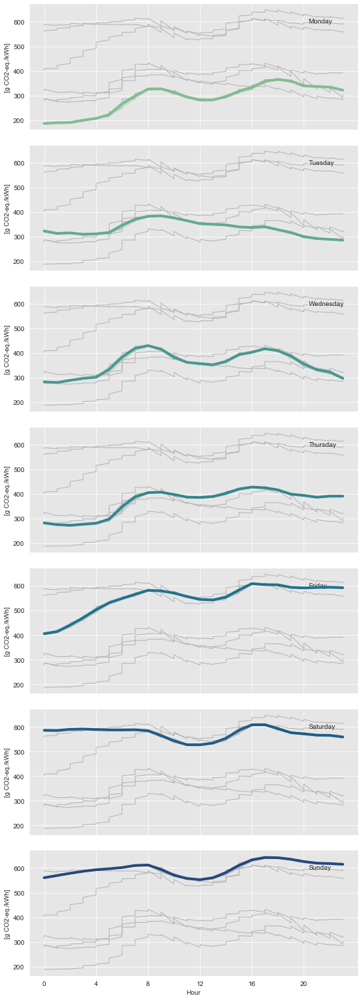

In [113]:
import seaborn as sns

sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

# some data preparation
data = ss_weeks[2]

# Plot each year's time series in its own facet
g = sns.relplot(
    data=data,
    x="Hour", y="grid emissions", col="Weekday Name", hue="Weekday Name",
    kind="line", palette="crest", linewidth=4, zorder=5,
    col_wrap=1, height=3, aspect=2.5, legend=False,
)

# Iterate over each subplot to customize further
for i, ax in g.axes_dict.items():

    # Add the title as an annotation within the plot
    ax.text(.85, .85, i, transform=ax.transAxes)

    # Plot every year's time series in the background
    sns.lineplot(
        data=data, x="Hour", y="grid emissions", units="Weekday Name", color=".7", linewidth=1, ax=ax, estimator=None,
    )

# Tweak the supporting aspects of the plot
g.set_titles("")
g.set(xticks=[0,4,8,12,16,20])
g.set_axis_labels("Hour", "[g CO2-eq./kWh]")
plt.savefig('weekly_traces')

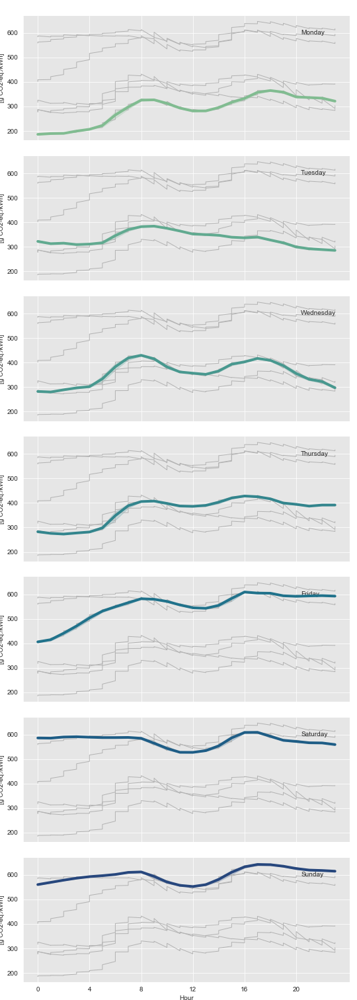

### Line Plot with error band

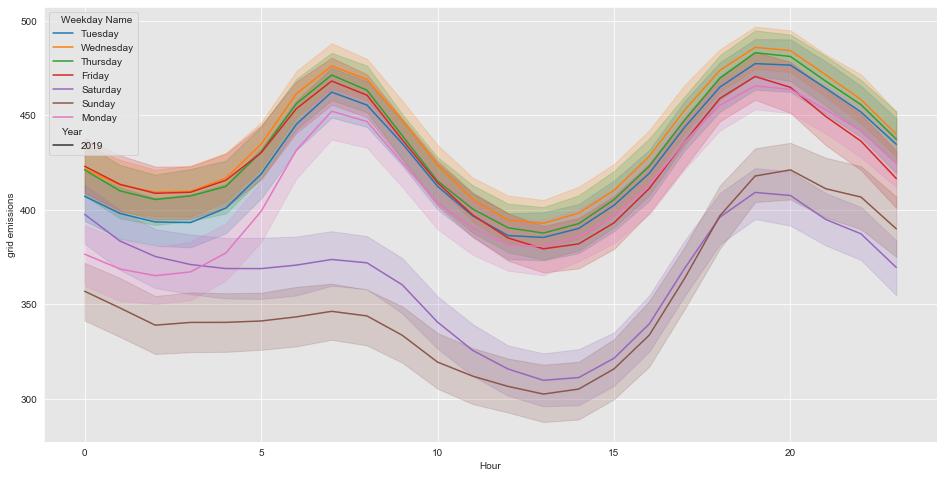

In [111]:
import seaborn as sns
sns.set_style("darkgrid", {"axes.facecolor": ".9"}) # uniform seaborn style

plt.figure(figsize=(16, 8))

data = spec_sum

order = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]

# Plot the responses for different events and regions
sns.lineplot(x="Hour", y="grid emissions",
             hue="Weekday Name", style="Year",
             data=data)

#plt.savefig('ef_typical_day_week_error_band.png')

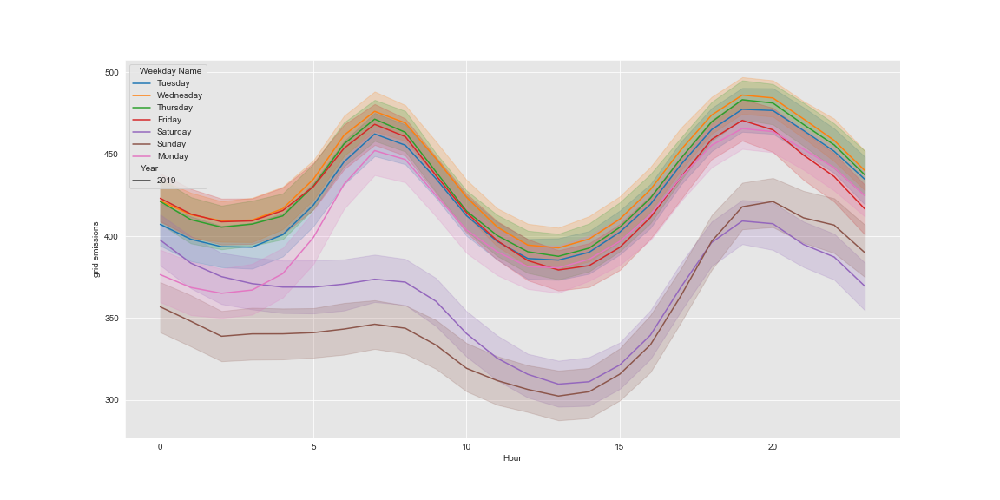

# Next steps
- more chart types
- interactive charts (plotly express, go.Figure, Dash...)
- other data inputs from SMARD (energy imp-/exports, energy demand, economic data...)
- marginal instead of average mix
- & much more

# Code? --> TU BS Gitlab
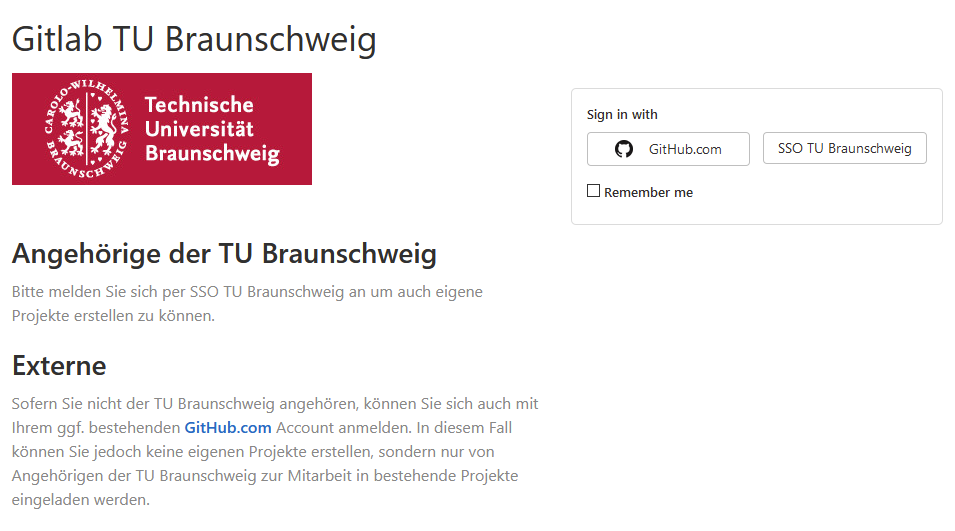